In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import math
import pandas as pd
#import uproot
import uproot3
from scipy import optimize as op
import scipy.integrate as integrate

In [2]:
#Gain access to functions used to change some of the aspects regarding arrays and the things in them
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Bin\ Conversions.ipynb

#Gain Access to functions used to work with momentum binning
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Momentum\ Bins.ipynb

#Gain Access to functions used to work with Fitting Functions
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Fitting\ Functions.ipynb

#Gain Access to functions used for TH2s 
#uproot or uproo4
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH2\ Functions-uproot3.ipynb
#uproot3
#%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/TH1\ Functions-uproot3.ipynb

#Gain Access to functions for taking discrete derivatives of lists of data
%run /Users/cmc/analysis_phd/analysis_twopi_clas6/cut_determinations/e16/Derivatives.ipynb

*Bin Conversions*
Available Functions:
Note: All functions return new arrays rather than altering the previous array
	New_Merged_Size(array_,merge_size_) returns what the size of the new merged array will be
	Merge_Bin_Edges(edges_,merge_size) merges the bin edges 
	Merge_Bins(array_,merge_size_) adds together every <merge_size_> values in an array
	Merge_Vals(yarray_,merge_size_) adds together every <merge_size_> ybin together in an array
	Merge_Bins(xarray_,merge_size_) averages every <merge_size_> xbins together in an array
	Count_Non_Zero(array_) counts the number of nonzero values in an array
	Count_Zero(array_) counts the number of zeros in an array
	Remove_Zeros(array_) remove zeros from an array
	Remove_Zeros_Y(yarray_) removes zero values from yarray
	Remove_Zeros_X(xarray_,yarray_) removes xbins where the corresponding y value was zero
	Count_InBounds(yarray_,low_,high_) counts the number of values that fall between bounds (or equal to)
	Count_OutBounds(yarray_,low_,high_) co

In [3]:
#date="05-15-2024"
#dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_e16/"+date
#dir="/Users/cmc/analysis_phd/root_files/cut_determination/cut_det_e16/"+date+"/cc"
dir="/Users/cmc/analysis_phd/root_files/local_runs/e16/target"
root_file=dir+"/analysis_full_e16_geo_fid.root"
#root_file=dir+"/exp_e16_clas6_fid_geo_"+date+".root"
file=uproot3.open(root_file)

species="ele"
detector="sc"
cut="pid"

sector_names = ["sec1","sec2","sec3","sec4","sec5","sec6","all"]
side = ["left","coinc","right","All"]
num_cc_seg = 18
num_cc_side = 3
num_sc_pad = 48
#0-> pid | 1->event selection all 

color_order = ['b','g','r']
rv_color_order = ['r','g','b']
cut_name = ['tight','mid','loose']
rv_cut_name = ['loose','mid','tight']

right_rot = [3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2)]
left_rot = [3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2),3**(1/2)]

In [4]:
layer1="Geometric Distributions"
layer2="Geo Fid "+species
layer3=layer2+" "+detector
layer4=[layer3+" "+sector_names[sec] for sec in range(7)]
layer5=[layer4[sec]+" "+cut for sec in range(7)]

    

In [5]:
hist_idx_len = len(file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[0]+"/"+layer5[0]].keys())

hist = [[file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[sec]+"/"+layer5[sec]][file[layer1+"/"+layer2+"/"+layer3+"/"+layer4[sec]+"/"+layer5[sec]].keys()[2*hist_idx]] for hist_idx in range(round(hist_idx_len/2))] for sec in range(7)]


cut_hist_len = round(hist_idx_len/4)

In [6]:
def x_idx(xarray_, xval_):
    for i in range(len(xarray_)):
        if xarray_[i] <= xval_:
            if xarray_[i+1] >= xval_:
                return i
    return -1

def y_idx(yarray_, yval_):
    for i in range(len(yarray_)):
        if yarray_[i] <= yval_:
            if yarray_[i+1] >= yval_:
                return i
    return -1

In [7]:
#For cut only
def side_idx(hist_idx_):
    if hist_idx_ < num_cc_seg*3:
        if hist_idx_ < num_cc_seg:
            return 0
        elif hist_idx < num_cc_seg*2:
            return 1
        else:
            return 2
    elif hist_idx_ <= num_cc_seg*3+3:
        return hist_idx_ - (num_cc_seg*3)

def seg_idx(hist_idx_):
    if hist_idx_ < num_cc_seg*3:
        if hist_idx_ < num_cc_seg:
            return hist_idx_
        elif hist_idx < num_cc_seg*2:
            return hist_idx_ - num_cc_seg
        else:
            return hist_idx_ - num_cc_seg*2
    elif hist_idx_ <= num_cc_seg*3+3:
        return _num_cc_seg
    
def pad_idx(hist_idx_):
    if hist_idx_ <= _num_sc_pad:
        return hist_idx_ 
    else:
        return -1
    
def cc_hist_idx(side_, seg_):
    if side_ == 3:
        if seg_ == num_cc_seg:
            return cut_hist_len-1
        else:
            return -1
    else:
        if seg_ == num_cc_seg:
            return num_cc_seg*3 + side_
        else:
            return num_cc_seg*side_ + seg_


In [8]:
#Look at Overall Distributions
xdim_len = len(Center_Xbins(hist[0][0]))
ydim_len = len(Center_Ybins(hist[0][0]))

x_merge = 1
y_merge = 1


xvals = Merge_Bins(Center_Xbins(hist[0][0]),x_merge)
yvals = Merge_Bins(Center_Ybins(hist[0][0]),y_merge)
zvals_xy = [[Merge_Z(XY_Values(hist[sec][hist_idx]),x_merge,y_merge) for hist_idx in range(cut_hist_len)] for sec in range(7)]
zvals_yx = [[Merge_Z(YX_Values(hist[sec][hist_idx]),y_merge,x_merge) for hist_idx in range(cut_hist_len)] for sec in range(7)]




In [9]:
xdim = len(xvals)
ydim = len(yvals)

xres = xvals[1]-xvals[0]
yres = yvals[1]-yvals[0]

In [10]:
print(xres)

1.3333333333333144


In [11]:
def shift_idx(x_shift_):
    return round(x_shift_/xres)


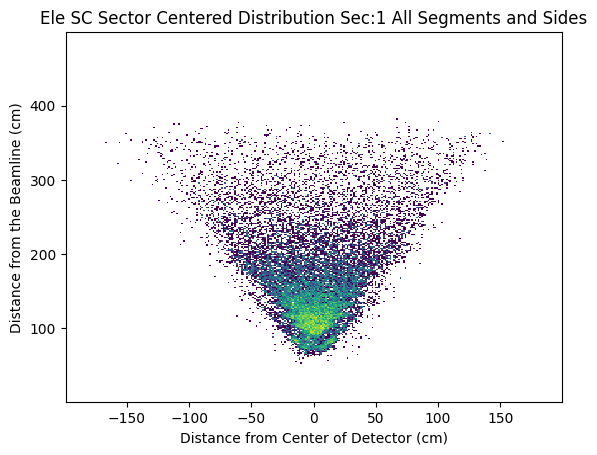

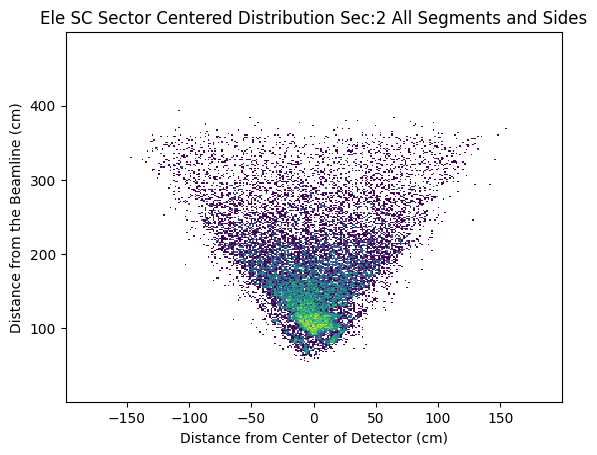

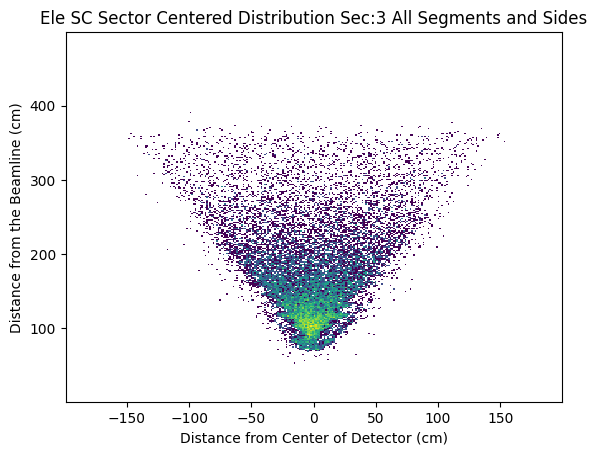

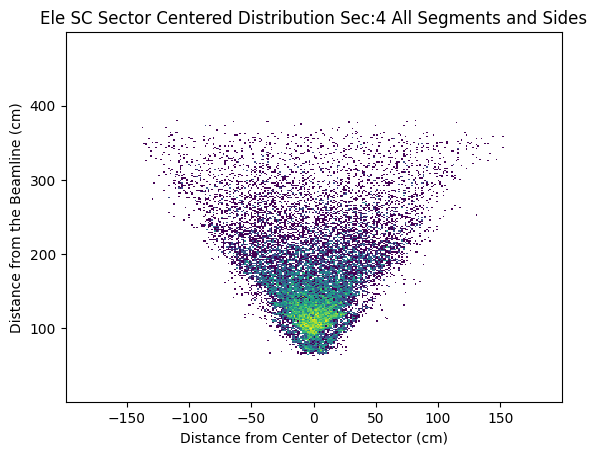

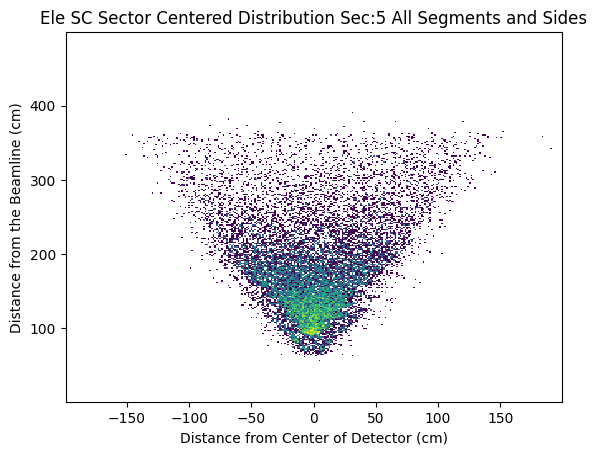

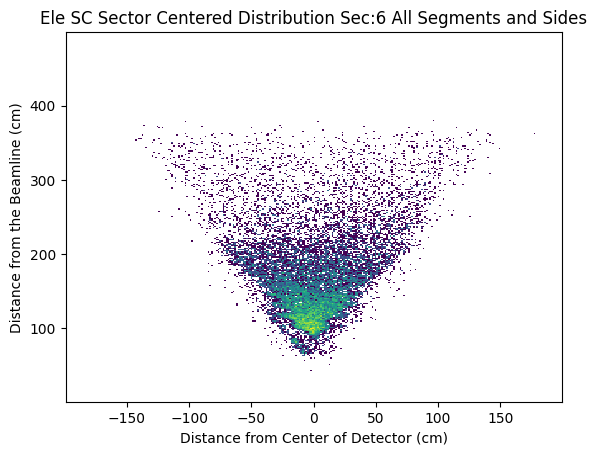

In [12]:
dumb1_x= np.zeros((7,cut_hist_len,xdim*ydim))
dumb1_y= np.zeros((7,cut_hist_len,xdim*ydim))
dense1 = np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_x= np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_y= np.zeros((7,cut_hist_len,xdim*ydim))
dense2 = np.zeros((7,cut_hist_len,xdim*ydim))
for sec in range(7):
    for i in range(xdim):
        for j in range(ydim):
            for hist_idx in range(cut_hist_len):
                dumb1_x[sec][hist_idx][i+j*xdim]+=xvals[i]
                dumb1_y[sec][hist_idx][i+j*xdim]+=yvals[j]
                dense1[sec][hist_idx][i+j*xdim]+=zvals_xy[sec][hist_idx][i][j]
                dumb2_x[sec][hist_idx][j+i*ydim]+=yvals[j]
                dumb2_y[sec][hist_idx][j+i*ydim]+=xvals[i]
                dense2[sec][hist_idx][j+i*ydim]+=zvals_yx[sec][hist_idx][j][i]
for sec in range(6):
    plt.hist2d(dumb1_x[sec][cut_hist_len-1], dumb1_y[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1[sec][cut_hist_len-1],norm = mpl.colors.LogNorm())
    plt.title("Ele SC Sector Centered Distribution Sec:{} All Segments and Sides".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.show()

In [13]:
#Shifting for Right Edge
dumb1_x_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dumb1_y_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dense1_sr = np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_x_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_y_sr= np.zeros((7,cut_hist_len,xdim*ydim))
dense2_sr = np.zeros((7,cut_hist_len,xdim*ydim))
for sec in range(7):
    for i in range(xdim):
        for j in range(ydim):
            for hist_idx in range(cut_hist_len):
                dumb1_x_sr[sec][hist_idx][i+j*xdim]+=xvals[i]-yvals[j]/right_rot[sec]
                dumb1_y_sr[sec][hist_idx][i+j*xdim]+=yvals[j]
                dense1_sr[sec][hist_idx][i+j*xdim]+=zvals_xy[sec][hist_idx][i][j]
                dumb2_x_sr[sec][hist_idx][j+i*ydim]+=yvals[j]
                dumb2_y_sr[sec][hist_idx][j+i*ydim]+=xvals[i]-yvals[j]/right_rot[sec]
                dense2_sr[sec][hist_idx][j+i*ydim]+=zvals_yx[sec][hist_idx][j][i]

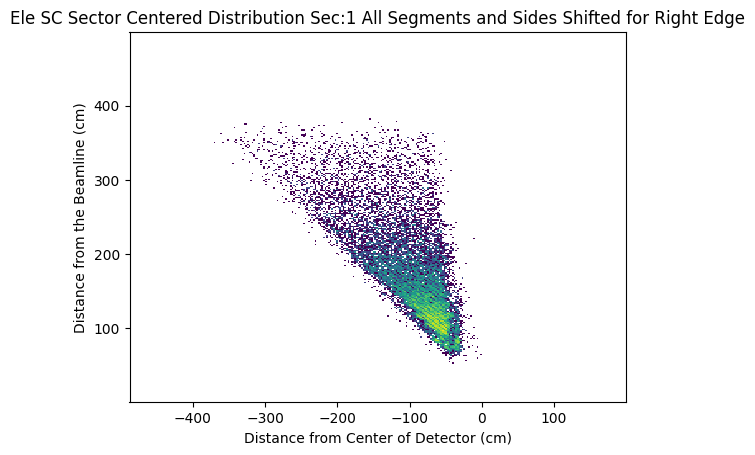

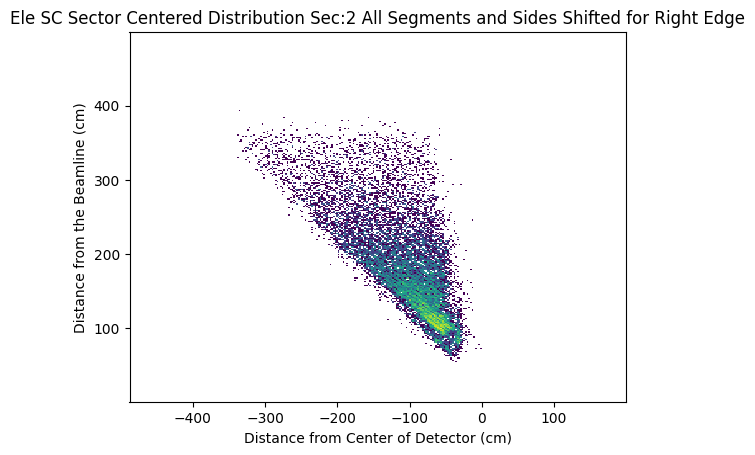

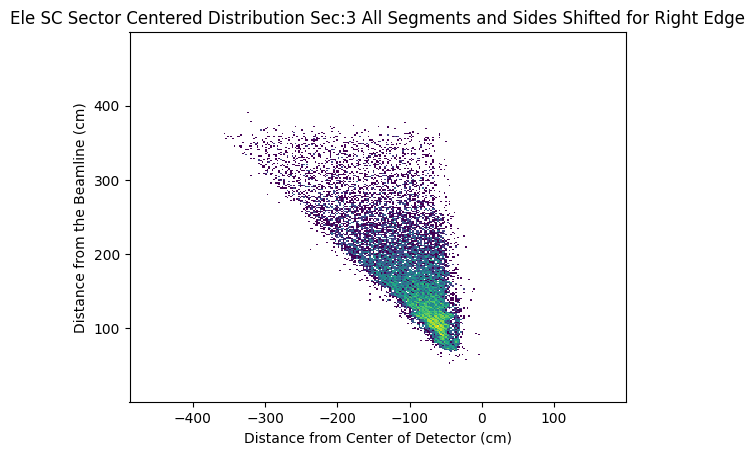

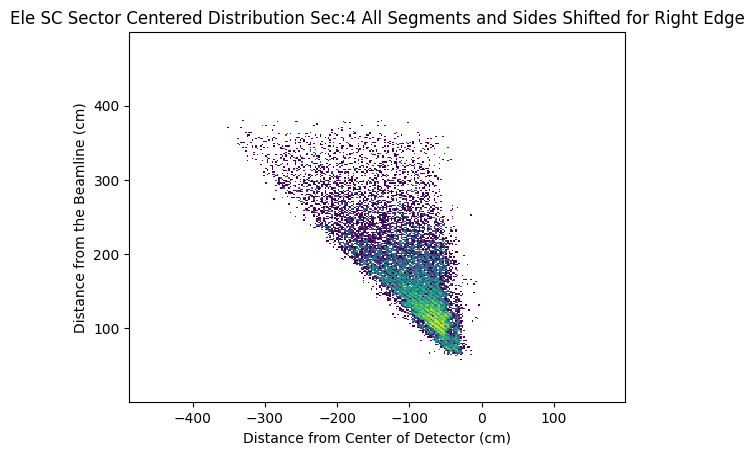

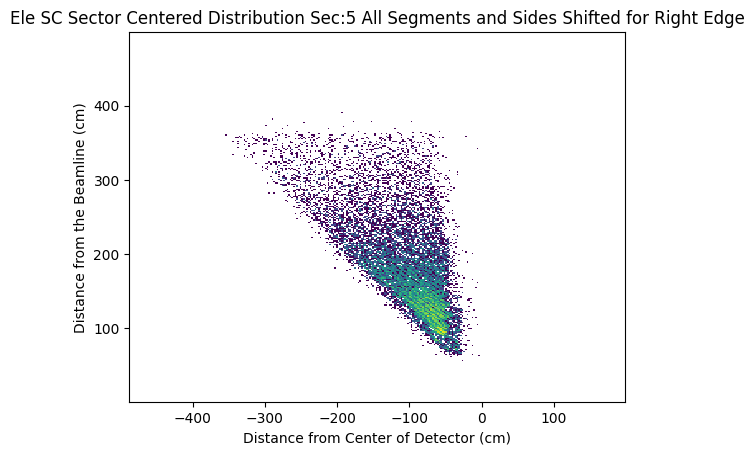

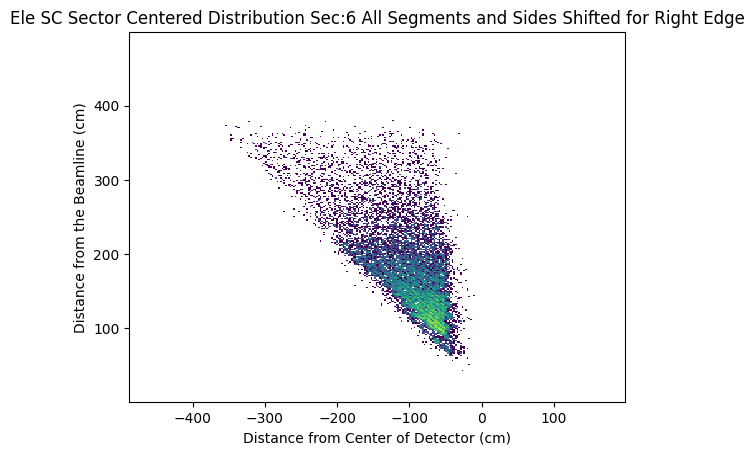

In [14]:
for sec in range(6):
    plt.hist2d(dumb1_x_sr[sec][cut_hist_len-1], dumb1_y_sr[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1_sr[sec][cut_hist_len-1],norm = mpl.colors.LogNorm())
    plt.title("Ele SC Sector Centered Distribution Sec:{} All Segments and Sides Shifted for Right Edge".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.show()

In [15]:
#Shifting for Left Edge
dumb1_x_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dumb1_y_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dense1_sl = np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_x_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dumb2_y_sl= np.zeros((7,cut_hist_len,xdim*ydim))
dense2_sl = np.zeros((7,cut_hist_len,xdim*ydim))
for sec in range(7):
    for i in range(xdim):
        for j in range(ydim):
            for hist_idx in range(cut_hist_len):
                dumb1_x_sl[sec][hist_idx][i+j*xdim]+=xvals[i]+yvals[j]/left_rot[sec]
                dumb1_y_sl[sec][hist_idx][i+j*xdim]+=yvals[j]
                dense1_sl[sec][hist_idx][i+j*xdim]+=zvals_xy[sec][hist_idx][i][j]
                dumb2_x_sl[sec][hist_idx][j+i*ydim]+=yvals[j]
                dumb2_y_sl[sec][hist_idx][j+i*ydim]+=xvals[i]+yvals[j]/left_rot[sec]
                dense2_sl[sec][hist_idx][j+i*ydim]+=zvals_yx[sec][hist_idx][j][i]

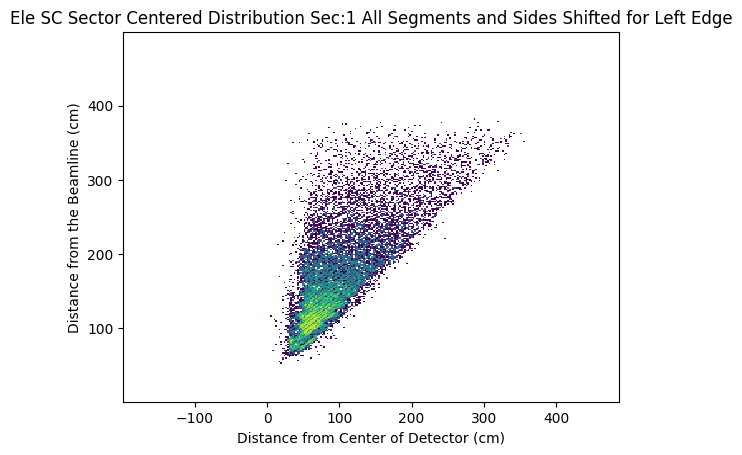

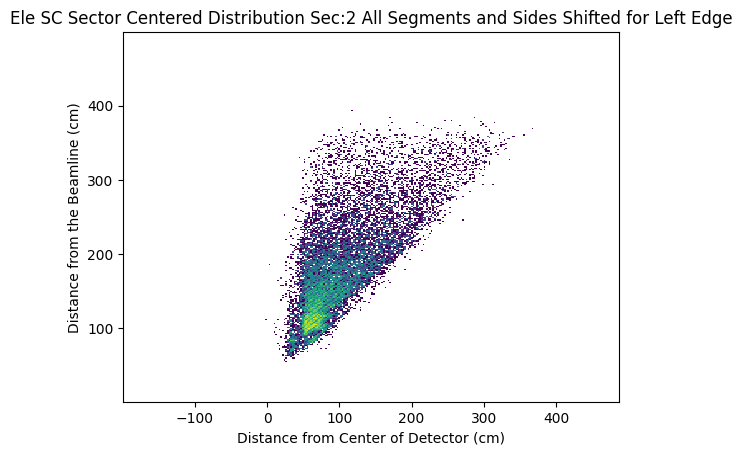

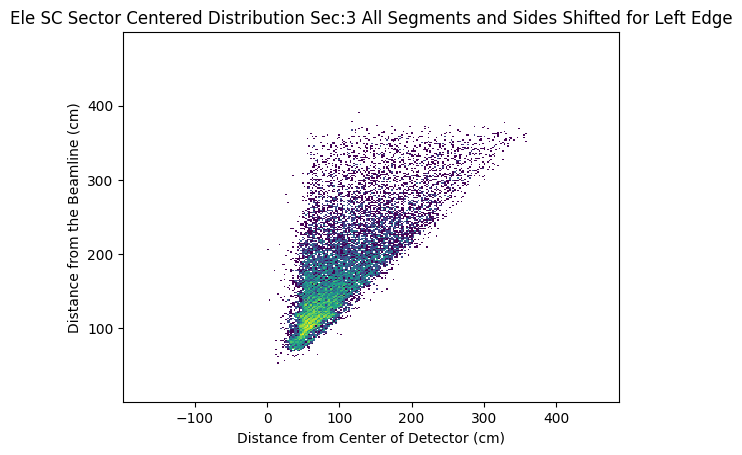

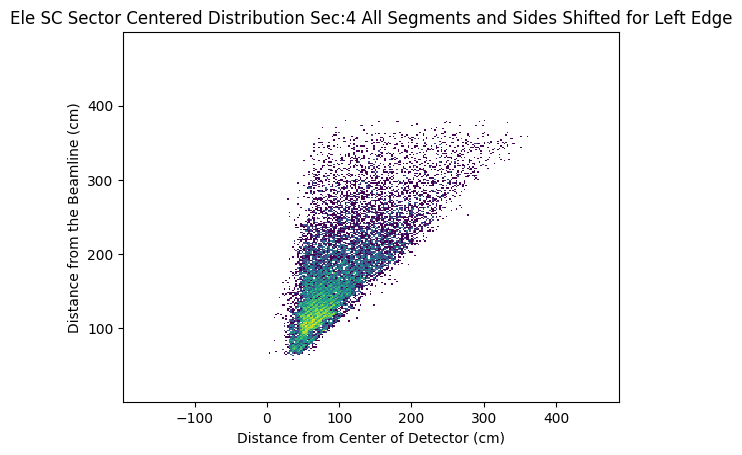

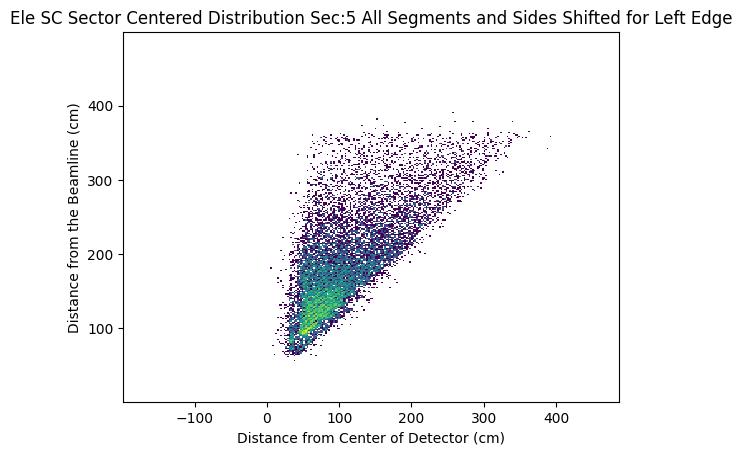

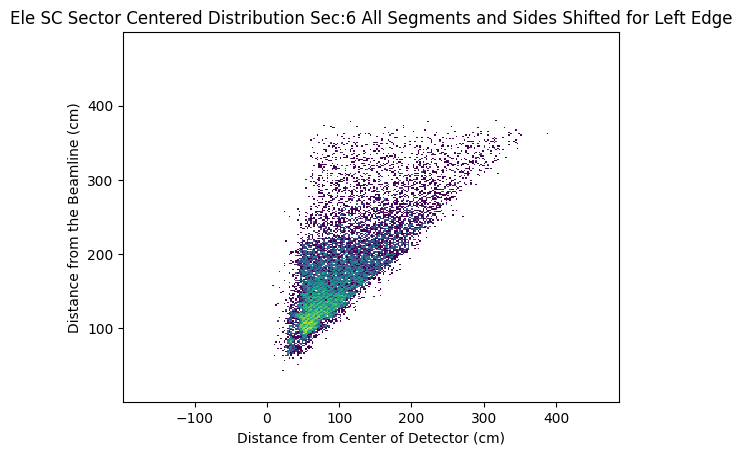

In [16]:
for sec in range(6):
    plt.hist2d(dumb1_x_sl[sec][cut_hist_len-1], dumb1_y_sl[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1_sl[sec][cut_hist_len-1],norm = mpl.colors.LogNorm())
    plt.title("Ele SC Sector Centered Distribution Sec:{} All Segments and Sides Shifted for Left Edge".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.show()

In [17]:
proj_y = np.zeros((7,cut_hist_len,ydim))
proj_xr = np.zeros((7,cut_hist_len,xdim))
proj_xl = np.zeros((7,cut_hist_len,xdim))
for sec in range(7):
    for i in range(ydim):
        for j in range(xdim):
            for hist_idx in range(cut_hist_len):
                proj_y[sec][hist_idx][i] += zvals_xy[sec][hist_idx][j][i]
                if j-shift_idx(yvals[i]/(3**(1/2))) > 0:
                    proj_xr[sec][hist_idx][j-shift_idx(yvals[i]/right_rot[sec])] += zvals_xy[sec][hist_idx][j][i]
                if j+shift_idx(yvals[i]/(3**(1/2))) < xdim-1:
                    proj_xl[sec][hist_idx][j+shift_idx(yvals[i]/left_rot[sec])] += zvals_xy[sec][hist_idx][j][i]

In [18]:
edge_shifts = [-0.8,-0.1,0.7]

[-6.23774582e+00 -4.18448134e+01  5.44086009e+01  5.16828700e+04]


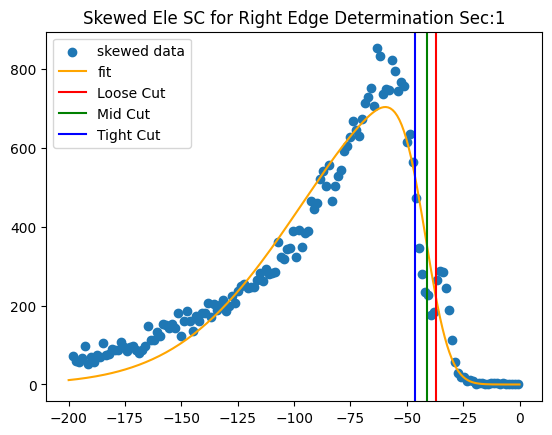

[-6.63250175e+00 -4.33641359e+01  6.32203291e+01  4.90101753e+04]


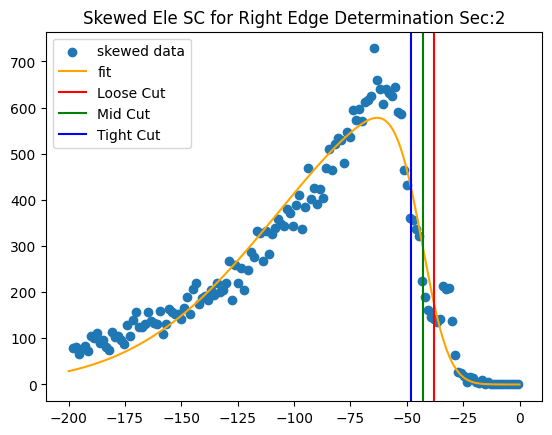

[-8.61218618e+00 -4.49582154e+01  5.56875370e+01  4.88596269e+04]


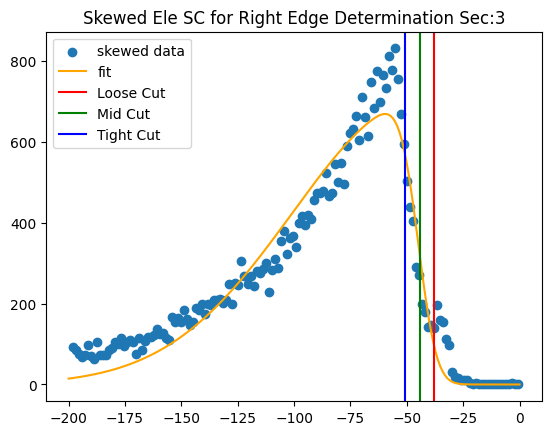

[-6.09927556e+00 -4.31619740e+01  5.55881827e+01  4.77215175e+04]


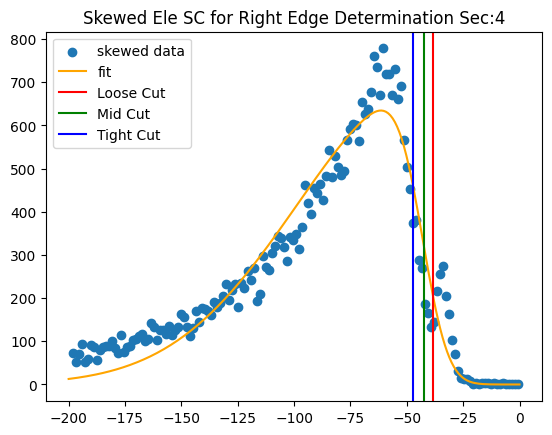

[-8.48756379e+00 -4.54314434e+01  6.19157269e+01  4.42818729e+04]


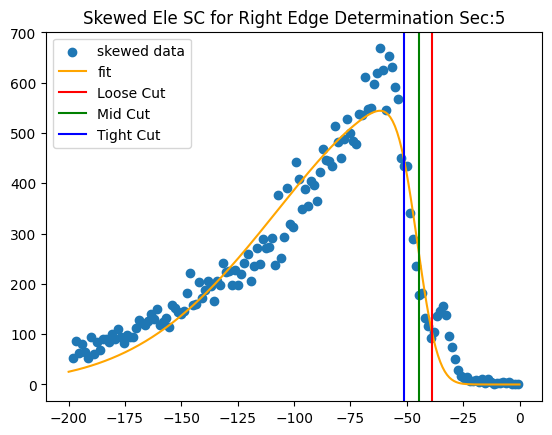

[-9.95997558e+00 -4.72540299e+01  5.36537896e+01  4.58331604e+04]


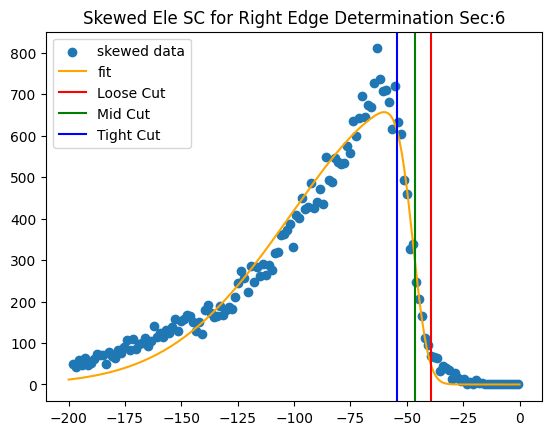

[-7.45526208e+00 -4.43806356e+01  5.72300589e+01  2.86645944e+05]


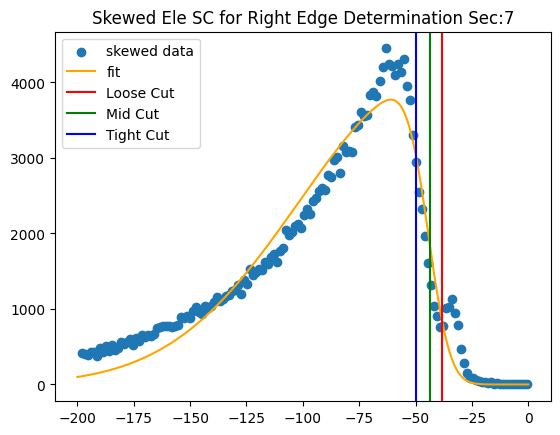

In [19]:
right_edge = [[-50.,-50,-50.] for i in range(7)]

ini_par = [-6.23,-41,54,51670]

#Bounds_on_Y(yarray_,low_,high_) removes all values not between or equal to bounds
#Bounds_on_X_From_Y(xarray_,yarray_,low_,high_) 

#skew_norm(x_,skew_,loc_,scale_,norm_)
for sec in range(7):
    mod_xvals = Bounds_on_Y(xvals,-198,0.0)
    mod_zvals = Bounds_on_X_From_Y(proj_xr[sec][num_sc_pad],xvals,-198,0.0)
    
    plt.scatter(mod_xvals,mod_zvals,label="skewed data")
    cont_x = np.linspace(-200,0,200)
    #plt.plot(cont_x,skew_norm(cont_x,*ini_par),label="ini_pars")
    try:
        pars, pars_cov = op.curve_fit(skew_norm,mod_xvals,mod_zvals,p0=ini_par,maxfev=5000)
        plt.plot(cont_x,skew_norm(cont_x,*pars),label="fit",color='orange')
        print(pars)
        right_edge[sec][2] = pars[1]+edge_shifts[0]*pars[0]
        right_edge[sec][1] = pars[1]+edge_shifts[1]*pars[0]
        right_edge[sec][0] = pars[1]+edge_shifts[2]*pars[0]
    except RuntimeError:
        print("Runtime Error")
    except ValueError:
        print("Value Error")
    plt.axvline(x=right_edge[sec][2],label="Loose Cut",color='r')
    plt.axvline(x=right_edge[sec][1],label="Mid Cut",color='g')
    plt.axvline(x=right_edge[sec][0],label="Tight Cut",color='b')
    plt.title("Skewed Ele SC for Right Edge Determination Sec:{}".format(sec+1))
    plt.legend()
    plt.show()

[6.26795586e+00 4.30607845e+01 5.34290824e+01 5.13403106e+04]


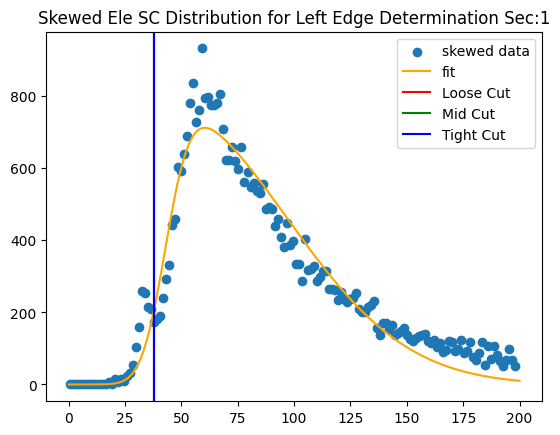

[1.24368606e+01 4.80479269e+01 4.98420530e+01 4.53379708e+04]


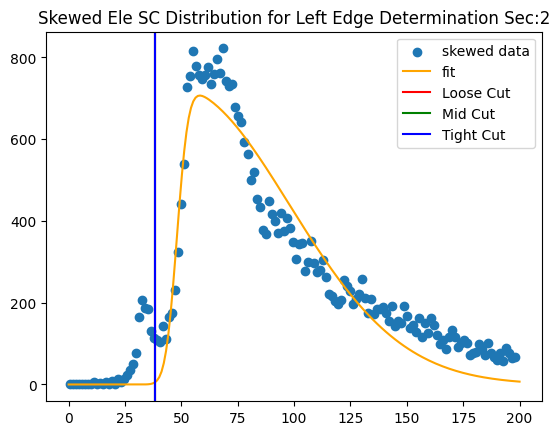

[9.31112316e+00 4.27137093e+01 5.59194045e+01 4.88532451e+04]


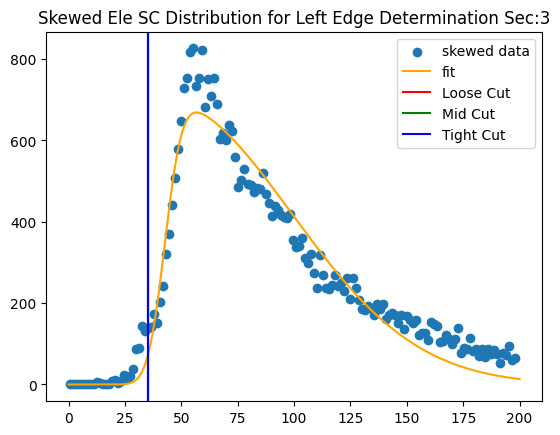

[7.68898135e+00 4.34640555e+01 5.33278797e+01 4.74611859e+04]


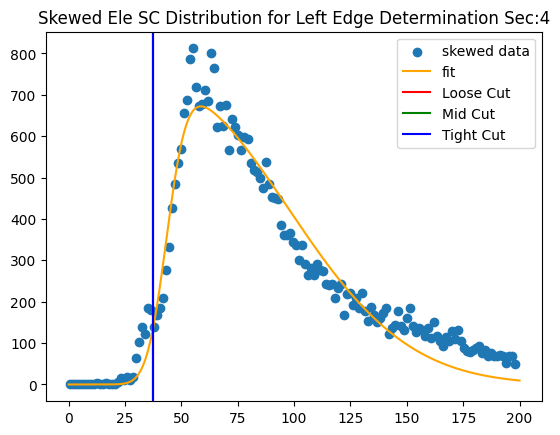

[7.66659985e+00 4.29812962e+01 6.00448218e+01 4.33138378e+04]


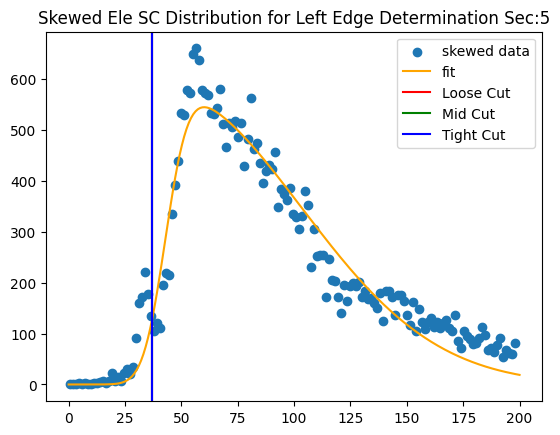

[1.16307486e+01 4.42753948e+01 5.60526372e+01 4.41276598e+04]


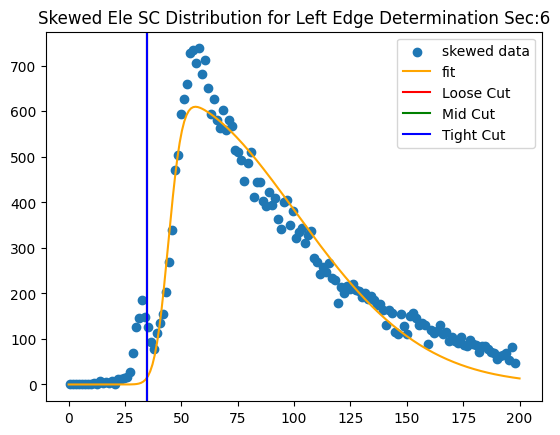

[7.89291416e+00 4.38472775e+01 5.48440433e+01 2.81614397e+05]


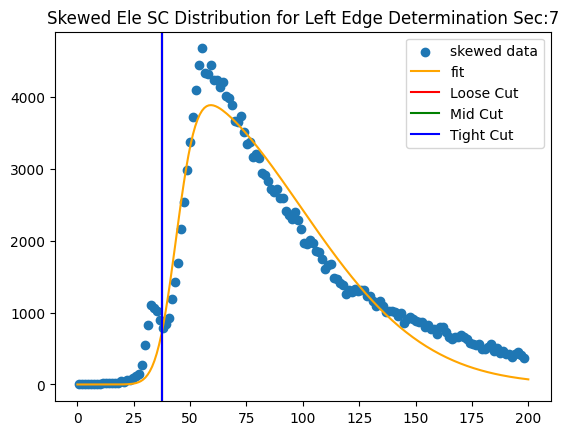

In [20]:
left_edge = [[50.,50,50.] for i in range(7)]

ini_par = [6.23,41,54,51670]

for sec in range(7):
    mod_xvals = Bounds_on_Y(xvals,0.0,198)
    mod_zvals = Bounds_on_X_From_Y(proj_xl[sec][num_sc_pad],xvals,0.0,198)
    
    plt.scatter(mod_xvals,mod_zvals,label="skewed data")
    cont_x = np.linspace(0.0,200,200)
    #plt.plot(cont_x,skew_norm(cont_x,*ini_par),label="ini_pars")
    try:
        pars, pars_cov = op.curve_fit(skew_norm,mod_xvals,mod_zvals,p0=ini_par,maxfev=5000)
        plt.plot(cont_x,skew_norm(cont_x,*pars),label="fit",color='orange')
        print(pars)
        left_edge[sec][2] = pars[1]+edge_shifts[0]*pars[0]
        left_edge[sec][1] = pars[1]+edge_shifts[0]*pars[0]
        left_edge[sec][0] = pars[1]+edge_shifts[0]*pars[0]
    except RuntimeError:
        print("Runtime Error")
    except ValueError:
        print("Value Error")
    plt.axvline(x=left_edge[sec][2],label="Loose Cut",color='r')
    plt.axvline(x=left_edge[sec][1],label="Mid Cut",color='g')
    plt.axvline(x=left_edge[sec][0],label="Tight Cut",color='b')
    plt.title("Skewed Ele SC Distribution for Left Edge Determination Sec:{}".format(sec+1))
    plt.legend()
    plt.show()

In [21]:
def super_gaus_cut_bound(frac_,side_,a_,m_,s_,p_):
    if side_ == 0:
        return 0.5*(2*m_ - 2 * (math.log(1./frac_)**(1./p_))*(2**(p_/2.)*(1./s_)**(-p_))**(1./p_))
    elif side_ ==1:
        return 0.5*(2*m_ + 2 * (math.log(1./frac_)**(1./p_))*(2**(p_/2.)*(1./s_)**(-p_))**(1./p_))
    else:
        return -99.9
    

def Sup_Gaus_Cutoff(x_,frac_,a_,m_,s_,p_):
    if x < super_gaus_cut_bound(frac_,0,a_,m_,s_,p_):
        return 0.
    elif x > super_gaus_cut_bound(frac_,1,a_,m_,s_,p_):
        return 0.
    else:
        return Super_Gaus(x_,a_,m_,s_,p_)
    
def Sup_Gaus_Cutoff_Array(x_,frac_,a_,m_,s_,p_):
    output = np.zeros(len(x_))
    for i in range(len(x_)):
        output[i] = Sup_Gaus_Cutoff(x_[i],frac_,a_,m_,s_,p_)
    return output

Parameters for Sec:1 Paddle:2
test pars [250.   75.    5.4   4. ]
fit pars [202.26805546  76.62042805   5.11381343   8.28181992]


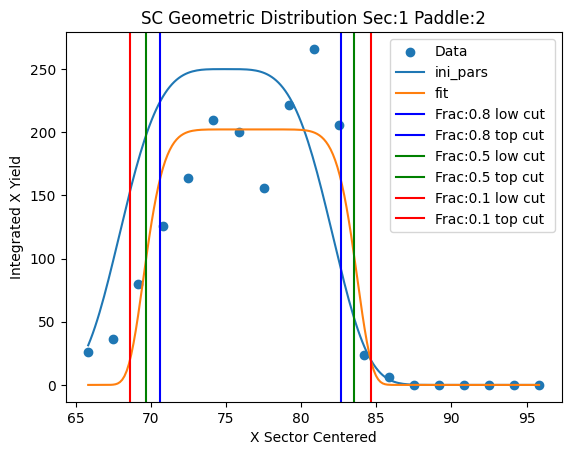

Parameters for Sec:1 Paddle:3
test pars [202.26805546  90.62042805   7.61381343   8.28181992]
fit pars [268.74999986  89.99217485   5.31775641  79.32323637]


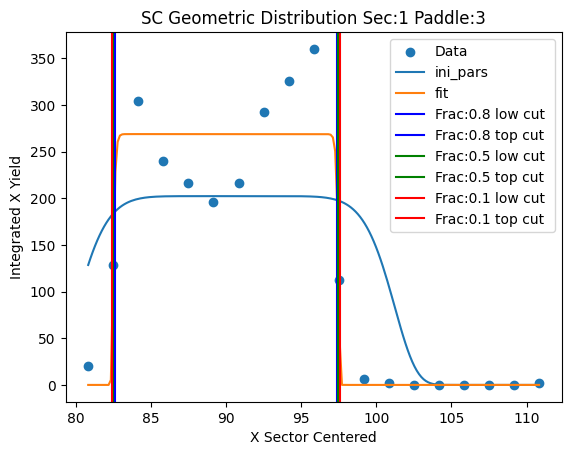

Parameters for Sec:1 Paddle:4
test pars [268.74999986 103.99217485   7.81775641  79.32323637]
fit pars [540.35864452 104.05353545   4.94824844   6.58583716]


/var/folders/9h/zwsh0vf94zxdp3tw1qp_dcjw0000gn/T/ipykernel_63477/3852480128.py:4: RuntimeWarning: overflow encountered in power
  return a_*np.exp(-(np.abs(x-m_)/(np.sqrt(2)*s_))**p_)
/var/folders/9h/zwsh0vf94zxdp3tw1qp_dcjw0000gn/T/ipykernel_63477/3852480128.py:4: RuntimeWarning: invalid value encountered in power
  return a_*np.exp(-(np.abs(x-m_)/(np.sqrt(2)*s_))**p_)


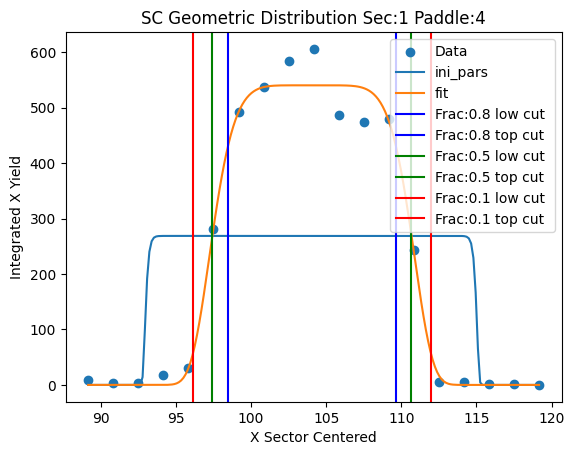

Parameters for Sec:1 Paddle:5
test pars [540.35864452 118.05353545   7.44824844   6.58583716]
fit pars [667.03779465 117.44135385   4.8559943    4.84055319]


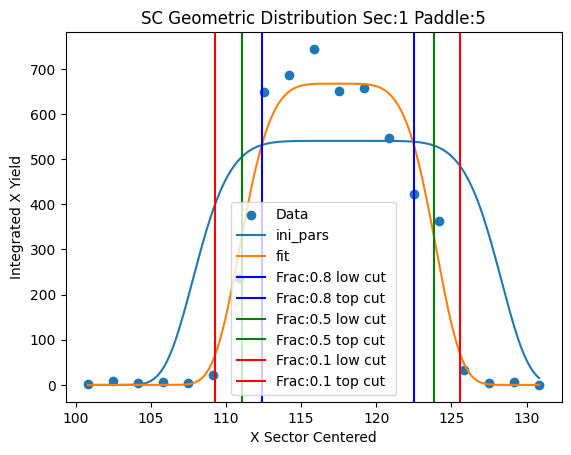

Parameters for Sec:1 Paddle:6
test pars [667.03779465 131.44135385   7.3559943    4.84055319]
fit pars [545.54912694 131.4934288    4.92289068   8.99732169]


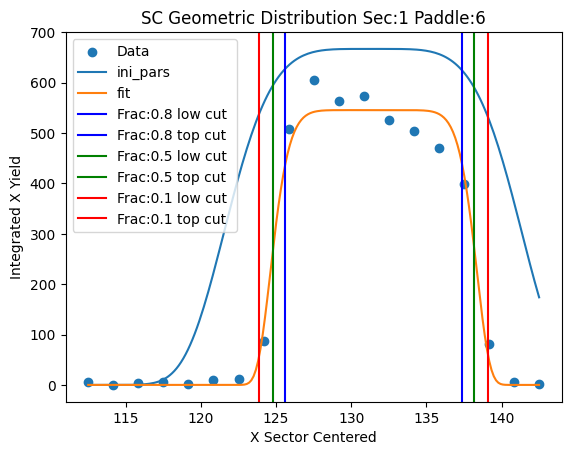

Parameters for Sec:1 Paddle:7
test pars [545.54912694 145.4934288    7.42289068   8.99732169]
fit pars [454.53190442 145.28823112   4.99686251  10.26934828]


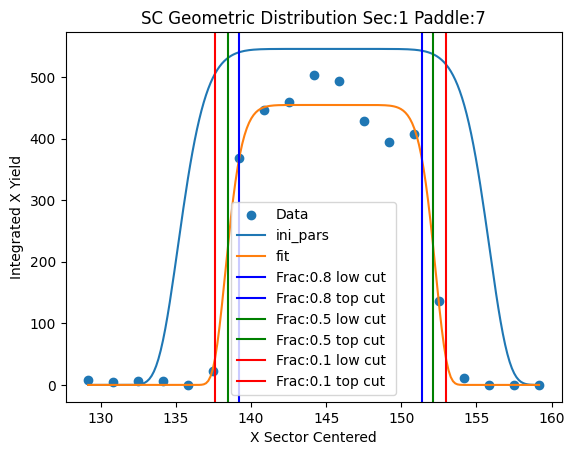

Parameters for Sec:1 Paddle:8
test pars [454.53190442 159.28823112   7.49686251  10.26934828]
fit pars [385.69576013 159.11574824   5.09076553   7.34392649]


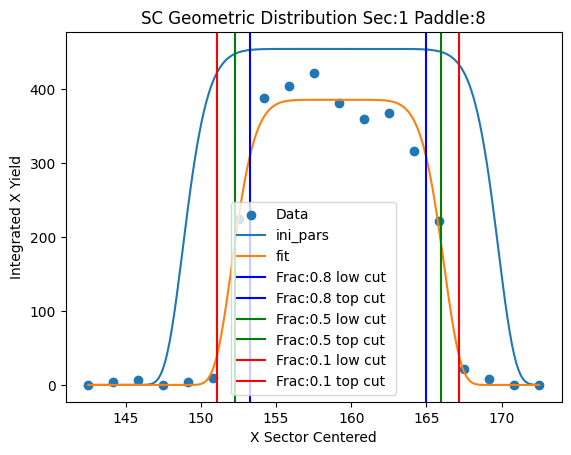

Parameters for Sec:1 Paddle:9
test pars [385.69576013 173.11574824   7.59076553   7.34392649]
fit pars [344.80896169 173.07740036   5.1156523   12.45233243]


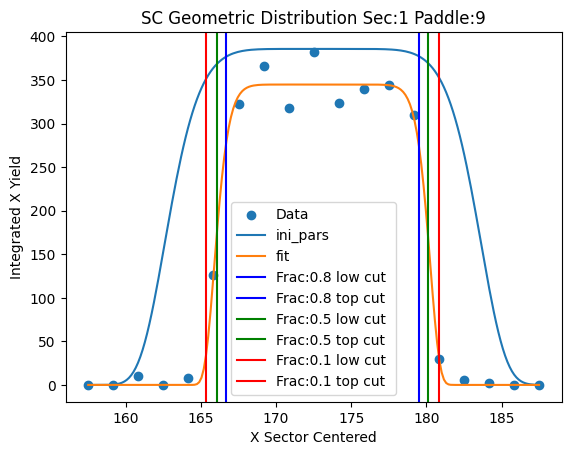

Parameters for Sec:1 Paddle:10
test pars [344.80896169 187.07740036   7.6156523   12.45233243]
fit pars [315.39252451 186.70515934   5.1621361   18.88965807]


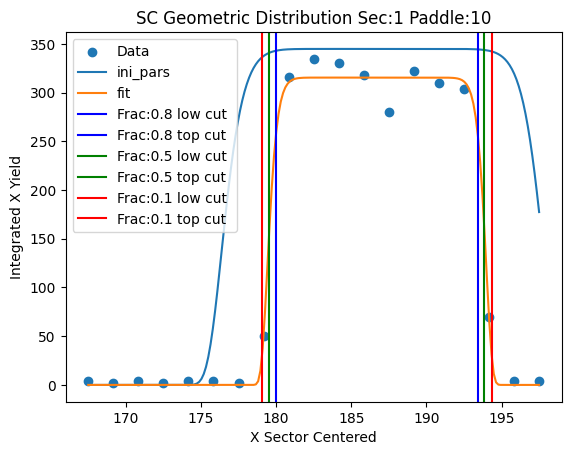

Parameters for Sec:1 Paddle:11
test pars [315.39252451 200.70515934   7.6621361   18.88965807]
fit pars [249.01923774 200.47479738   5.1789865   10.96849755]


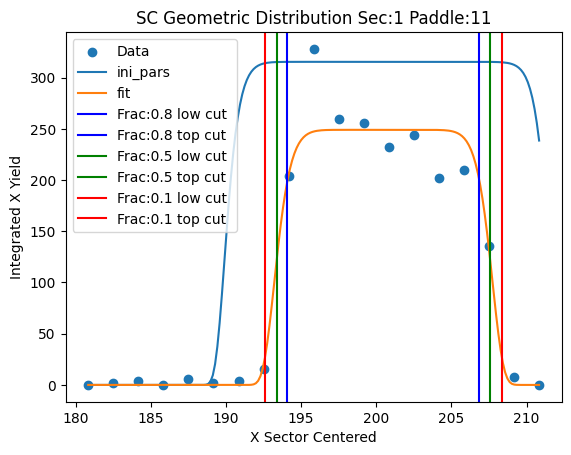

Parameters for Sec:1 Paddle:12
test pars [249.01923774 214.47479738   7.6789865   10.96849755]
fit pars [206.43817687 214.30139234   5.20239412   7.47894114]


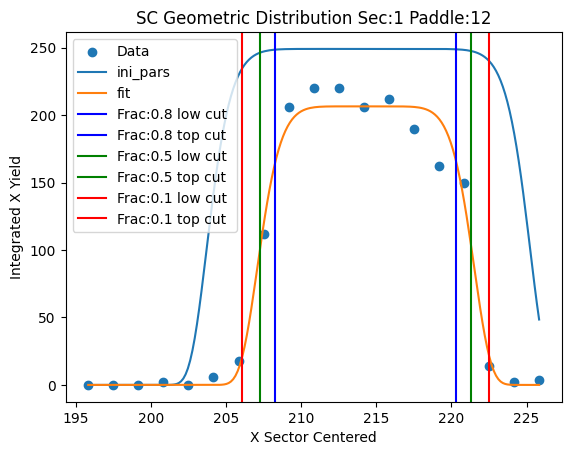

Parameters for Sec:1 Paddle:13
test pars [206.43817687 228.30139234   7.70239412   7.47894114]
fit pars [178.87070919 228.34391073   5.03049753  11.01906501]


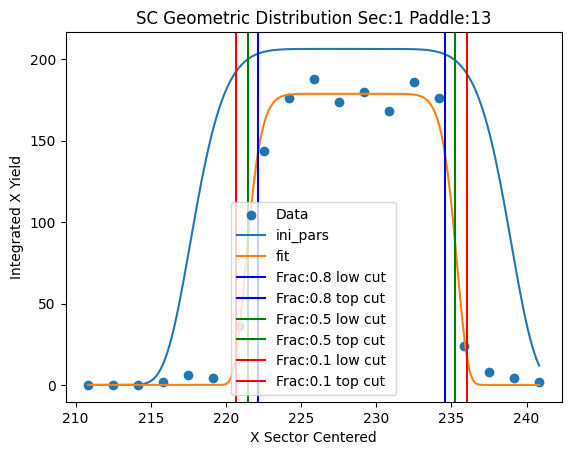

Parameters for Sec:1 Paddle:14
test pars [178.87070919 242.34391073   7.53049753  11.01906501]
fit pars [154.62078292 241.8518108    5.1560033   12.8222045 ]


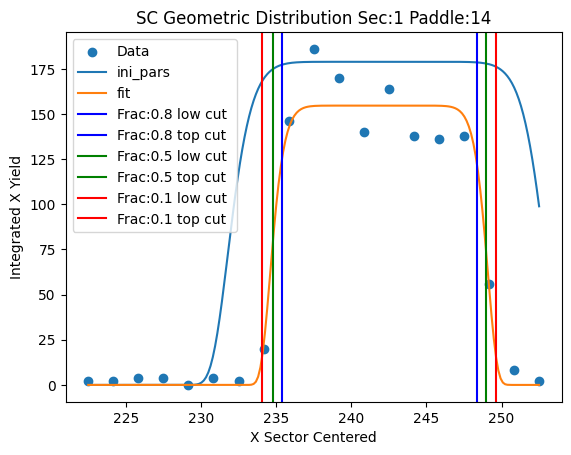

Parameters for Sec:1 Paddle:15
test pars [154.62078292 255.8518108    7.6560033   12.8222045 ]
fit pars [113.86257995 255.99648775   5.27321158   9.02460059]


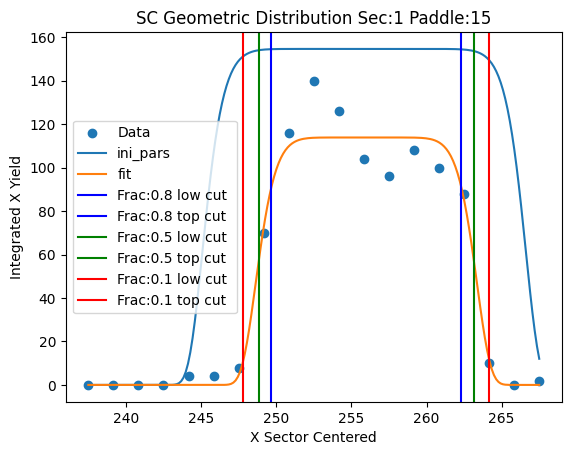

Parameters for Sec:1 Paddle:16
test pars [113.86257995 269.99648775   7.77321158   9.02460059]
fit pars [124.08614664 269.85255741   4.96253105   4.95323442]


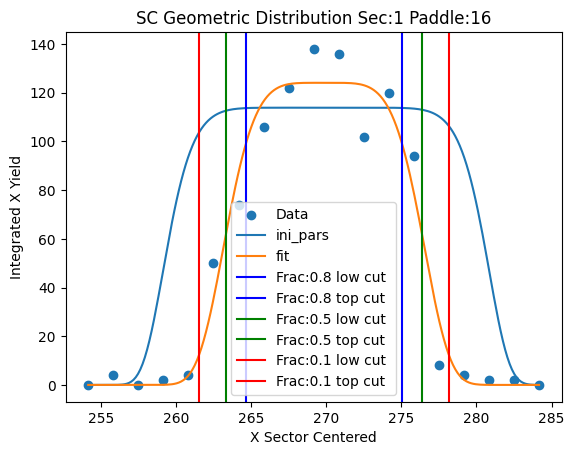

Parameters for Sec:1 Paddle:17
test pars [124.08614664 283.85255741   7.46253105   4.95323442]
fit pars [ 99.00000006 283.33922778   5.27205455  79.66738422]


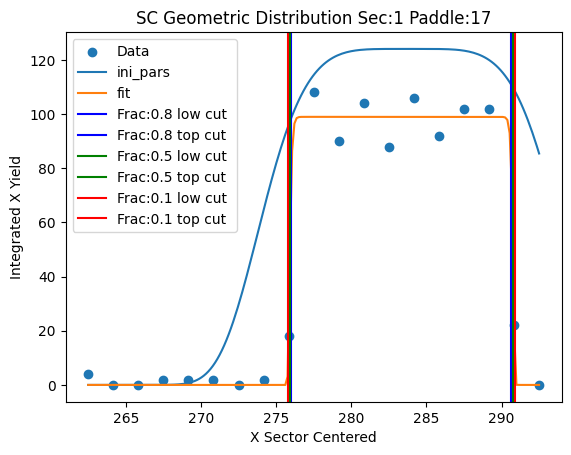

Parameters for Sec:1 Paddle:18
test pars [ 99.00000006 297.33922778   7.77205455  79.66738422]
fit pars [ 84.91205342 297.59219941   5.09822877   4.11922268]


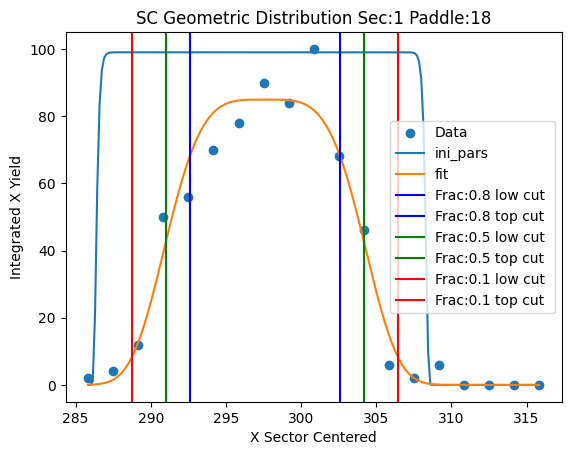

Parameters for Sec:1 Paddle:19
test pars [ 84.91205342 311.59219941   7.59822877   4.11922268]
fit pars [ 65.42857143 310.85383888   4.76529471  66.53206343]


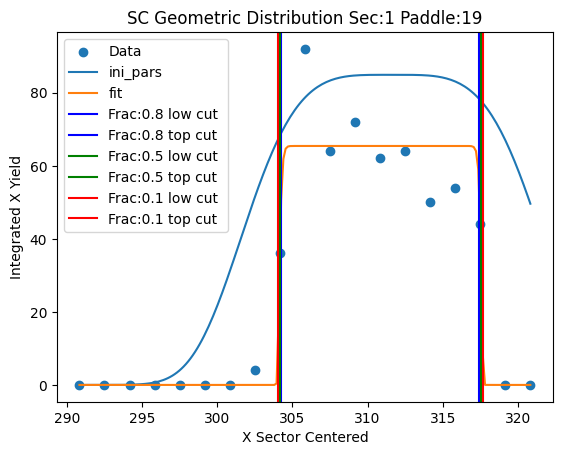

Parameters for Sec:1 Paddle:20
test pars [ 65.42857143 324.85383888   7.26529471  66.53206343]
fit pars [ 65.09197113 324.72927361   4.86685781   7.29037089]


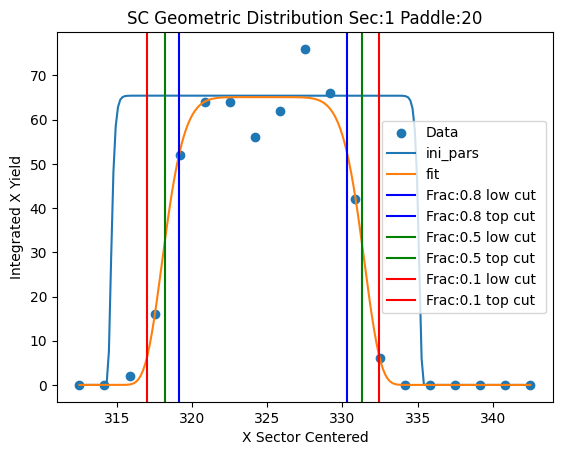

Parameters for Sec:1 Paddle:21
test pars [ 65.09197113 338.72927361   7.36685781   7.29037089]
fit pars [ 45.71567372 338.16612379   5.19470378   6.95597407]


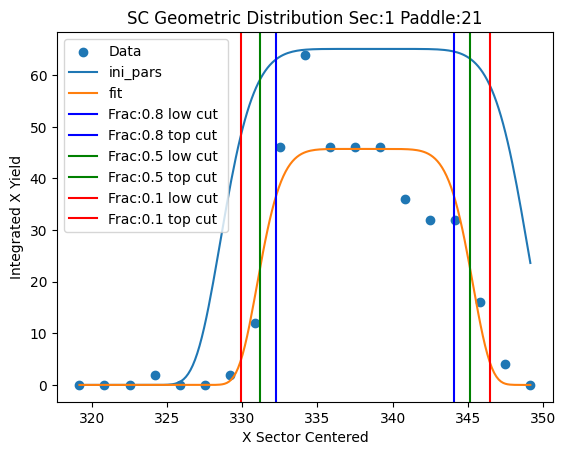

Parameters for Sec:1 Paddle:22
test pars [ 45.71567372 352.16612379   7.69470378   6.95597407]
fit pars [ 49.81406447 350.61479882   4.54296938   2.00668201]


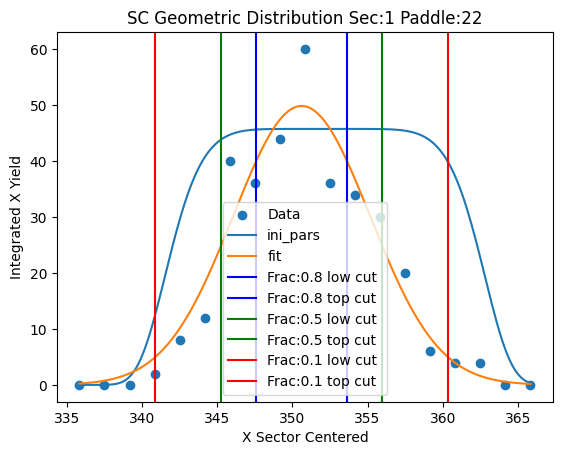

Parameters for Sec:1 Paddle:23
test pars [ 49.81406447 364.61479882   7.04296938   2.00668201]
fit pars [ 14.10474963 363.39785154   5.22275536   3.32372586]


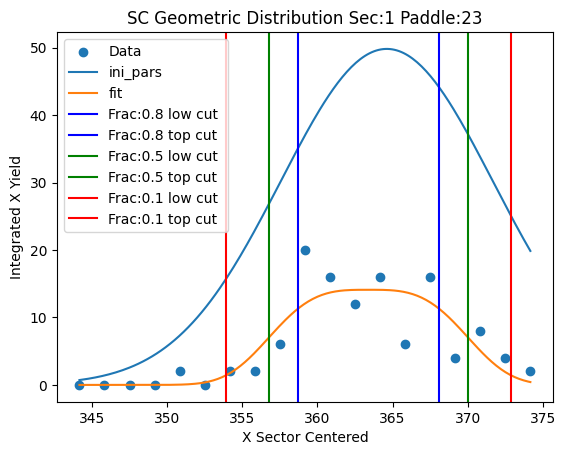

Parameters for Sec:1 Paddle:24
test pars [ 14.10474963 377.39785154   7.72275536   3.32372586]
fit pars [ 13.10478299 376.91194825   0.60638507   0.60338155]


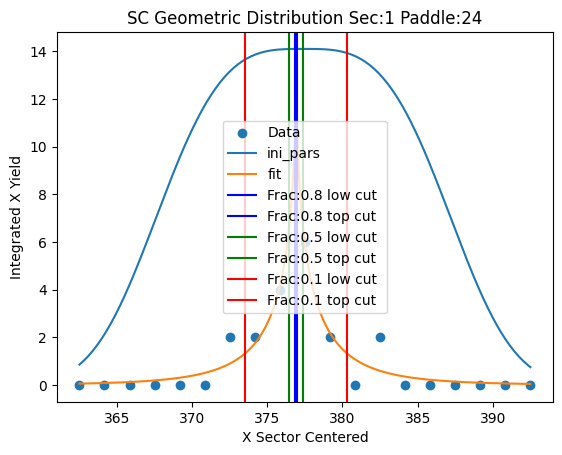

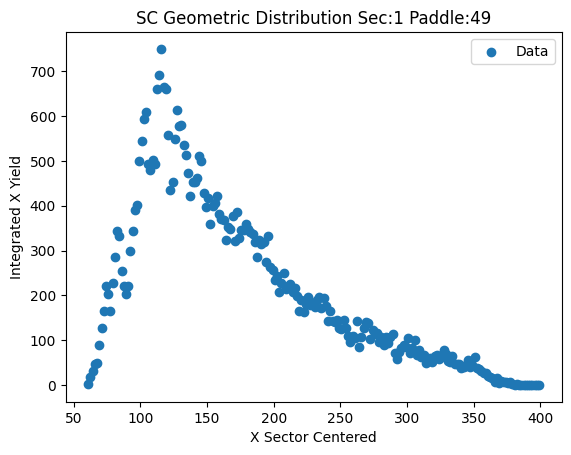

Parameters for Sec:2 Paddle:2
test pars [250.   75.    5.4   4. ]
fit pars [83.25       76.62973542  5.30587991 96.30090444]


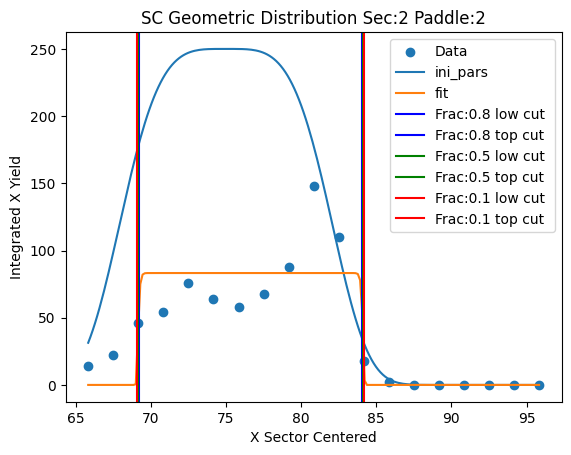

Parameters for Sec:2 Paddle:3
test pars [83.25       90.62973542  7.80587991 96.30090444]
fit pars [188.50000012  89.9655237    5.31439578  77.59530596]


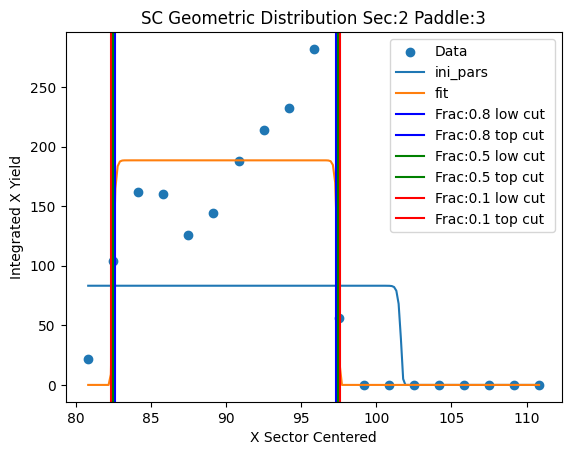

Parameters for Sec:2 Paddle:4
test pars [188.50000012 103.9655237    7.81439578  77.59530596]
fit pars [529.70248509 103.78666816   4.98081132   6.67241516]


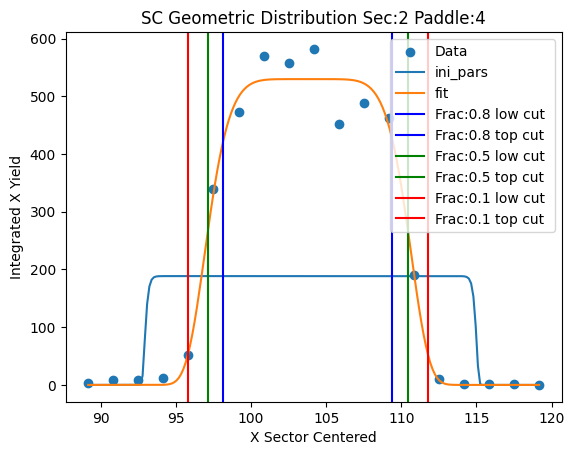

Parameters for Sec:2 Paddle:5
test pars [529.70248509 117.78666816   7.48081132   6.67241516]
fit pars [532.22171636 116.3938804    4.58257116   3.02845465]


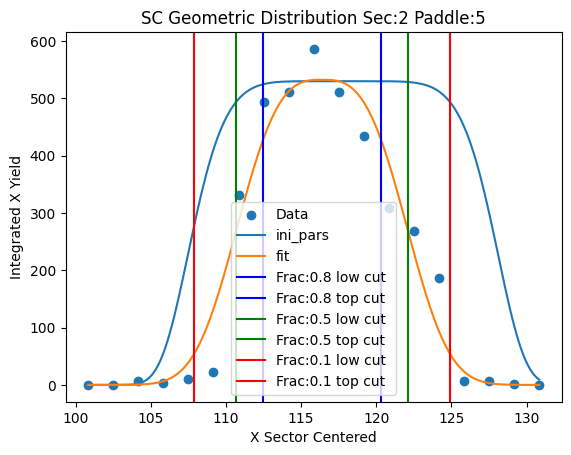

Parameters for Sec:2 Paddle:6
test pars [532.22171636 130.3938804    7.08257116   3.02845465]
fit pars [405.68740726 131.14572422   5.01038022   7.58399109]


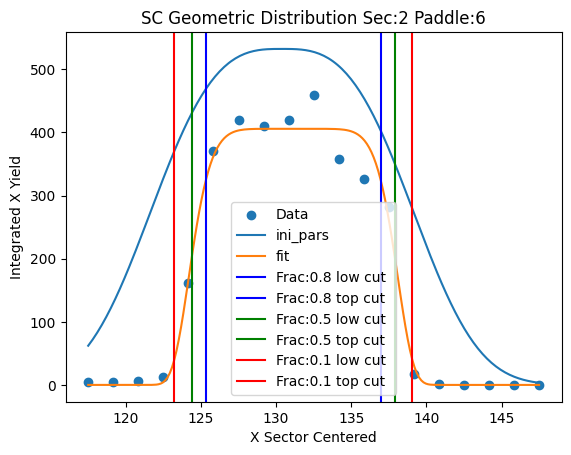

Parameters for Sec:2 Paddle:7
test pars [405.68740726 145.14572422   7.51038022   7.58399109]
fit pars [423.18424127 144.93023444   5.03133823   9.23987172]


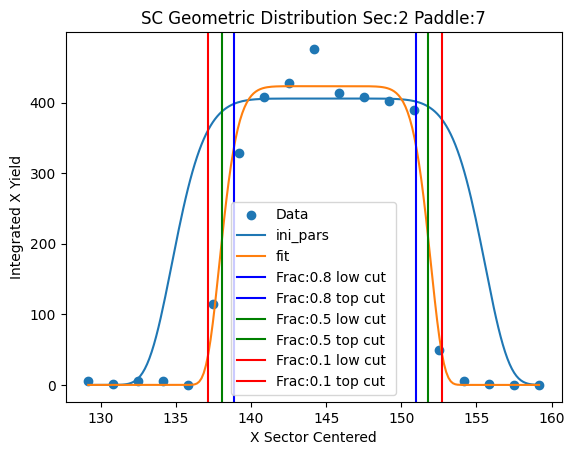

Parameters for Sec:2 Paddle:8
test pars [423.18424127 158.93023444   7.53133823   9.23987172]
fit pars [431.40803866 158.53951214   4.98636688   7.83483481]


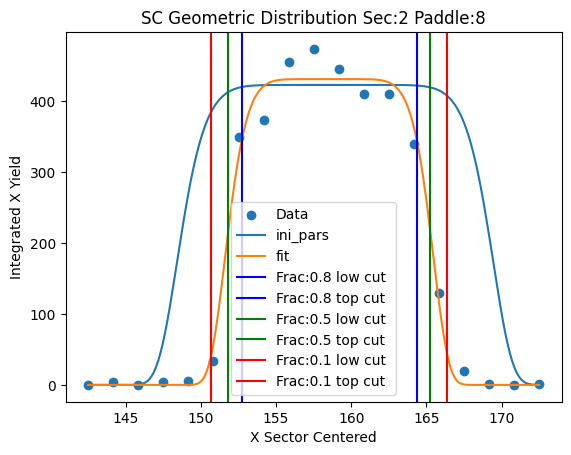

Parameters for Sec:2 Paddle:9
test pars [431.40803866 172.53951214   7.48636688   7.83483481]
fit pars [354.01382032 172.3677134    5.15113446   6.62116139]


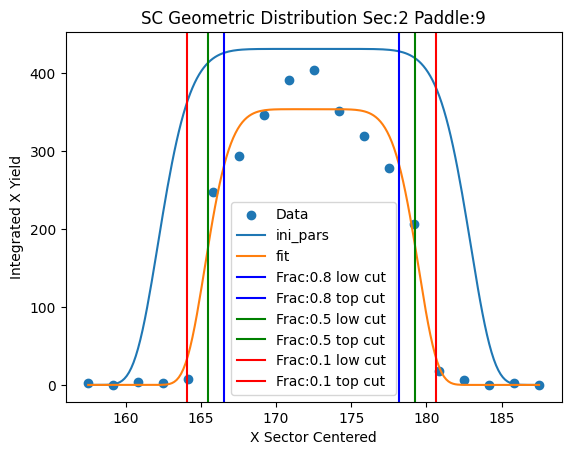

Parameters for Sec:2 Paddle:10
test pars [354.01382032 186.3677134    7.65113446   6.62116139]
fit pars [345.1198519  186.19197931   4.98392815   9.89021036]


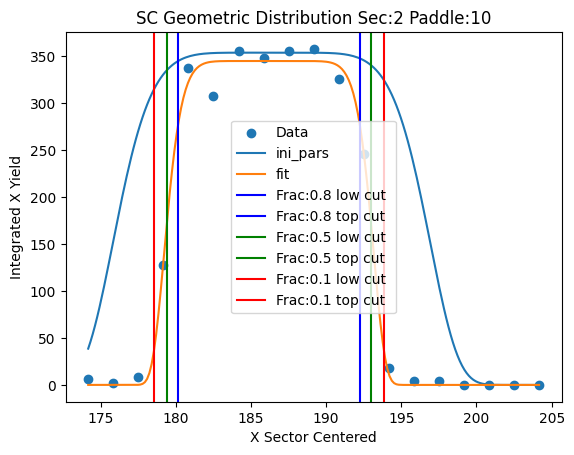

Parameters for Sec:2 Paddle:11
test pars [345.1198519  200.19197931   7.48392815   9.89021036]
fit pars [275.35838575 199.99431431   5.09576069  14.58235491]


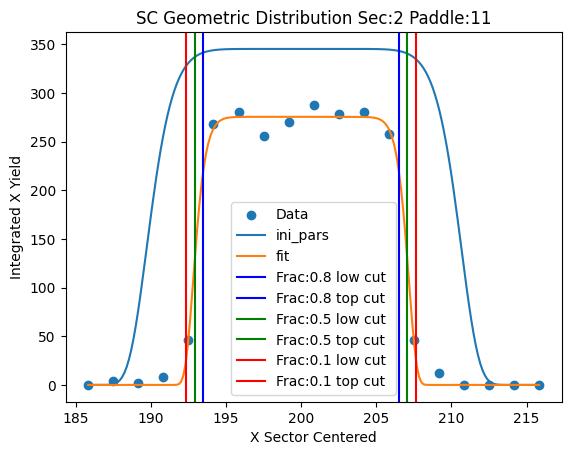

Parameters for Sec:2 Paddle:12
test pars [275.35838575 213.99431431   7.59576069  14.58235491]
fit pars [261.41535061 213.6453736    4.93860724   7.43608175]


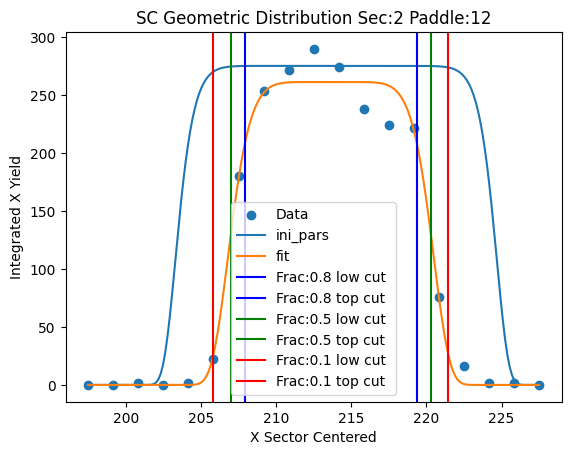

Parameters for Sec:2 Paddle:13
test pars [261.41535061 227.6453736    7.43860724   7.43608175]
fit pars [187.71428576 227.49579331   4.73336785  71.60176587]


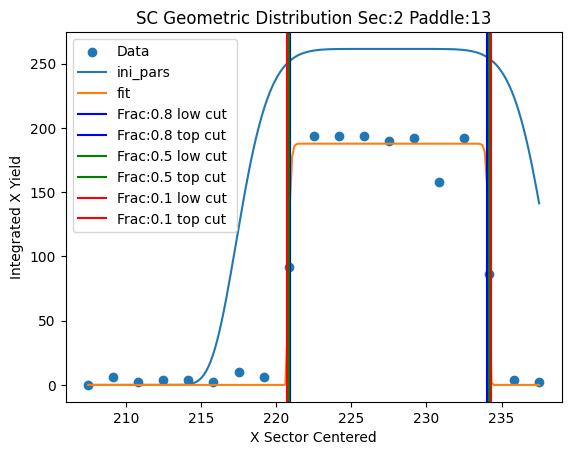

Parameters for Sec:2 Paddle:14
test pars [187.71428576 241.49579331   7.23336785  71.60176587]
fit pars [166.7570233  241.38833922   5.01866767  10.59509263]


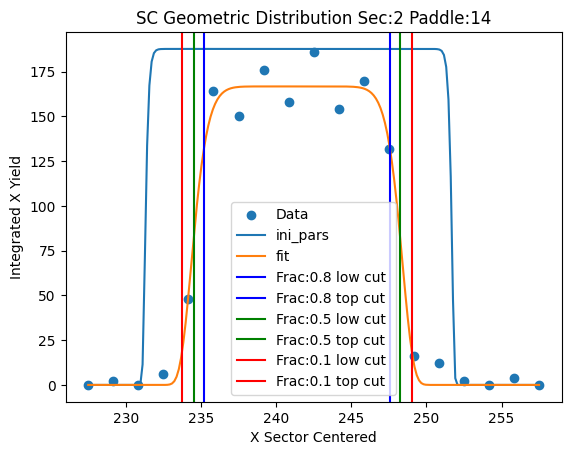

Parameters for Sec:2 Paddle:15
test pars [166.7570233  255.38833922   7.51866767  10.59509263]
fit pars [144.28916011 254.93777114   5.11120977   5.2561023 ]


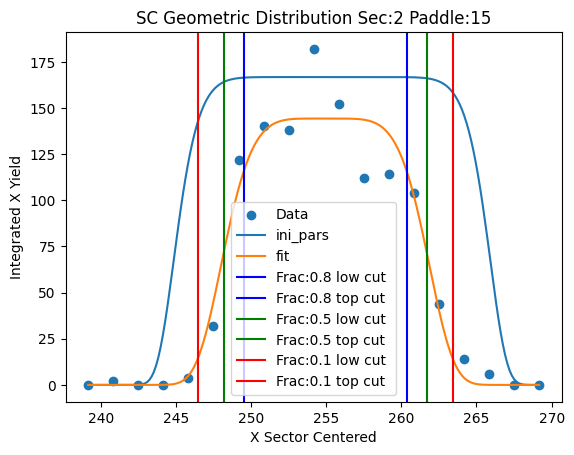

Parameters for Sec:2 Paddle:16
test pars [144.28916011 268.93777114   7.61120977   5.2561023 ]
fit pars [126.45553795 269.01250904   5.21590772   8.81842222]


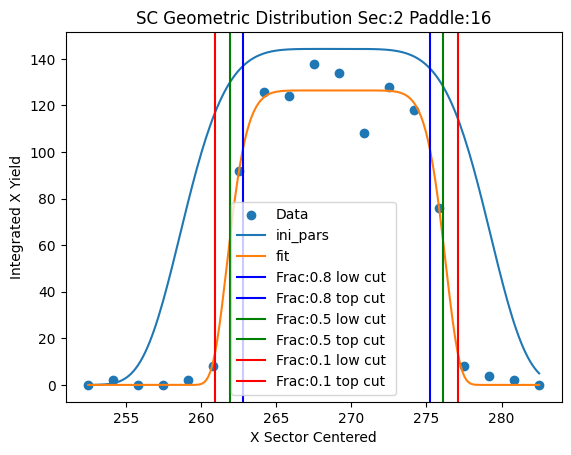

Parameters for Sec:2 Paddle:17
test pars [126.45553795 283.01250904   7.71590772   8.81842222]
fit pars [106.04303683 282.57237592   5.12691876   7.91356333]


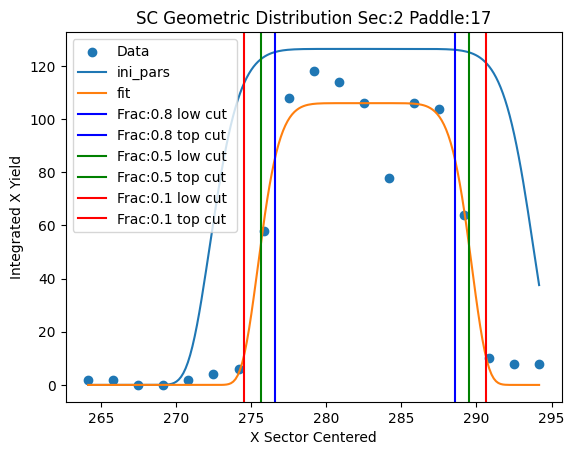

Parameters for Sec:2 Paddle:18
test pars [106.04303683 296.57237592   7.62691876   7.91356333]
fit pars [ 79.77633278 296.52770791   5.07149051   9.97888271]


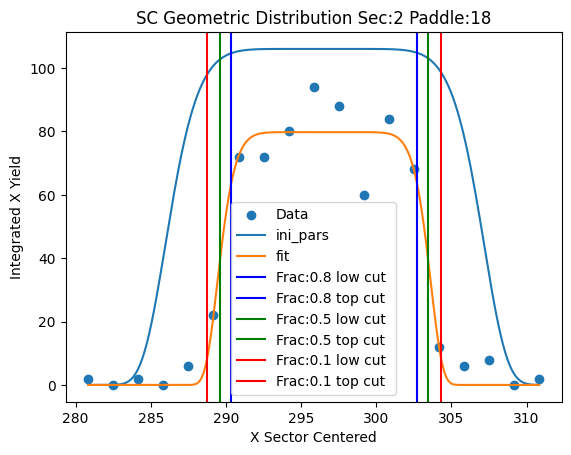

Parameters for Sec:2 Paddle:19
test pars [ 79.77633278 310.52770791   7.57149051   9.97888271]
fit pars [ 69.89699031 309.9142105    4.88994819   6.59503241]


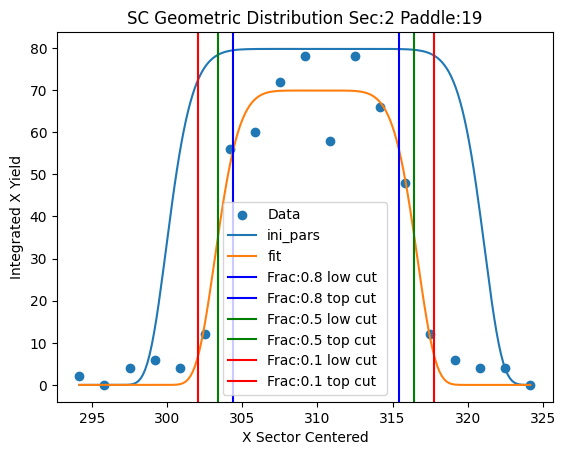

Parameters for Sec:2 Paddle:20
test pars [ 69.89699031 323.9142105    7.38994819   6.59503241]
fit pars [ 73.36826436 323.9636678    5.30430794   5.22492365]


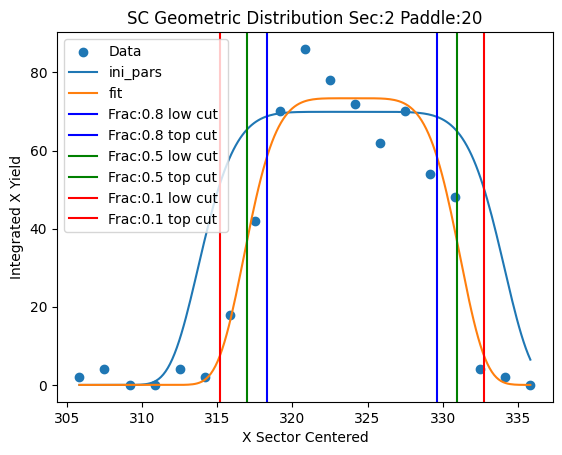

Parameters for Sec:2 Paddle:21
test pars [ 73.36826436 337.9636678    7.80430794   5.22492365]
fit pars [ 60.65208125 338.01518907   4.90965188   6.44526069]


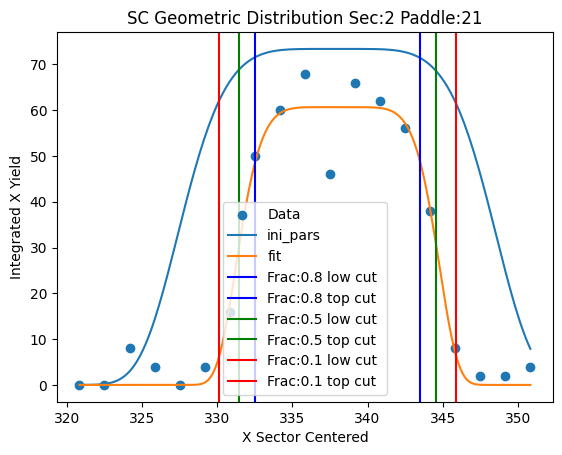

Parameters for Sec:2 Paddle:22
test pars [ 60.65208125 352.01518907   7.40965188   6.44526069]
fit pars [ 40.06203478 351.6407967    5.27297319  20.69308654]


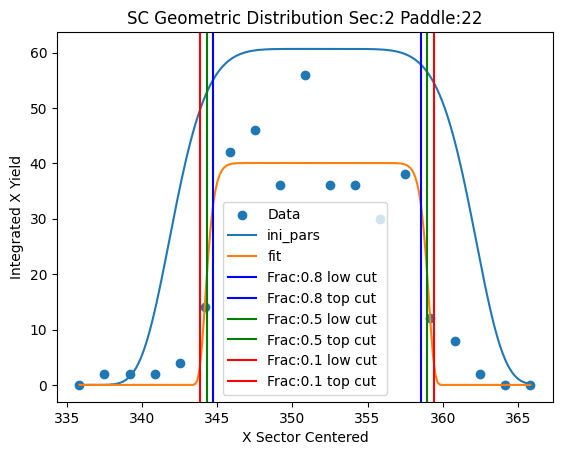

Runtime Error


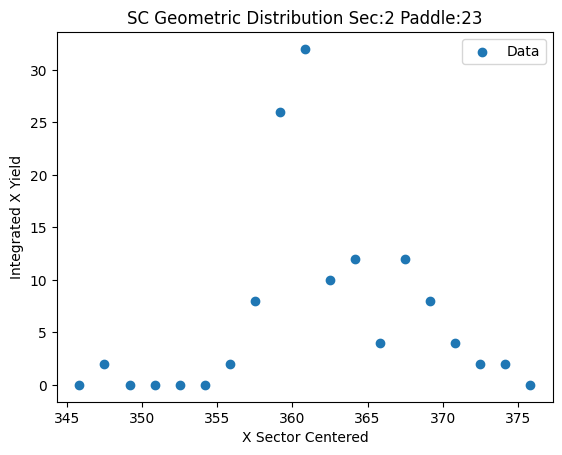

Runtime Error


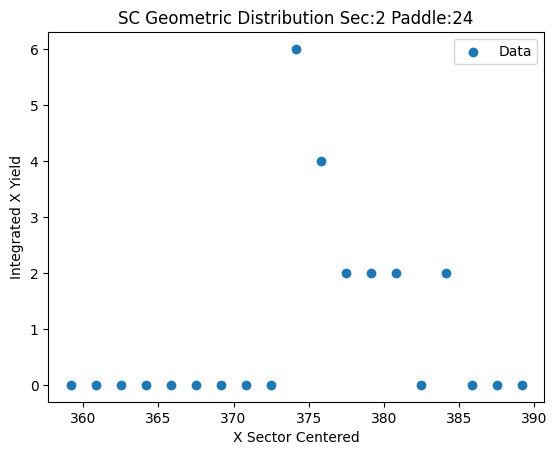

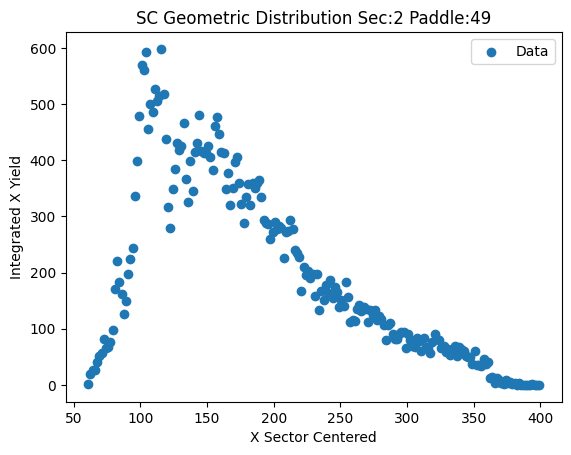

Parameters for Sec:3 Paddle:2
test pars [250.   75.    5.4   4. ]
fit pars [150.28571448  77.44979849   4.74782854  64.48038049]


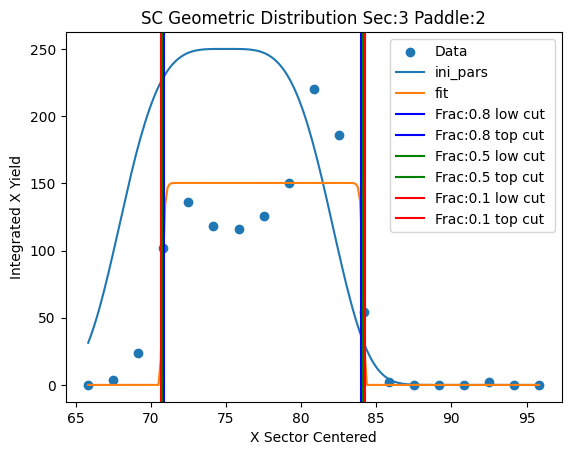

Parameters for Sec:3 Paddle:3
test pars [150.28571448  91.44979849   7.24782854  64.48038049]
fit pars [236.00206311  90.5433059    5.1973294    8.76011377]


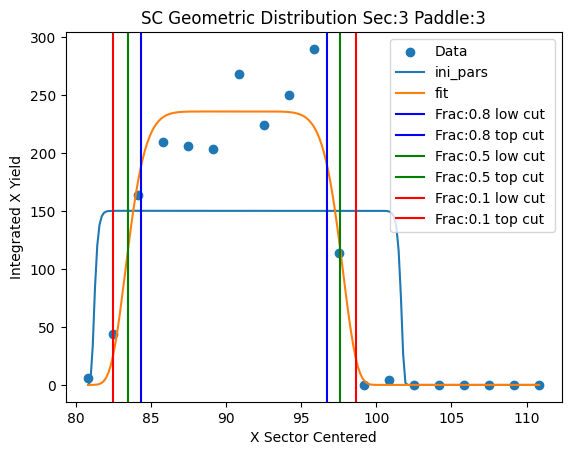

Parameters for Sec:3 Paddle:4
test pars [236.00206311 104.5433059    7.6973294    8.76011377]
fit pars [480.29952541 104.36602513   4.98556825   8.65015932]


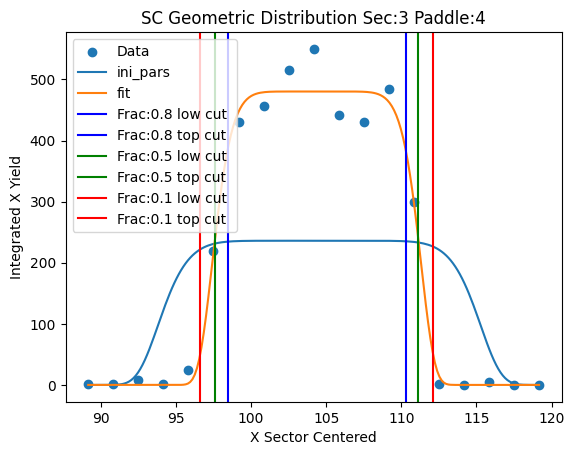

Parameters for Sec:3 Paddle:5
test pars [480.29952541 118.36602513   7.48556825   8.65015932]
fit pars [589.85810165 117.42936979   4.88378546   5.52181894]


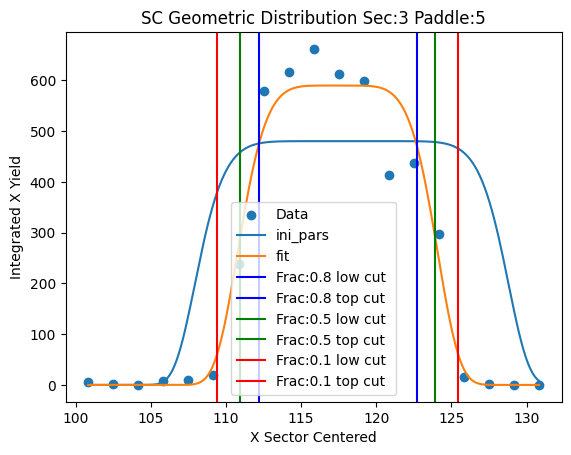

Parameters for Sec:3 Paddle:6
test pars [589.85810165 131.42936979   7.38378546   5.52181894]
fit pars [485.18269077 131.64790921   4.91001691   9.1381994 ]


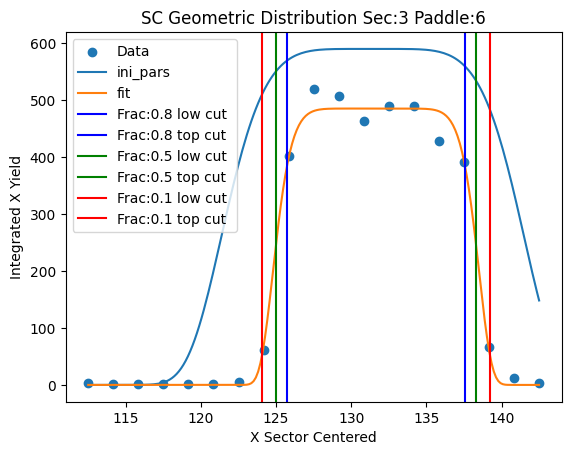

Parameters for Sec:3 Paddle:7
test pars [485.18269077 145.64790921   7.41001691   9.1381994 ]
fit pars [395.46235331 145.21234067   5.0986359   11.30288212]


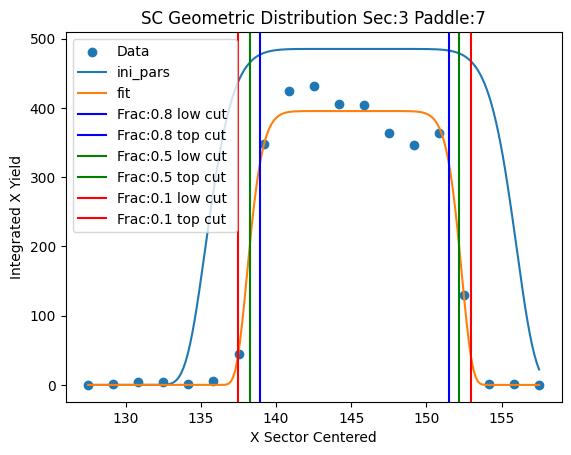

Parameters for Sec:3 Paddle:8
test pars [395.46235331 159.21234067   7.5986359   11.30288212]
fit pars [426.46845053 158.93413183   5.06284447   6.55643472]


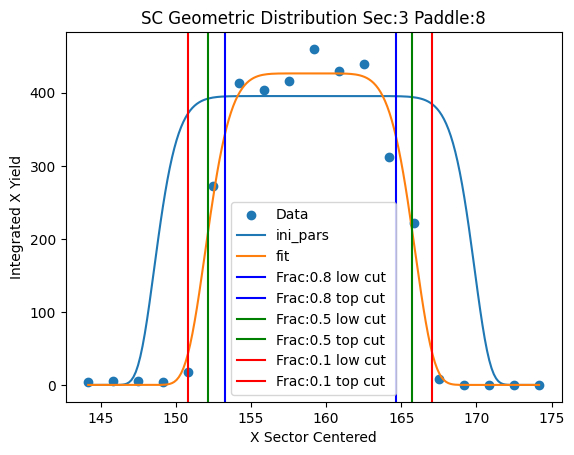

Parameters for Sec:3 Paddle:9
test pars [426.46845053 172.93413183   7.56284447   6.55643472]
fit pars [359.98429305 172.72485855   4.83224032  16.24623351]


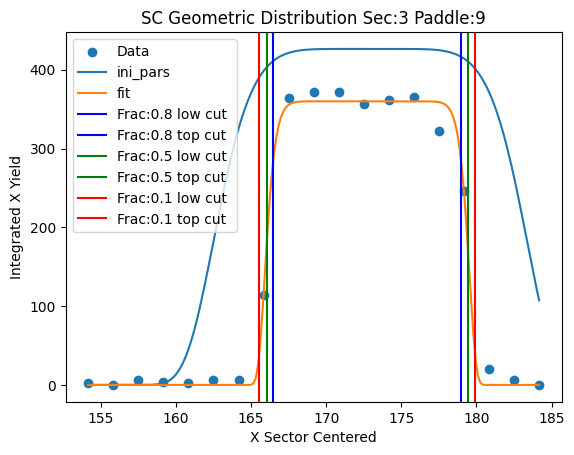

Parameters for Sec:3 Paddle:10
test pars [359.98429305 186.72485855   7.33224032  16.24623351]
fit pars [308.79498357 186.72015344   5.07640826  10.9272242 ]


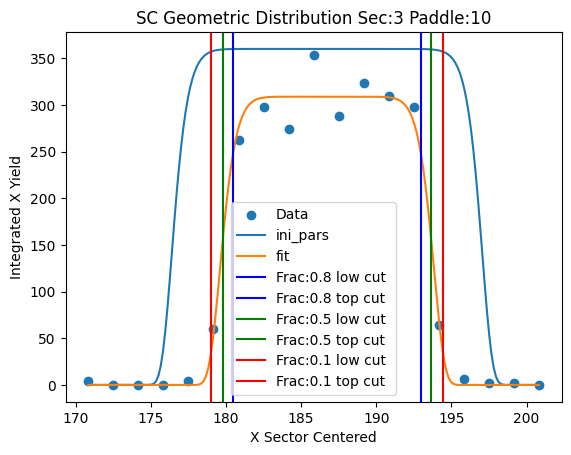

Parameters for Sec:3 Paddle:11
test pars [308.79498357 200.72015344   7.57640826  10.9272242 ]
fit pars [279.1215733  200.26381836   5.07813359  12.1951291 ]


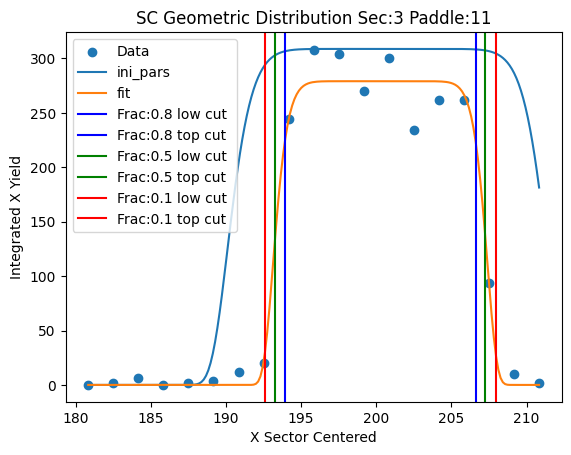

Parameters for Sec:3 Paddle:12
test pars [279.1215733  214.26381836   7.57813359  12.1951291 ]
fit pars [225.40526053 213.95639896   4.87597097   8.33249164]


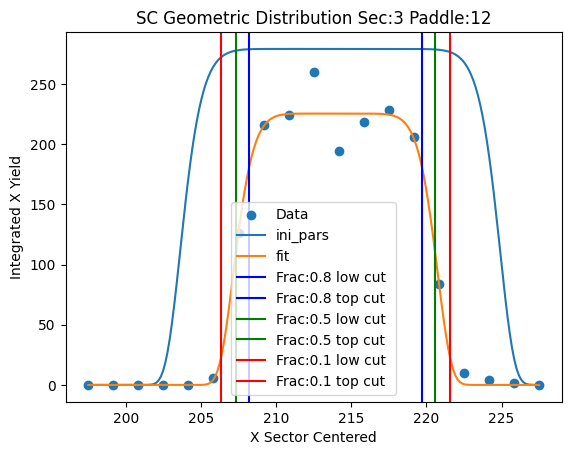

Parameters for Sec:3 Paddle:13
test pars [225.40526053 227.95639896   7.37597097   8.33249164]
fit pars [177.95105103 227.66728586   5.2192732    9.79288491]


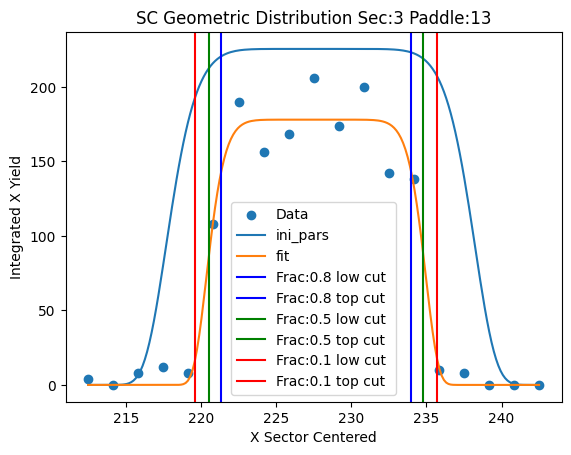

Parameters for Sec:3 Paddle:14
test pars [177.95105103 241.66728586   7.7192732    9.79288491]
fit pars [155.50000073 241.65457722   5.2724174   72.34960851]


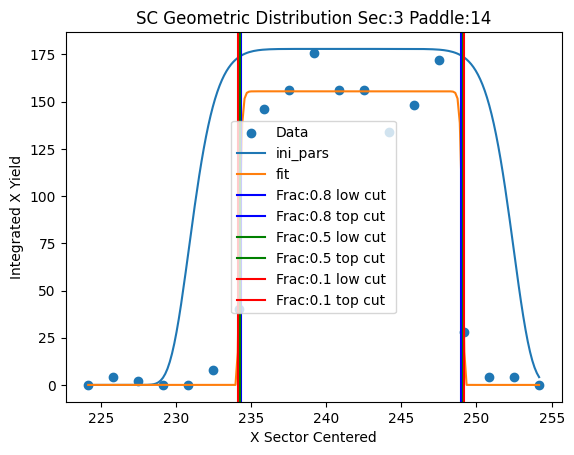

Parameters for Sec:3 Paddle:15
test pars [155.50000073 255.65457722   7.7724174   72.34960851]
fit pars [144.47945394 255.35499207   5.20336571  12.45923752]


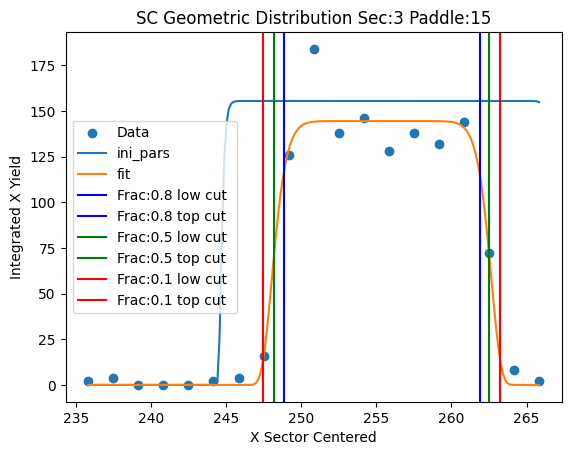

Parameters for Sec:3 Paddle:16
test pars [144.47945394 269.35499207   7.70336571  12.45923752]
fit pars [122.98608562 269.05810408   5.21331874   6.22157508]


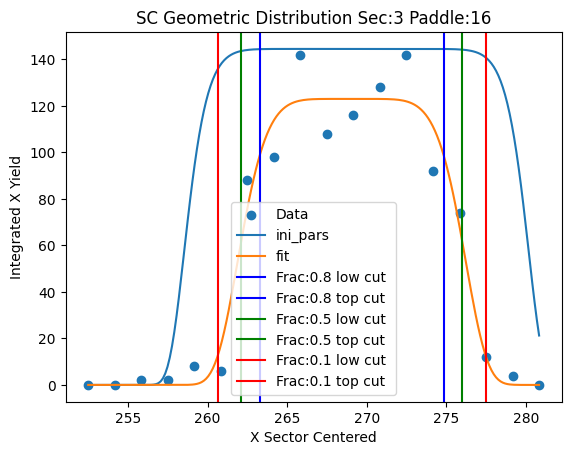

Parameters for Sec:3 Paddle:17
test pars [122.98608562 283.05810408   7.71331874   6.22157508]
fit pars [ 88.28571451 282.59887204   4.78755195  62.40374028]


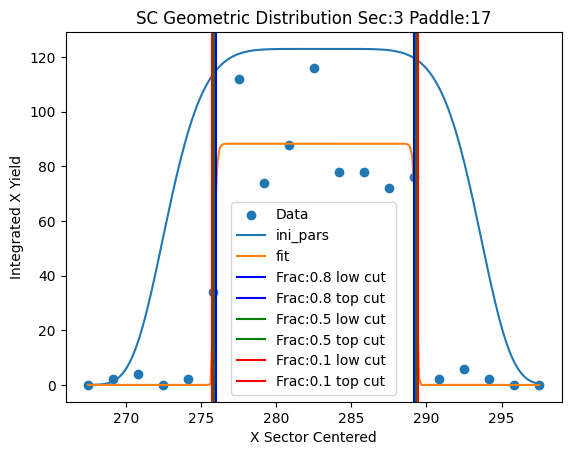

Parameters for Sec:3 Paddle:18
test pars [ 88.28571451 296.59887204   7.28755195  62.40374028]
fit pars [ 81.14285716 295.92035525   4.7282455   74.17879933]


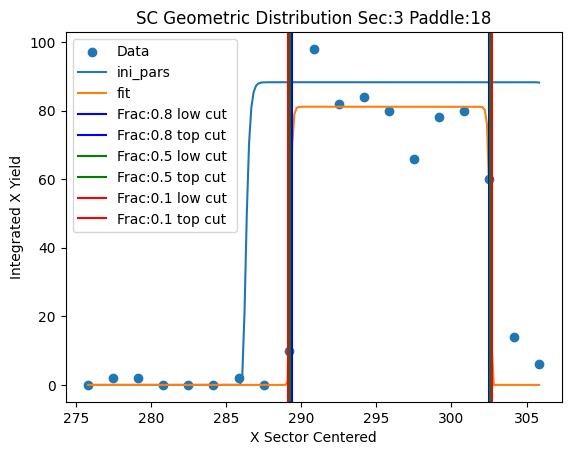

Parameters for Sec:3 Paddle:19
test pars [ 81.14285716 309.92035525   7.2282455   74.17879933]
fit pars [ 73.42608782 310.06809679   5.11384404  10.47320316]


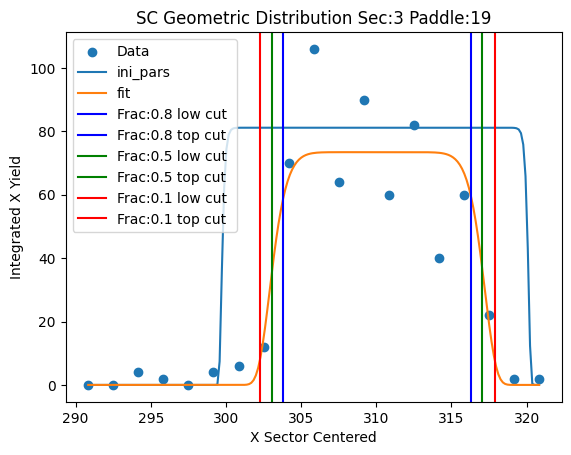

Parameters for Sec:3 Paddle:20
test pars [ 73.42608782 324.06809679   7.61384404  10.47320316]
fit pars [ 63.01175843 324.02767822   5.09666542   6.1750011 ]


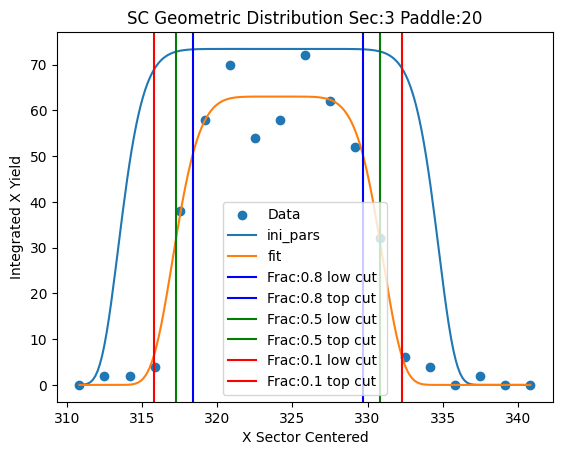

Parameters for Sec:3 Paddle:21
test pars [ 63.01175843 338.02767822   7.59666542   6.1750011 ]
fit pars [ 59.23653373 338.01509305   5.07945523   7.85246524]


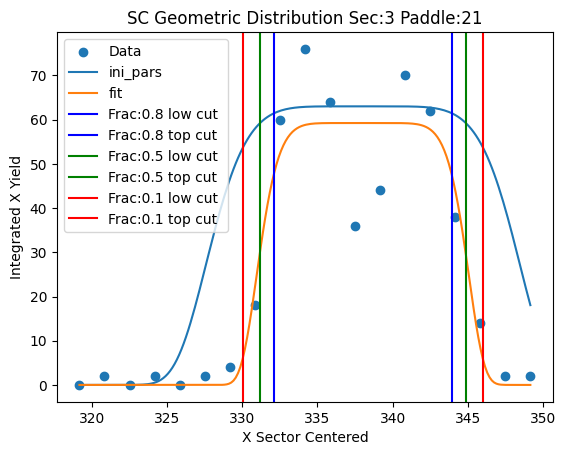

Parameters for Sec:3 Paddle:22
test pars [ 59.23653373 352.01509305   7.57945523   7.85246524]
fit pars [ 43.50532749 351.00035149   4.62472258  19.70117459]


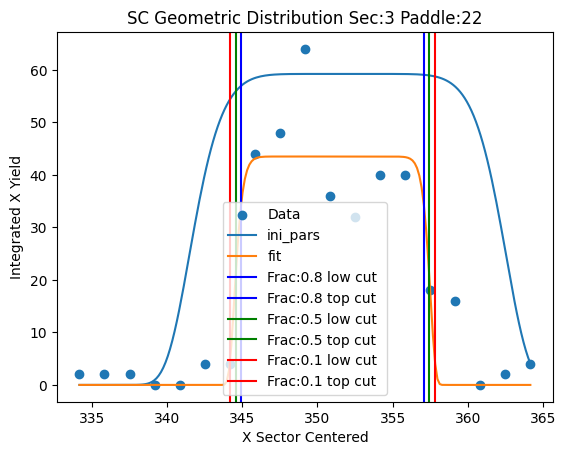

Parameters for Sec:3 Paddle:23
test pars [ 43.50532749 365.00035149   7.12472258  19.70117459]
fit pars [ 8.52631581e+00  3.69095139e+02  1.18354649e-02 -1.05091875e+02]


/opt/homebrew/lib/python3.10/site-packages/scipy/optimize/_minpack_py.py:1010: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


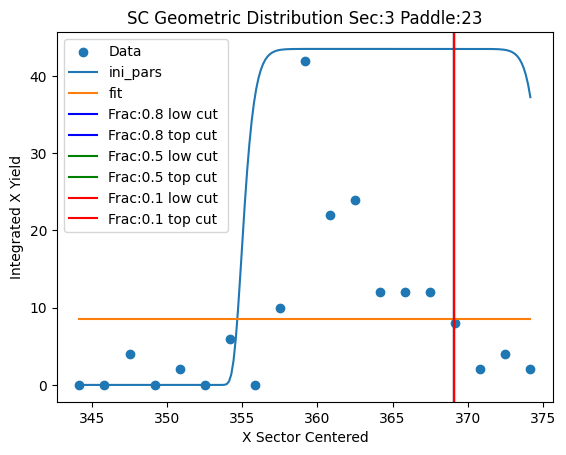

Parameters for Sec:3 Paddle:24
test pars [   8.52631581  383.09513936    2.51183546 -105.09187522]
fit pars [9.09090898e-01 2.54457980e+02 8.47627358e+01 3.40889657e+04]


/var/folders/9h/zwsh0vf94zxdp3tw1qp_dcjw0000gn/T/ipykernel_63477/2664612452.py:3: RuntimeWarning: overflow encountered in double_scalars
  return 0.5*(2*m_ - 2 * (math.log(1./frac_)**(1./p_))*(2**(p_/2.)*(1./s_)**(-p_))**(1./p_))
/var/folders/9h/zwsh0vf94zxdp3tw1qp_dcjw0000gn/T/ipykernel_63477/2664612452.py:5: RuntimeWarning: overflow encountered in double_scalars
  return 0.5*(2*m_ + 2 * (math.log(1./frac_)**(1./p_))*(2**(p_/2.)*(1./s_)**(-p_))**(1./p_))


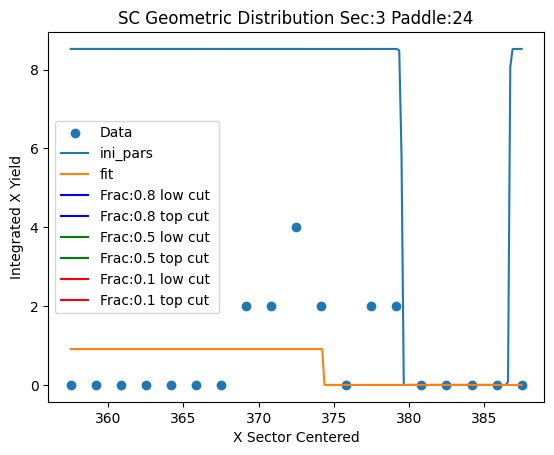

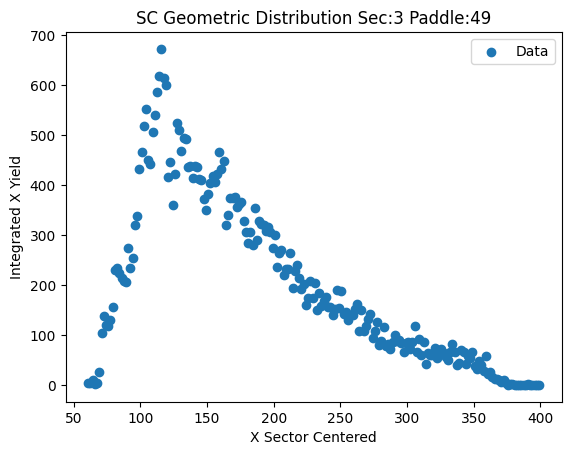

Parameters for Sec:4 Paddle:2
test pars [250.   75.    5.4   4. ]
fit pars [134.73466697  75.54734573   6.19460894   6.55424226]


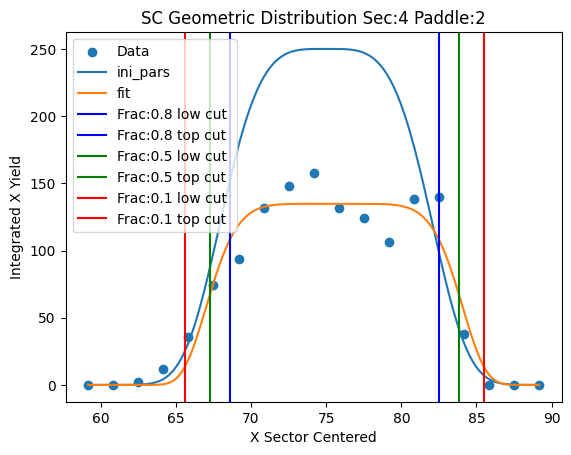

Parameters for Sec:4 Paddle:3
test pars [134.73466697  89.54734573   8.69460894   6.55424226]
fit pars [223.17457738  90.47752272   5.13572337  11.07154406]


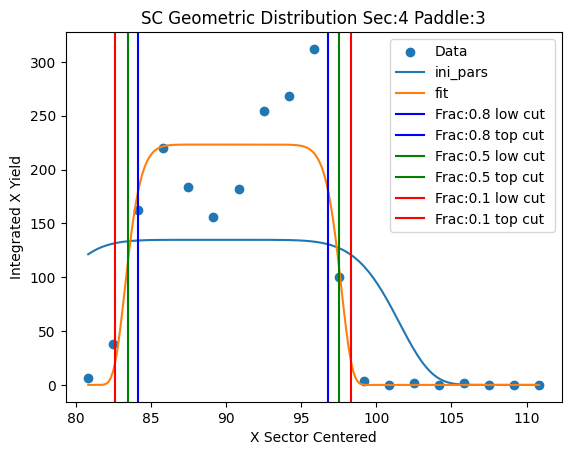

Parameters for Sec:4 Paddle:4
test pars [223.17457738 104.47752272   7.63572337  11.07154406]
fit pars [499.33633521 104.43775736   4.98230814   5.76697919]


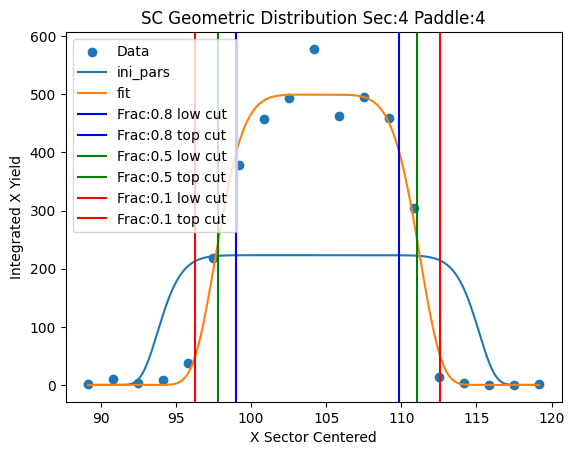

Parameters for Sec:4 Paddle:5
test pars [499.33633521 118.43775736   7.48230814   5.76697919]
fit pars [606.16418761 117.87452272   4.9921698    7.84169035]


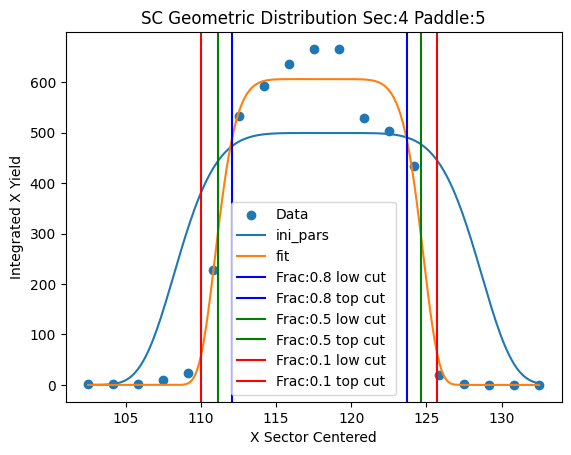

Parameters for Sec:4 Paddle:6
test pars [606.16418761 131.87452272   7.4921698    7.84169035]
fit pars [494.15551447 131.58743047   4.91796177   9.25998368]


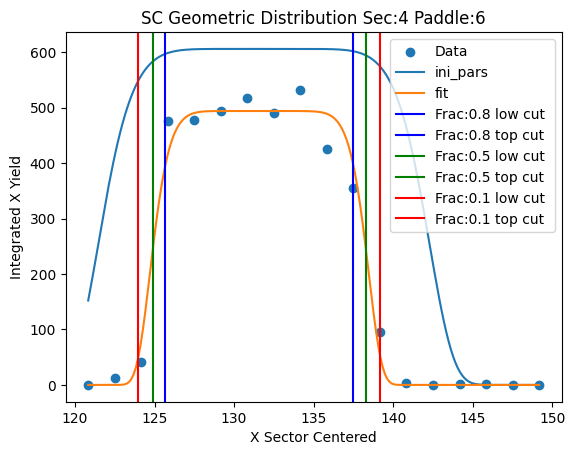

Parameters for Sec:4 Paddle:7
test pars [494.15551447 145.58743047   7.41796177   9.25998368]
fit pars [409.75577511 145.59236462   5.01478198   6.9895535 ]


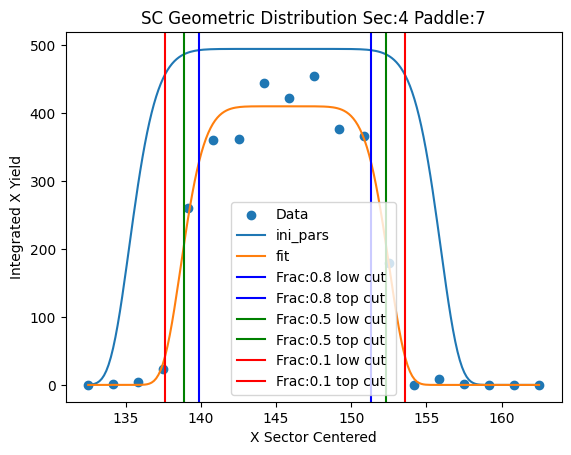

Parameters for Sec:4 Paddle:8
test pars [409.75577511 159.59236462   7.51478198   6.9895535 ]
fit pars [365.75857275 159.39347933   5.0984915   10.32009144]


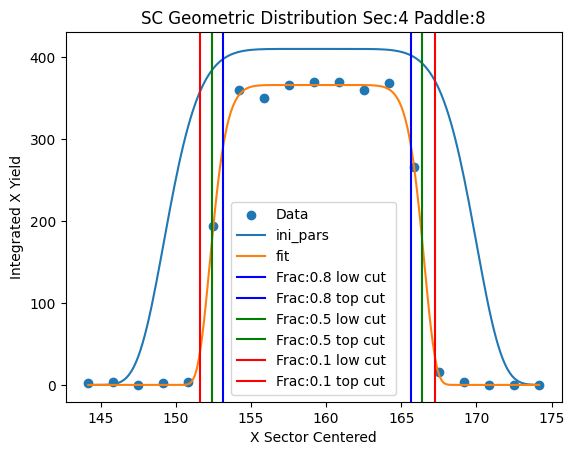

Parameters for Sec:4 Paddle:9
test pars [365.75857275 173.39347933   7.5984915   10.32009144]
fit pars [330.39830872 173.21051189   5.10284184  15.41622137]


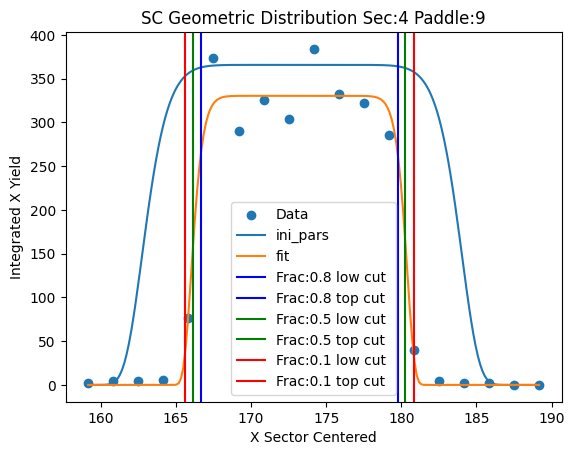

Parameters for Sec:4 Paddle:10
test pars [330.39830872 187.21051189   7.60284184  15.41622137]
fit pars [302.17326986 186.96061671   5.01399358  12.49212575]


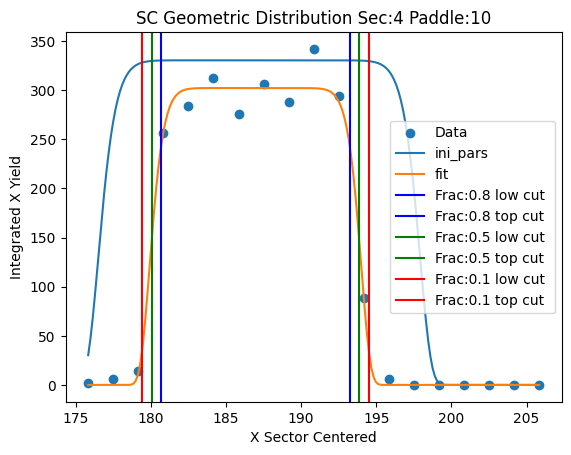

Parameters for Sec:4 Paddle:11
test pars [302.17326986 200.96061671   7.51399358  12.49212575]
fit pars [259.16826207 200.9592844    5.24987792   9.36170062]


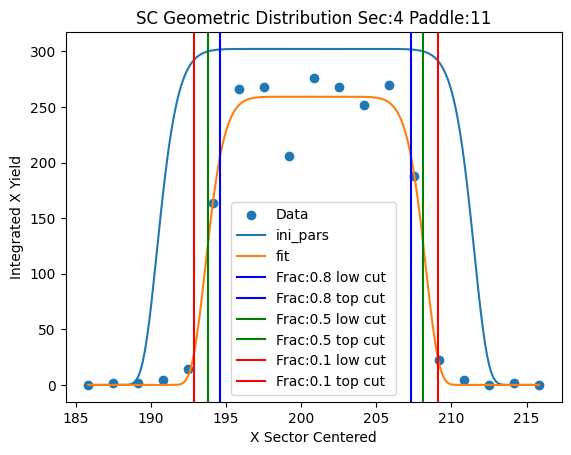

Parameters for Sec:4 Paddle:12
test pars [259.16826207 214.9592844    7.74987792   9.36170062]
fit pars [208.28571465 214.24145434   4.76244958  64.23566336]


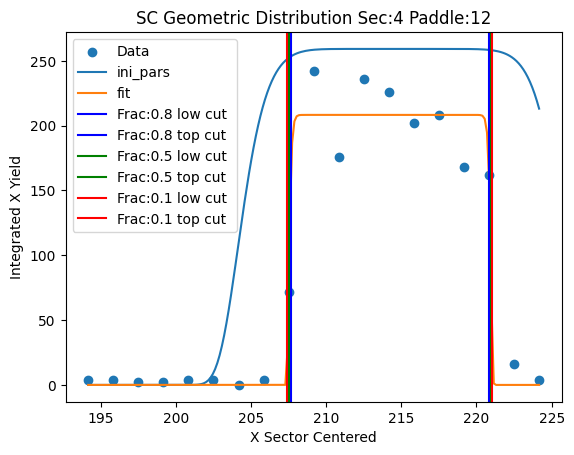

Parameters for Sec:4 Paddle:13
test pars [208.28571465 228.24145434   7.26244958  64.23566336]
fit pars [169.45066577 228.49745219   5.08020759  11.23692381]


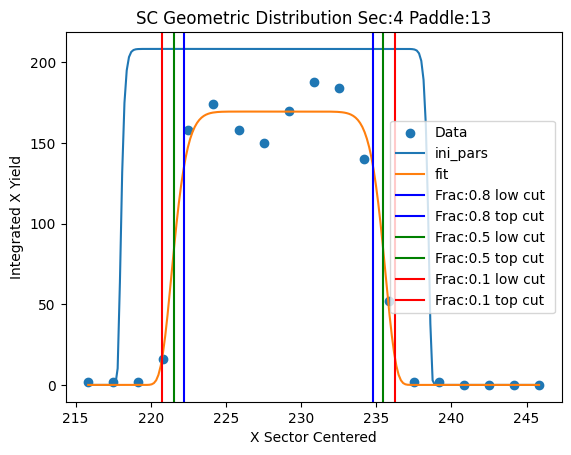

Parameters for Sec:4 Paddle:14
test pars [169.45066577 242.49745219   7.58020759  11.23692381]
fit pars [142.83682354 241.98795687   5.18853818  22.95835385]


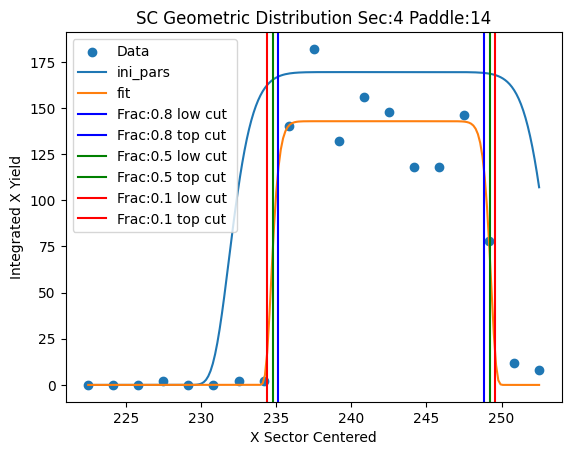

Parameters for Sec:4 Paddle:15
test pars [142.83682354 255.98795687   7.68853818  22.95835385]
fit pars [125.14285714 255.8787521    4.75317824  87.90280859]


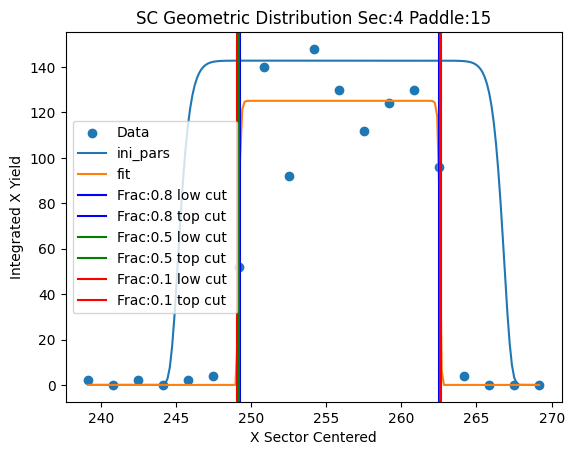

Parameters for Sec:4 Paddle:16
test pars [125.14285714 269.8787521    7.25317824  87.90280859]
fit pars [ 93.65770184 269.78713251   5.19930752  14.37199189]


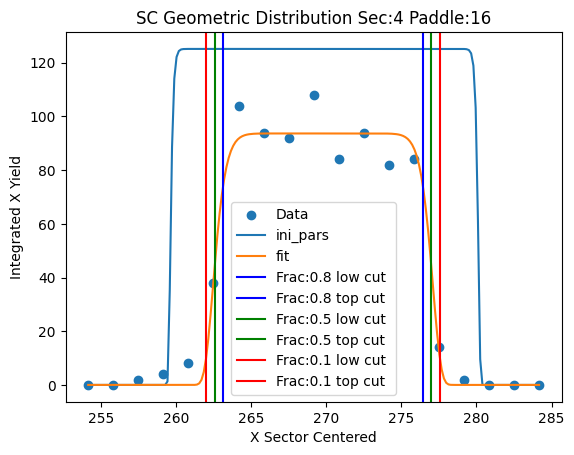

Parameters for Sec:4 Paddle:17
test pars [ 93.65770184 283.78713251   7.69930752  14.37199189]
fit pars [ 86.75000001 283.36937347   5.29298969  89.16836062]


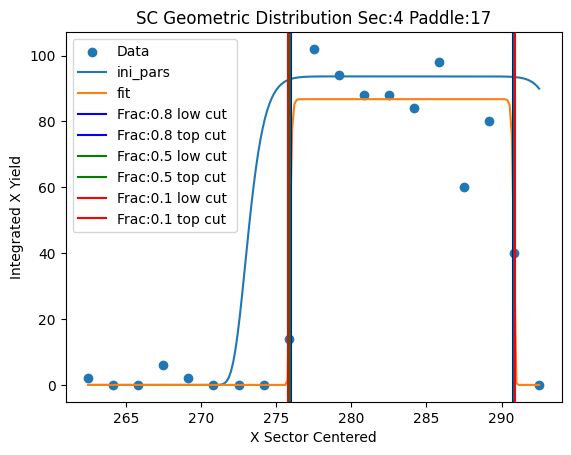

Parameters for Sec:4 Paddle:18
test pars [ 86.75000001 297.36937347   7.79298969  89.16836062]
fit pars [ 90.06733791 296.99678716   4.67453528   3.60227701]


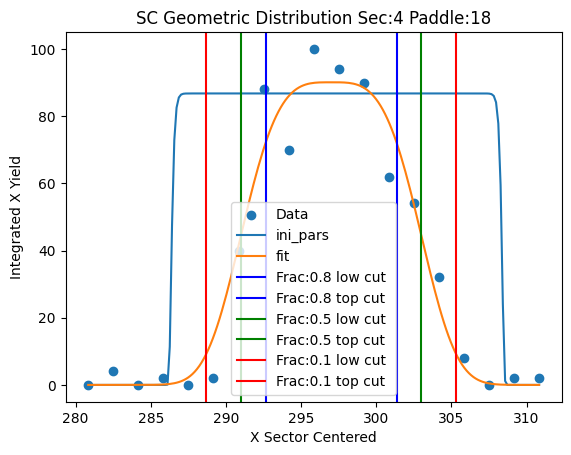

Parameters for Sec:4 Paddle:19
test pars [ 90.06733791 310.99678716   7.17453528   3.60227701]
fit pars [ 59.42857567 310.90350716   4.79018969  51.18936424]


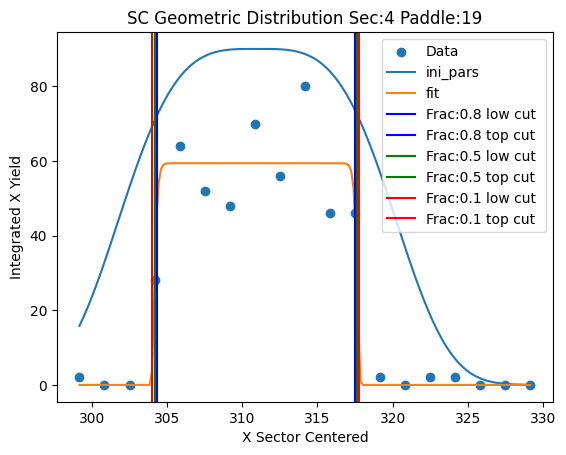

Parameters for Sec:4 Paddle:20
test pars [ 59.42857567 324.90350716   7.29018969  51.18936424]
fit pars [ 49.75000004 324.98260999   5.27509479  78.8320501 ]


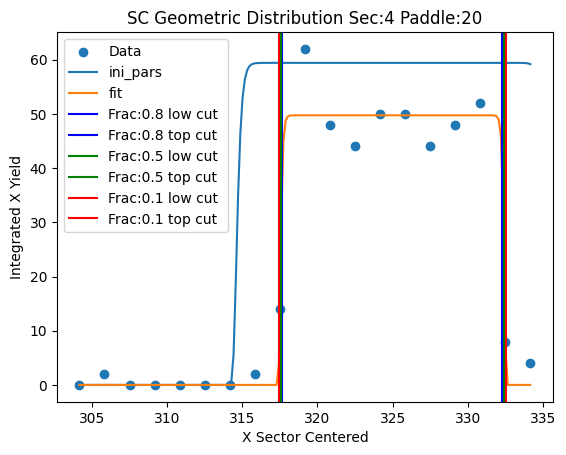

Parameters for Sec:4 Paddle:21
test pars [ 49.75000004 338.98260999   7.77509479  78.8320501 ]
fit pars [ 40.28571434 339.16666667   4.77675987  62.48156264]


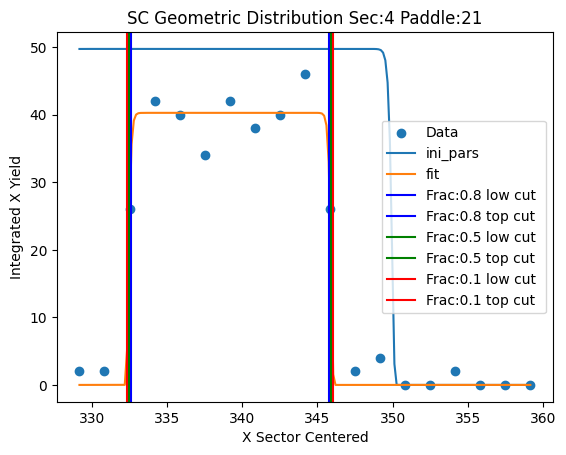

Parameters for Sec:4 Paddle:22
test pars [ 40.28571434 353.16666667   7.27675987  62.48156264]
fit pars [ 35.76857432 352.08492573   5.04376418   5.91909719]


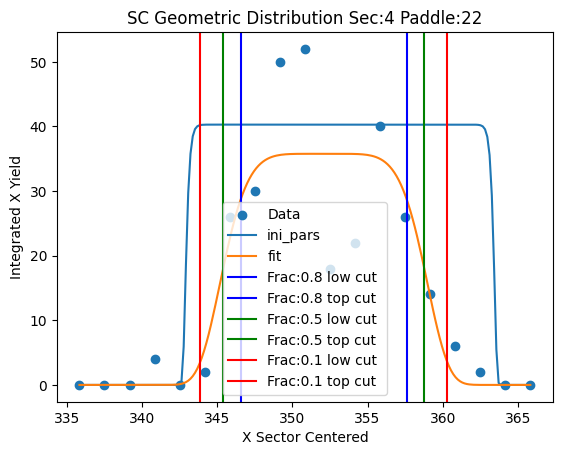

Parameters for Sec:4 Paddle:23
test pars [ 35.76857432 366.08492573   7.54376418   5.91909719]
fit pars [ 22.39233992 362.13893524   2.09513148   4.0020075 ]


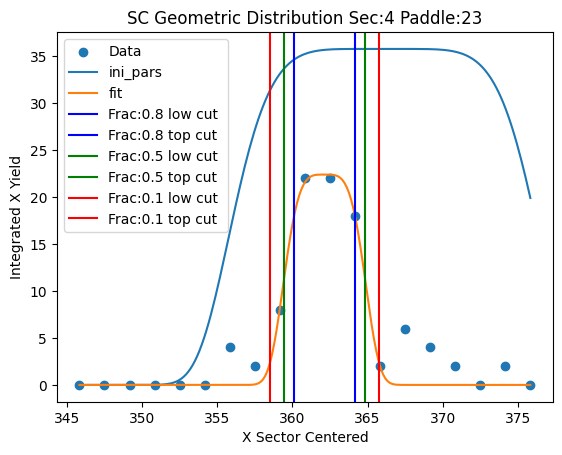

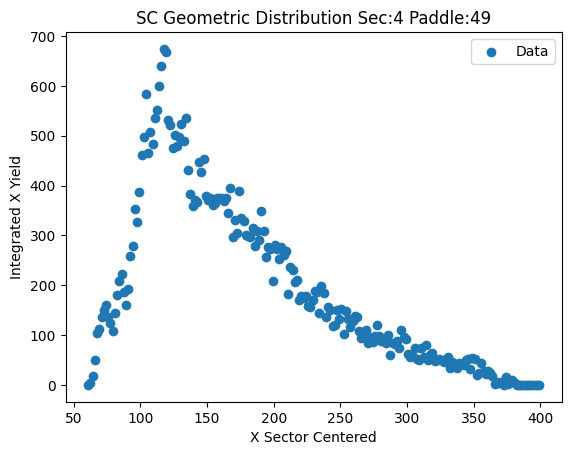

Parameters for Sec:5 Paddle:2
test pars [250.   75.    5.4   4. ]
fit pars [78.43255453 76.2553515   5.97768518  8.02090966]


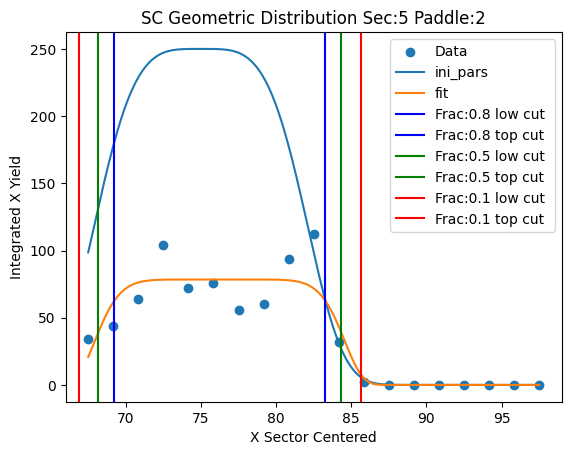

Parameters for Sec:5 Paddle:3
test pars [78.43255453 90.2553515   8.47768518  8.02090966]
fit pars [350.04051396  93.87955368   2.868839     1.14987035]


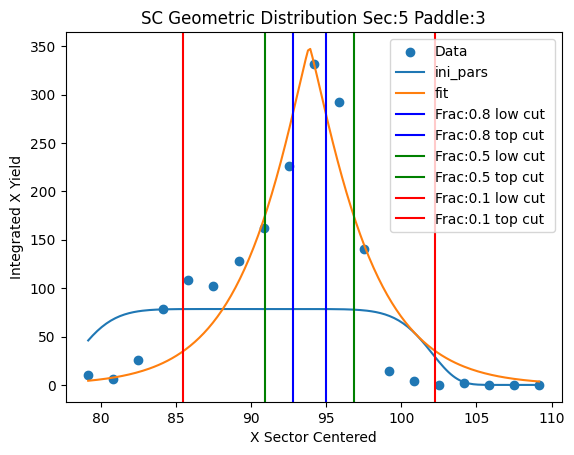

Parameters for Sec:5 Paddle:4
test pars [350.04051396 107.87955368   5.368839     1.14987035]
fit pars [285.44330256 104.51408135   5.28627477   7.44440408]


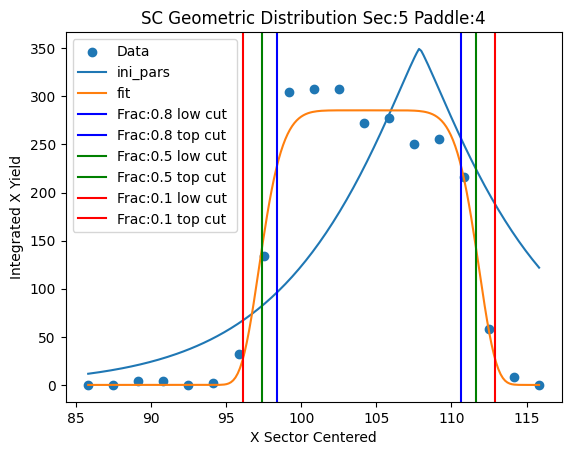

Parameters for Sec:5 Paddle:5
test pars [285.44330256 118.51408135   7.78627477   7.44440408]
fit pars [420.47497649 118.33426511   4.97518074   8.14080083]


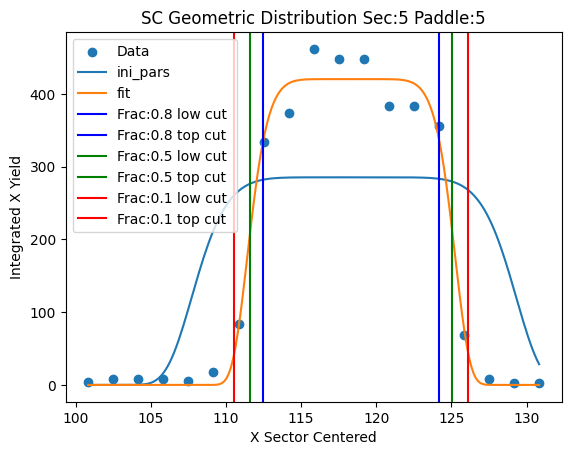

Parameters for Sec:5 Paddle:6
test pars [420.47497649 132.33426511   7.47518074   8.14080083]
fit pars [444.73572247 131.95267547   5.12302745   8.1481513 ]


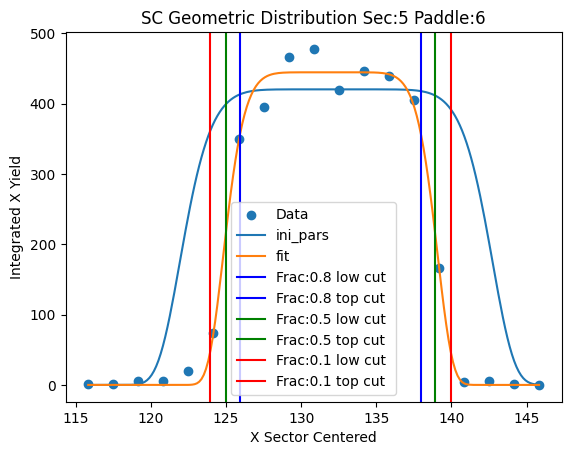

Parameters for Sec:5 Paddle:7
test pars [444.73572247 145.95267547   7.62302745   8.1481513 ]
fit pars [422.81401542 145.61606387   4.93522363   7.59782908]


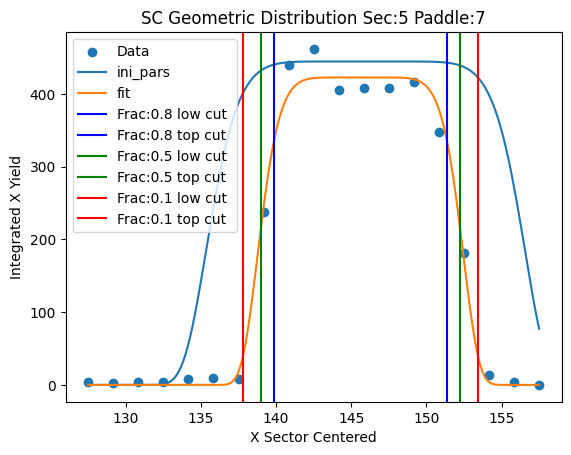

Parameters for Sec:5 Paddle:8
test pars [422.81401542 159.61606387   7.43522363   7.59782908]
fit pars [350.94809597 159.55668935   5.02497562   7.65261481]


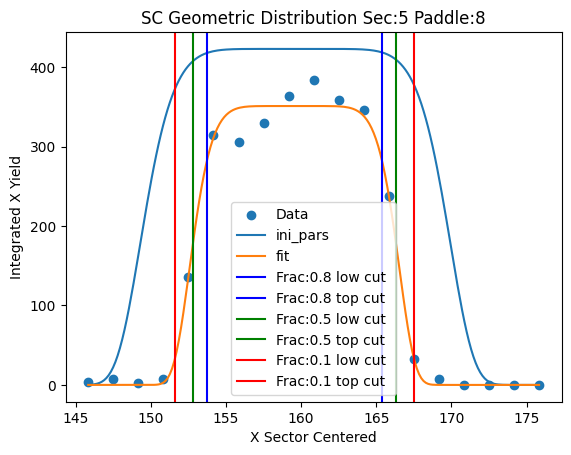

Parameters for Sec:5 Paddle:9
test pars [350.94809597 173.55668935   7.52497562   7.65261481]
fit pars [345.89053176 173.43365698   5.1708001   14.06882838]


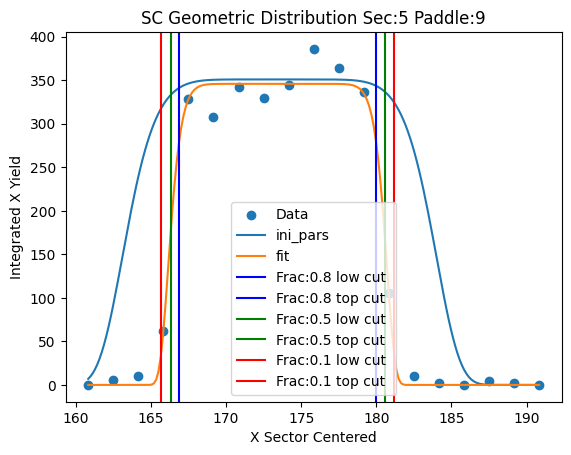

Parameters for Sec:5 Paddle:10
test pars [345.89053176 187.43365698   7.6708001   14.06882838]
fit pars [318.83325181 187.04786292   5.11923743  12.66696677]


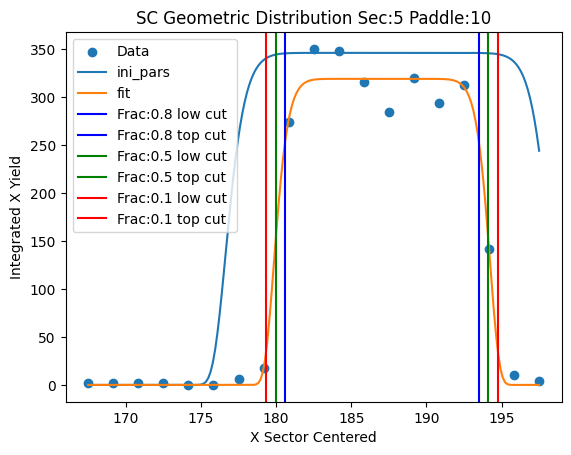

Parameters for Sec:5 Paddle:11
test pars [318.83325181 201.04786292   7.61923743  12.66696677]
fit pars [252.96524429 201.07949438   5.17867434   9.31465718]


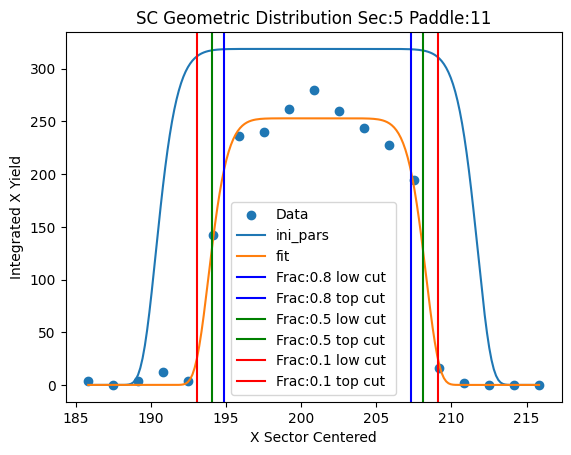

Parameters for Sec:5 Paddle:12
test pars [252.96524429 215.07949438   7.67867434   9.31465718]
fit pars [213.87145412 214.95407825   5.1115497   14.98922742]


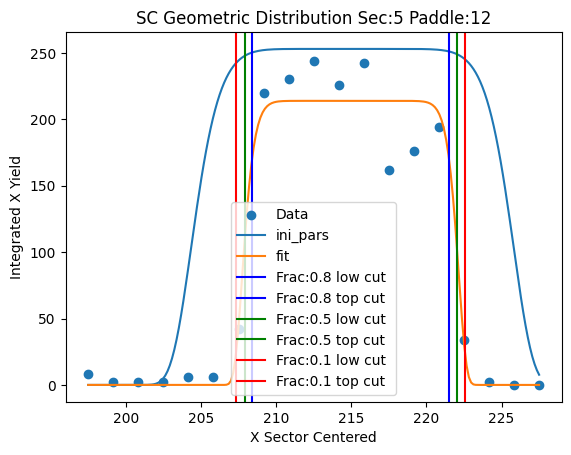

Parameters for Sec:5 Paddle:13
test pars [213.87145412 228.95407825   7.6115497   14.98922742]
fit pars [170.60384246 228.59776297   5.10973882  10.01213699]


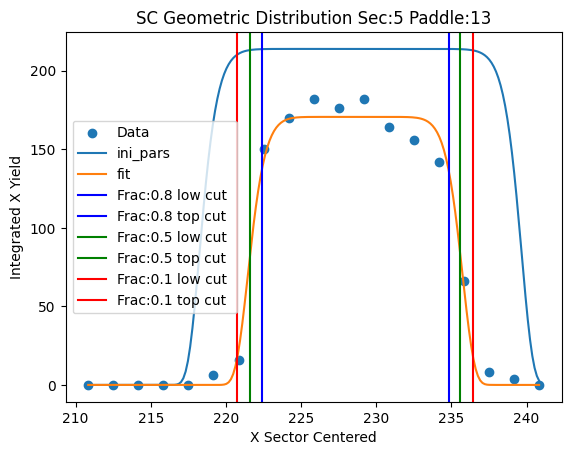

Parameters for Sec:5 Paddle:14
test pars [170.60384246 242.59776297   7.60973882  10.01213699]
fit pars [152.85714297 242.49799522   4.75188838  66.66846367]


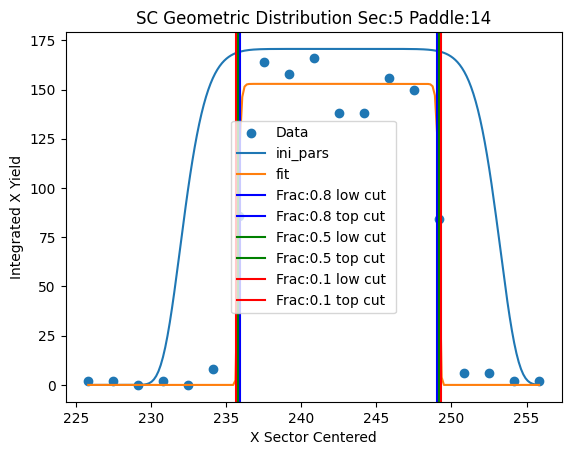

Parameters for Sec:5 Paddle:15
test pars [152.85714297 256.49799522   7.25188838  66.66846367]
fit pars [124.00000036 256.61341562   5.2755233   74.90444297]


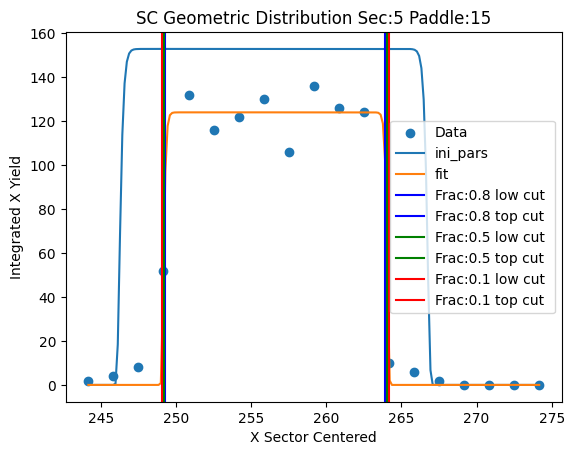

Parameters for Sec:5 Paddle:16
test pars [124.00000036 270.61341562   7.7755233   74.90444297]
fit pars [109.9412973  270.38770974   5.07416909  11.58259722]


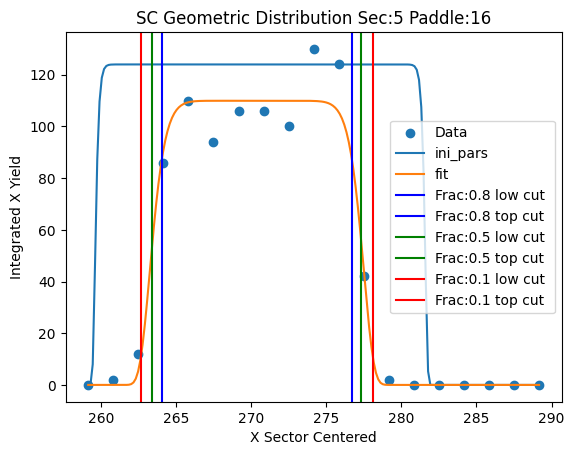

Parameters for Sec:5 Paddle:17
test pars [109.9412973  284.38770974   7.57416909  11.58259722]
fit pars [ 87.42857145 284.17340703   4.7453605   67.00764113]


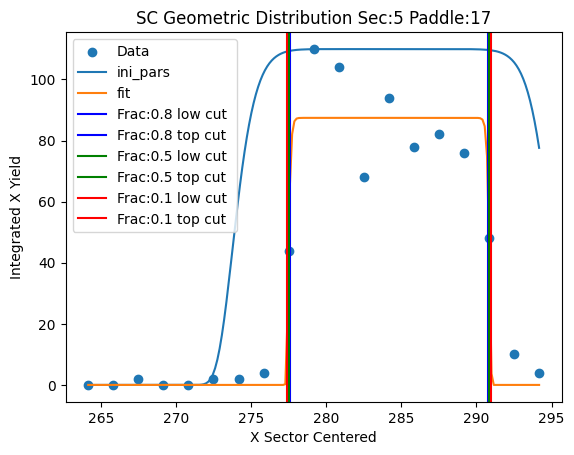

Parameters for Sec:5 Paddle:18
test pars [ 87.42857145 298.17340703   7.2453605   67.00764113]
fit pars [ 79.18882967 297.73002803   5.31504585  12.50892981]


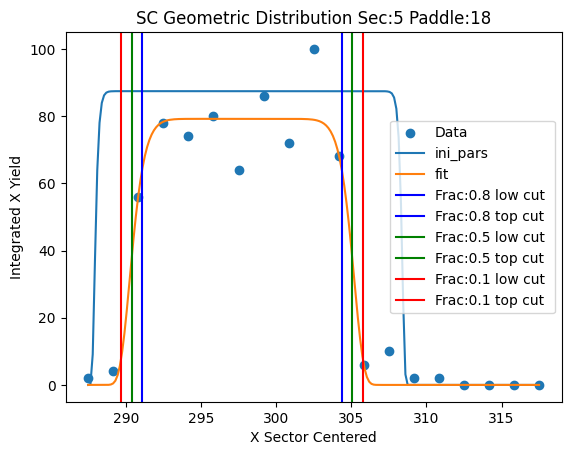

Parameters for Sec:5 Paddle:19
test pars [ 79.18882967 311.73002803   7.81504585  12.50892981]
fit pars [ 68.2857143  310.87628245   4.74680956  69.35911885]


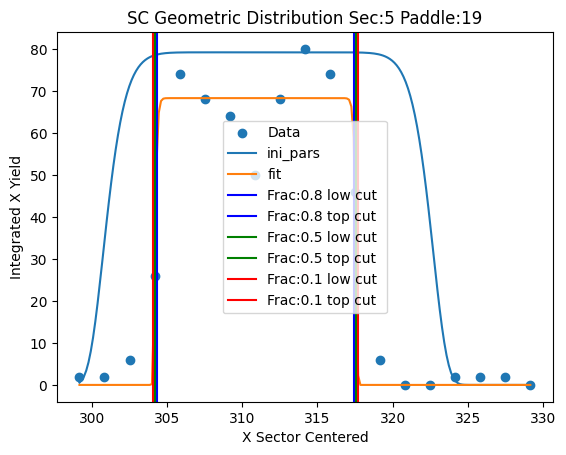

Parameters for Sec:5 Paddle:20
test pars [ 68.2857143  324.87628245   7.24680956  69.35911885]
fit pars [ 57.00000001 325.05828517   5.27085508  87.1075934 ]


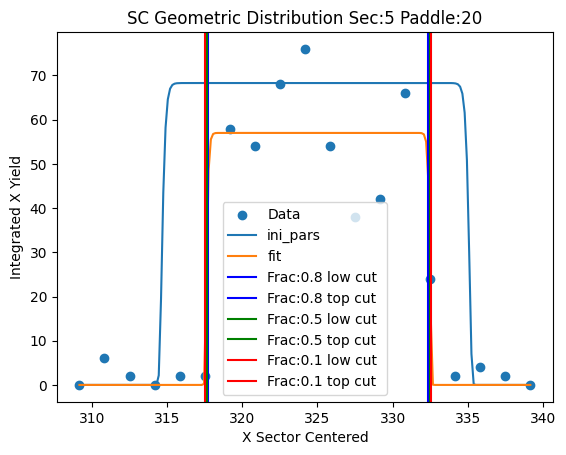

Parameters for Sec:5 Paddle:21
test pars [ 57.00000001 339.05828517   7.77085508  87.1075934 ]
fit pars [ 2.13684211e+01  5.29131946e+02  6.79443735e+01 -3.78327110e+04]


/var/folders/9h/zwsh0vf94zxdp3tw1qp_dcjw0000gn/T/ipykernel_63477/2664612452.py:3: RuntimeWarning: divide by zero encountered in double_scalars
  return 0.5*(2*m_ - 2 * (math.log(1./frac_)**(1./p_))*(2**(p_/2.)*(1./s_)**(-p_))**(1./p_))
/var/folders/9h/zwsh0vf94zxdp3tw1qp_dcjw0000gn/T/ipykernel_63477/2664612452.py:5: RuntimeWarning: divide by zero encountered in double_scalars
  return 0.5*(2*m_ + 2 * (math.log(1./frac_)**(1./p_))*(2**(p_/2.)*(1./s_)**(-p_))**(1./p_))


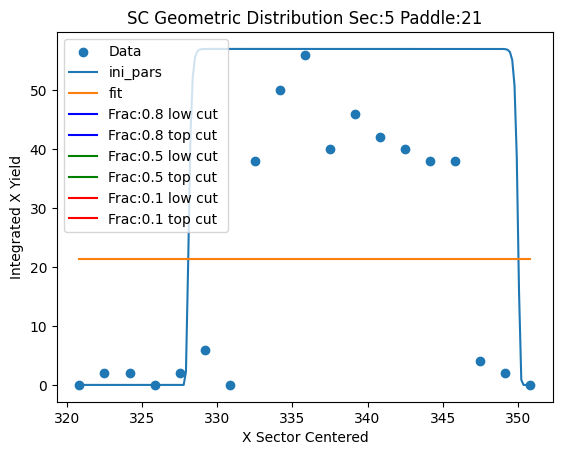

Parameters for Sec:5 Paddle:22
test pars [ 2.13684211e+01  5.43131946e+02  7.04443735e+01 -3.78327110e+04]
fit pars [ 1.93684211e+01  5.43131946e+02  7.04443735e+01 -3.78327110e+04]


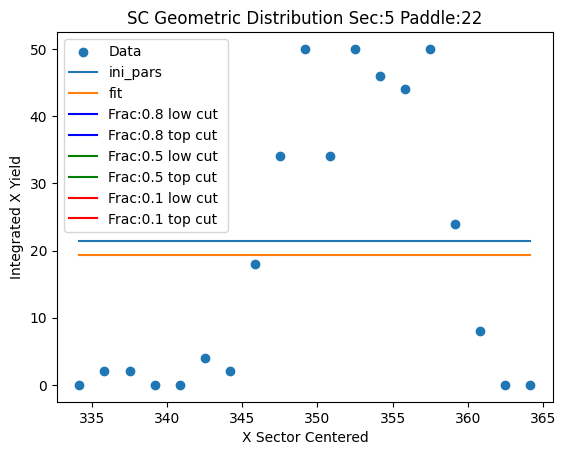

Parameters for Sec:5 Paddle:23
test pars [ 1.93684211e+01  5.57131946e+02  7.29443735e+01 -3.78327110e+04]
fit pars [ 4.84210528e+00  5.57131946e+02  7.29443735e+01 -3.78327110e+04]


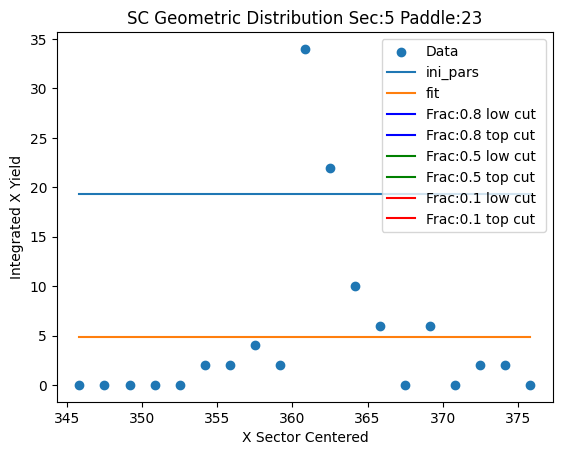

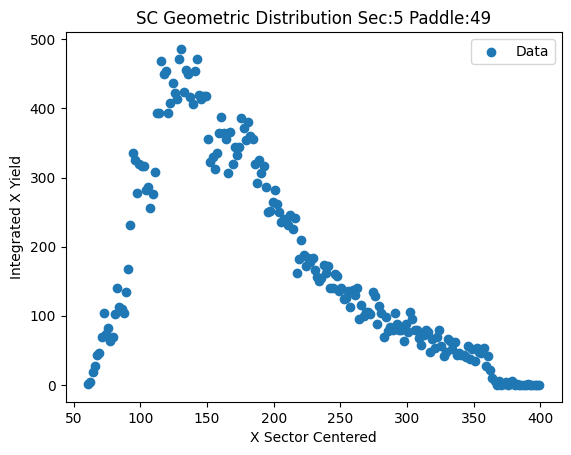

Parameters for Sec:6 Paddle:2
test pars [250.   75.    5.4   4. ]
fit pars [50.0000001  74.86958458  6.49259934 93.78593074]


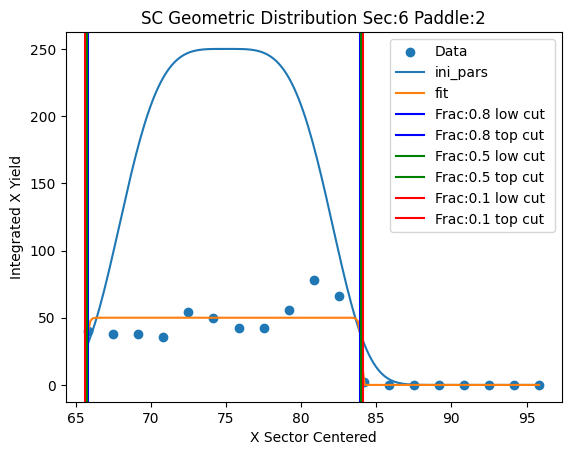

Parameters for Sec:6 Paddle:3
test pars [50.0000001  88.86958458  8.99259934 93.78593074]
fit pars [104.19999949  87.02876883   7.46299153 107.79744544]


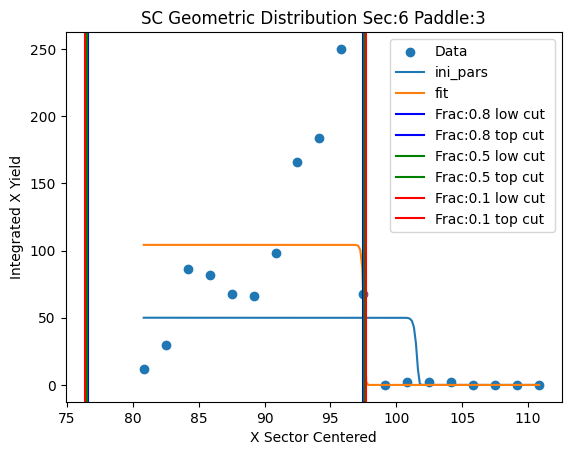

Parameters for Sec:6 Paddle:4
test pars [104.19999949 101.02876883   9.96299153 107.79744544]
fit pars [440.63194752 103.97740186   5.0308486    7.63518782]


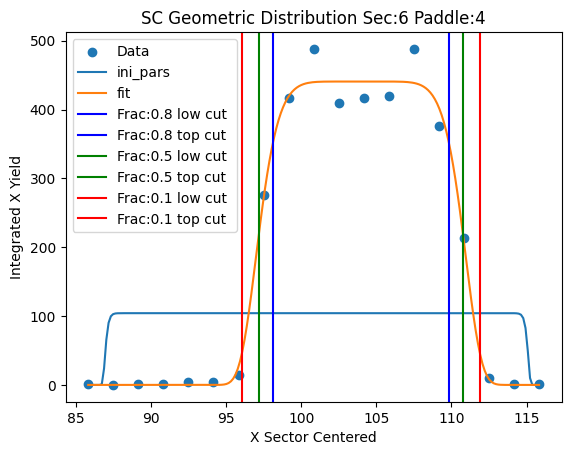

Parameters for Sec:6 Paddle:5
test pars [440.63194752 117.97740186   7.5308486    7.63518782]
fit pars [543.25812066 117.71975243   4.88963597   6.36306093]


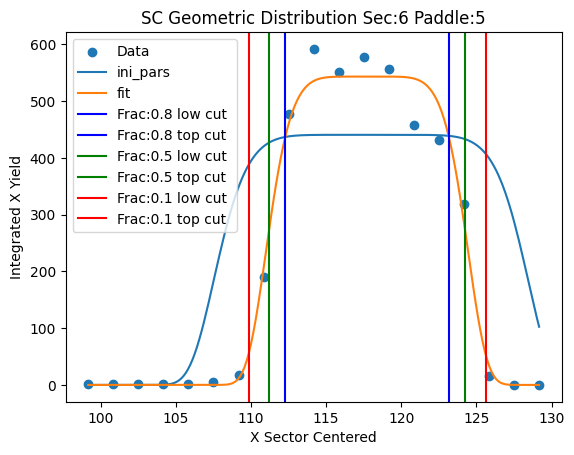

Parameters for Sec:6 Paddle:6
test pars [543.25812066 131.71975243   7.38963597   6.36306093]
fit pars [519.8776034  131.49159817   5.02827947   8.56918334]


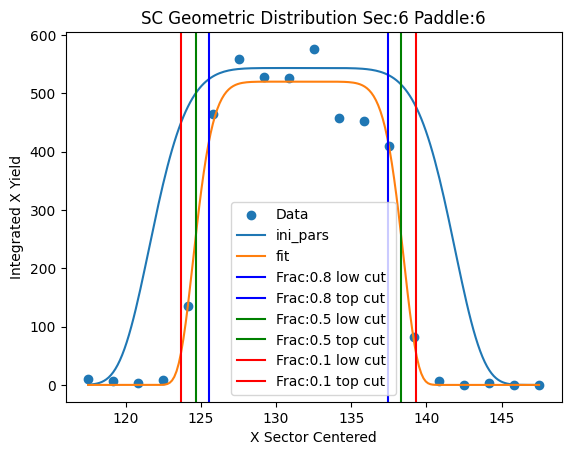

Parameters for Sec:6 Paddle:7
test pars [519.8776034  145.49159817   7.52827947   8.56918334]
fit pars [462.59373637 145.09282147   4.93603731   7.04413709]


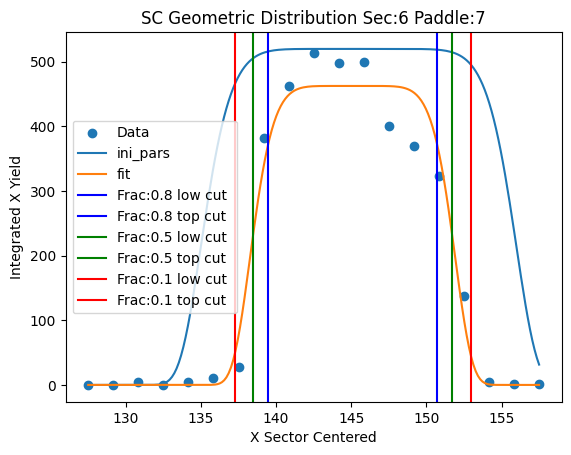

Parameters for Sec:6 Paddle:8
test pars [462.59373637 159.09282147   7.43603731   7.04413709]
fit pars [373.71428658 159.15056372   4.74906272  62.93814866]


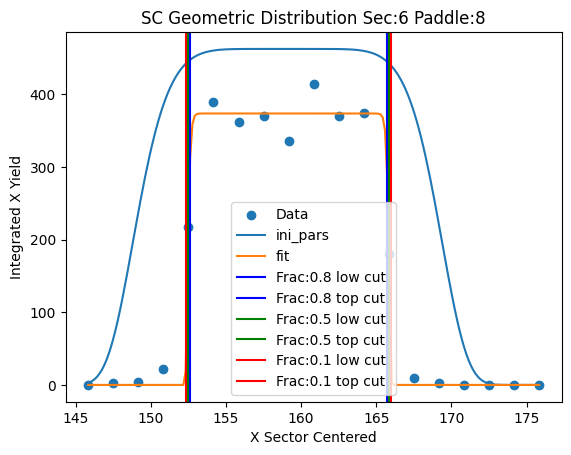

Parameters for Sec:6 Paddle:9
test pars [373.71428658 173.15056372   7.24906272  62.93814866]
fit pars [356.24260628 172.99792118   5.13098706  13.28808685]


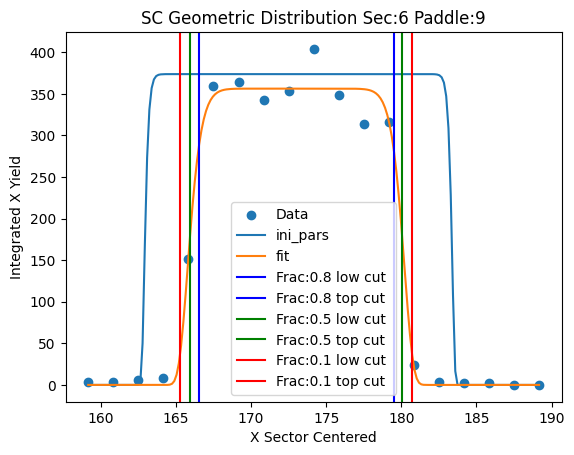

Parameters for Sec:6 Paddle:10
test pars [356.24260628 186.99792118   7.63098706  13.28808685]
fit pars [343.94502031 186.6574213    5.01131001  11.76212727]


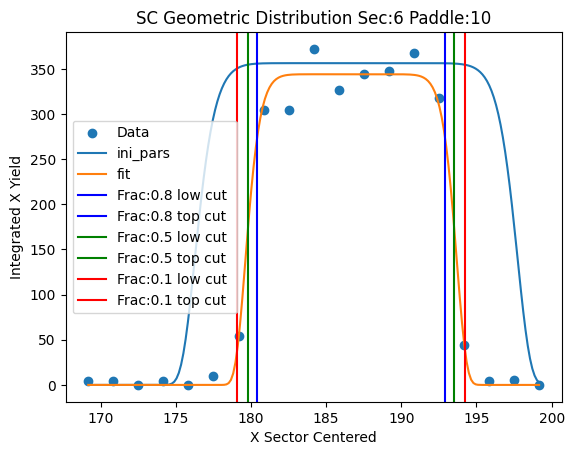

Parameters for Sec:6 Paddle:11
test pars [343.94502031 200.6574213    7.51131001  11.76212727]
fit pars [269.11812872 200.51798349   5.13090384  12.68752718]


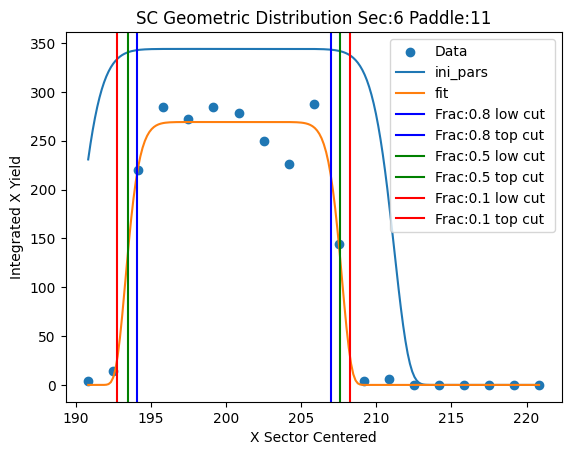

Parameters for Sec:6 Paddle:12
test pars [269.11812872 214.51798349   7.63090384  12.68752718]
fit pars [221.14285954 214.20505987   4.77111255  57.07245237]


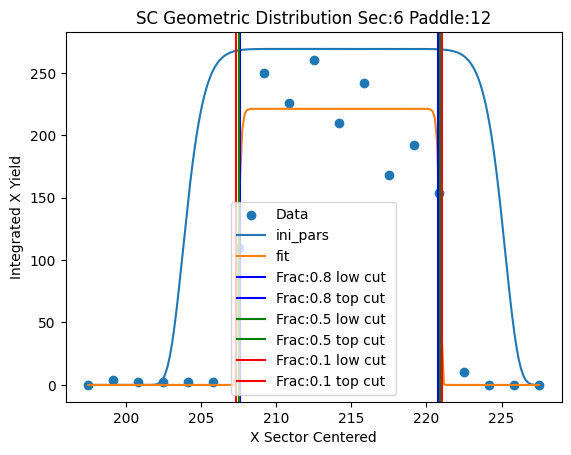

Parameters for Sec:6 Paddle:13
test pars [221.14285954 228.20505987   7.27111255  57.07245237]
fit pars [ 1.12829511e+02 -2.31533111e+03  1.68026150e+04 -1.15194145e+06]


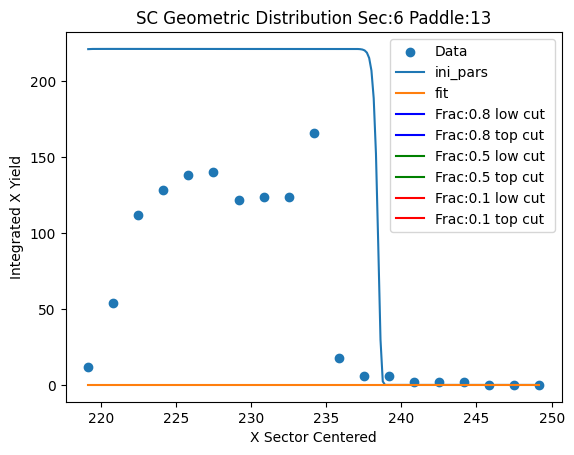

Parameters for Sec:6 Paddle:14
test pars [ 1.12829511e+02 -2.30133111e+03  1.68051150e+04 -1.15194145e+06]
fit pars [ 1.12829511e+02 -2.30133111e+03  1.68051150e+04 -1.15194145e+06]


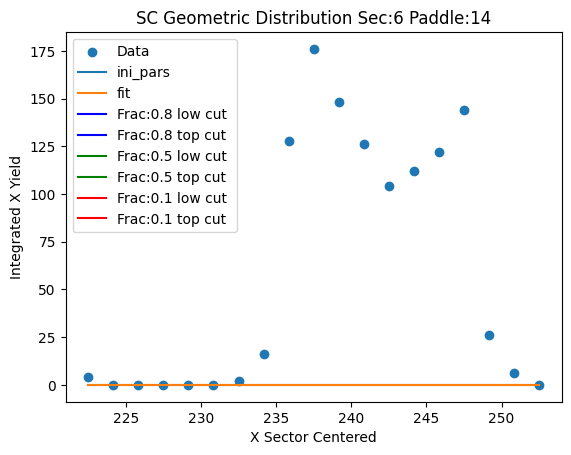

Parameters for Sec:6 Paddle:15
test pars [ 1.12829511e+02 -2.28733111e+03  1.68076150e+04 -1.15194145e+06]
fit pars [ 1.12829511e+02 -2.28733111e+03  1.68076150e+04 -1.15194145e+06]


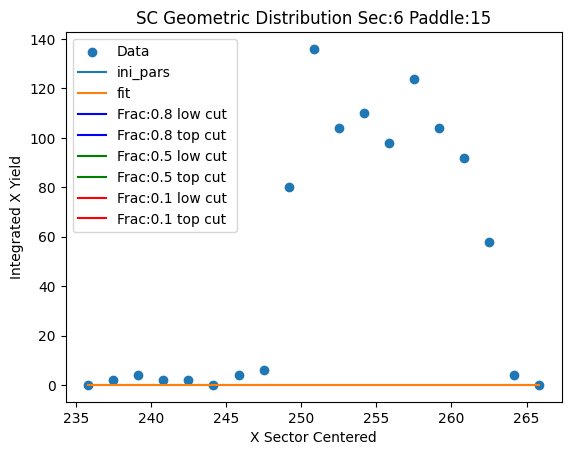

Parameters for Sec:6 Paddle:16
test pars [ 1.12829511e+02 -2.27333111e+03  1.68101150e+04 -1.15194145e+06]
fit pars [ 1.12829511e+02 -2.27333111e+03  1.68101150e+04 -1.15194145e+06]


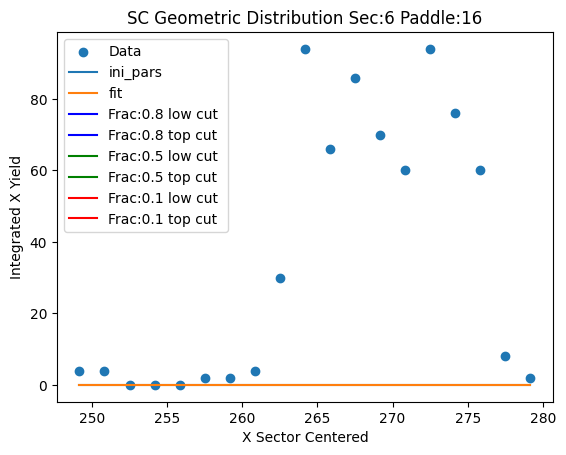

Parameters for Sec:6 Paddle:17
test pars [ 1.12829511e+02 -2.25933111e+03  1.68126150e+04 -1.15194145e+06]
fit pars [ 1.12829511e+02 -2.25933111e+03  1.68126150e+04 -1.15194145e+06]


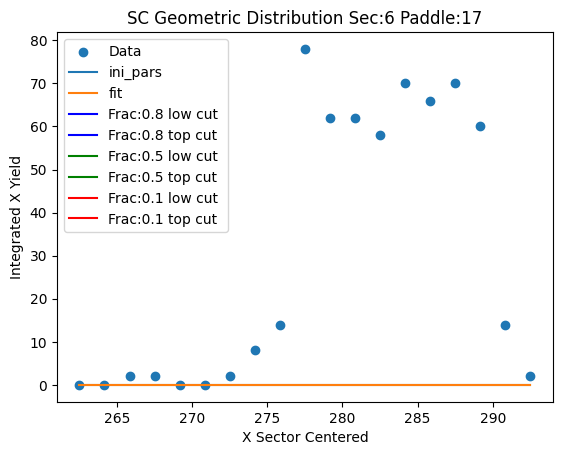

Parameters for Sec:6 Paddle:18
test pars [ 1.12829511e+02 -2.24533111e+03  1.68151150e+04 -1.15194145e+06]
fit pars [ 1.12829511e+02 -2.24533111e+03  1.68151150e+04 -1.15194145e+06]


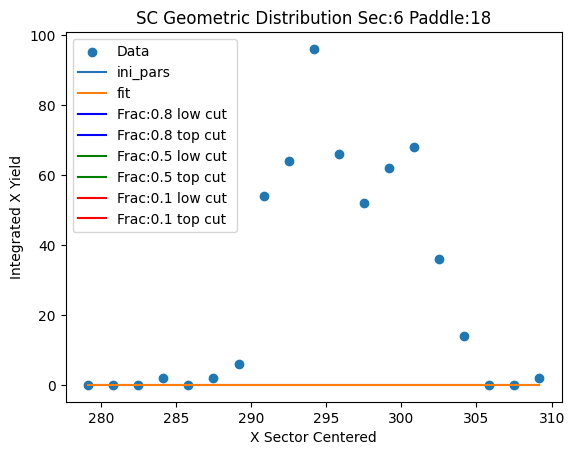

Parameters for Sec:6 Paddle:19
test pars [ 1.12829511e+02 -2.23133111e+03  1.68176150e+04 -1.15194145e+06]
fit pars [ 1.12829511e+02 -2.23133111e+03  1.68176150e+04 -1.15194145e+06]


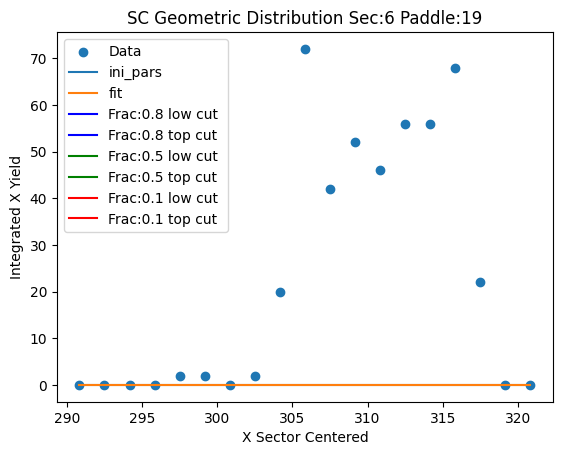

Parameters for Sec:6 Paddle:20
test pars [ 1.12829511e+02 -2.21733111e+03  1.68201150e+04 -1.15194145e+06]
fit pars [ 1.12829511e+02 -2.21733111e+03  1.68201150e+04 -1.15194145e+06]


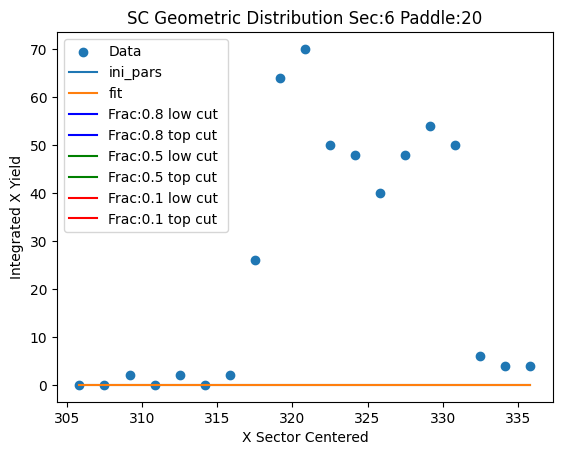

Parameters for Sec:6 Paddle:21
test pars [ 1.12829511e+02 -2.20333111e+03  1.68226150e+04 -1.15194145e+06]
fit pars [ 1.12829511e+02 -2.20333111e+03  1.68226150e+04 -1.15194145e+06]


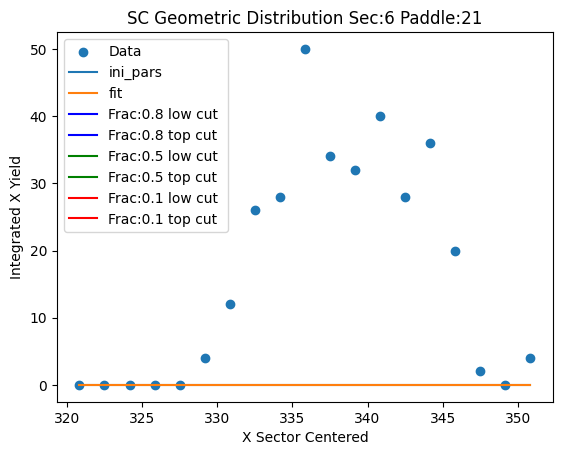

Parameters for Sec:6 Paddle:22
test pars [ 1.12829511e+02 -2.18933111e+03  1.68251150e+04 -1.15194145e+06]
fit pars [ 1.12829511e+02 -2.18933111e+03  1.68251150e+04 -1.15194145e+06]


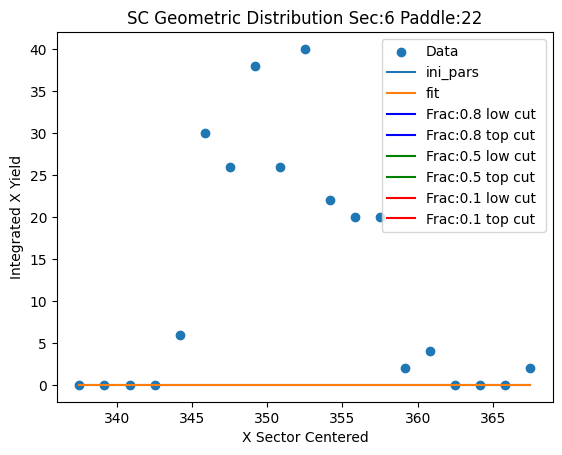

Parameters for Sec:6 Paddle:23
test pars [ 1.12829511e+02 -2.17533111e+03  1.68276150e+04 -1.15194145e+06]
fit pars [ 1.12829511e+02 -2.17533111e+03  1.68276150e+04 -1.15194145e+06]


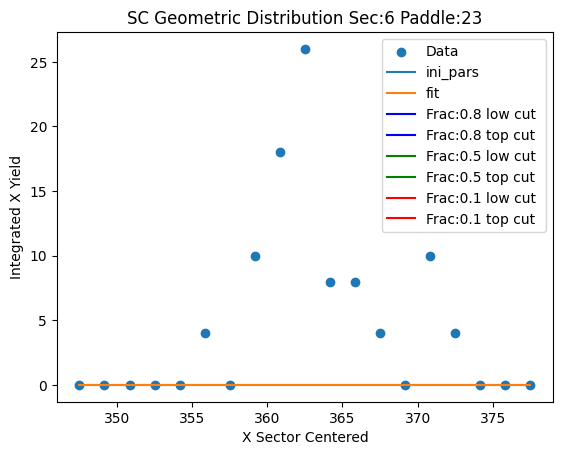

Parameters for Sec:6 Paddle:24
test pars [ 1.12829511e+02 -2.16133111e+03  1.68301150e+04 -1.15194145e+06]
fit pars [ 1.12829511e+02 -2.16133111e+03  1.68301150e+04 -1.15194145e+06]


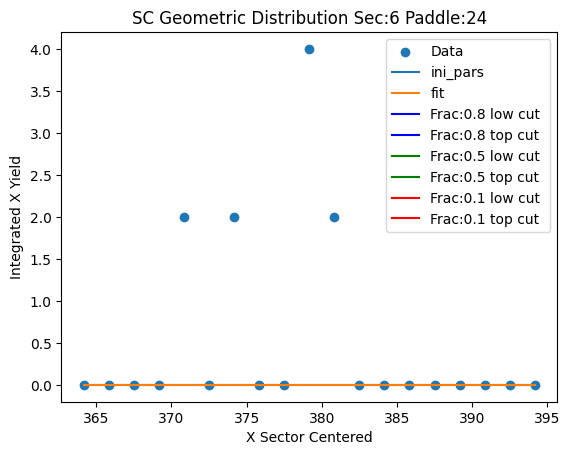

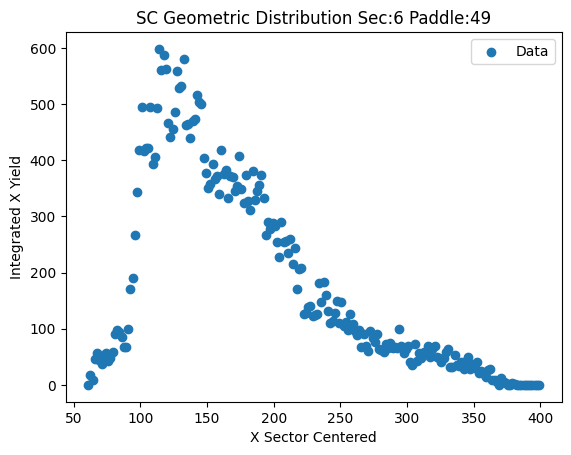

Parameters for Sec:7 Paddle:2
test pars [250.   75.    5.4   4. ]
fit pars [688.75000374  76.63289273   5.30122062  70.45426152]


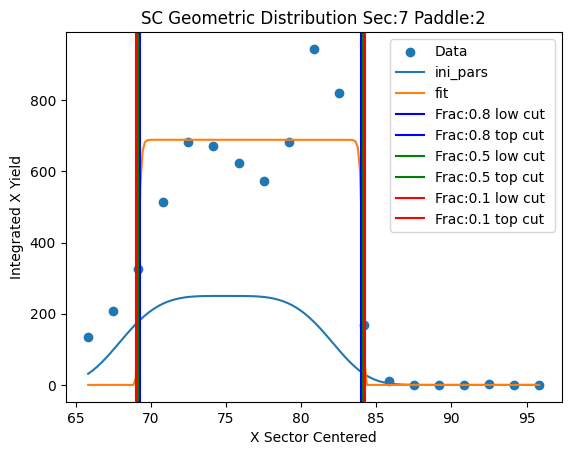

Parameters for Sec:7 Paddle:3
test pars [688.75000374  90.63289273   7.80122062  70.45426152]
fit pars [1205.00000065   90.02397263    5.3090272    78.65702968]


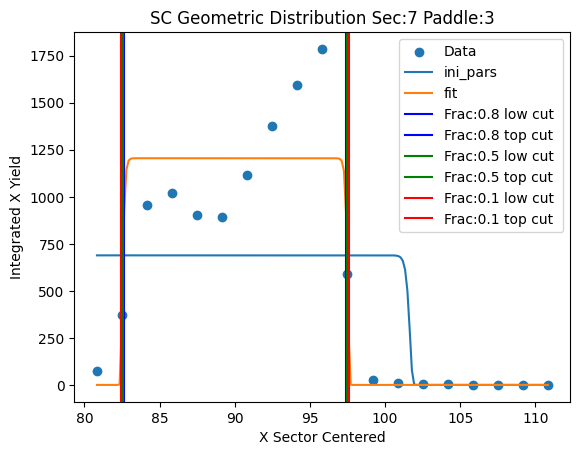

Parameters for Sec:7 Paddle:4
test pars [1205.00000065  104.02397263    7.8090272    78.65702968]
fit pars [2774.94362896  104.15159969    5.03584255    6.64181266]


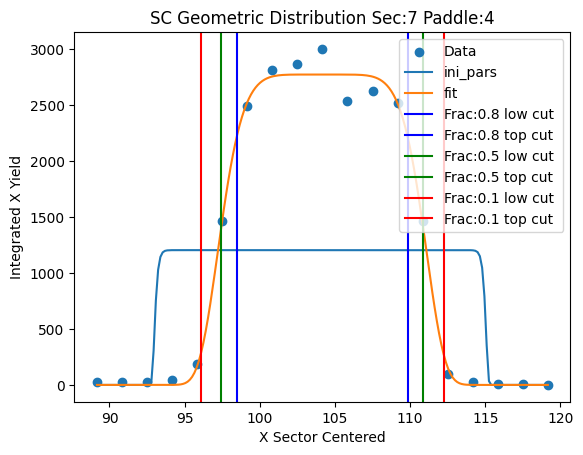

Parameters for Sec:7 Paddle:5
test pars [2774.94362896  118.15159969    7.53584255    6.64181266]
fit pars [3295.50062432  117.61175932    4.95673528    5.73307315]


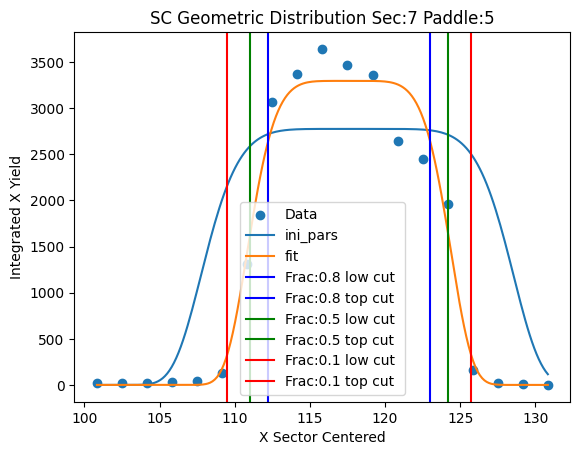

Parameters for Sec:7 Paddle:6
test pars [3295.50062432  131.61175932    7.45673528    5.73307315]
fit pars [2890.41535909  131.56676529    4.98859522    8.57613175]


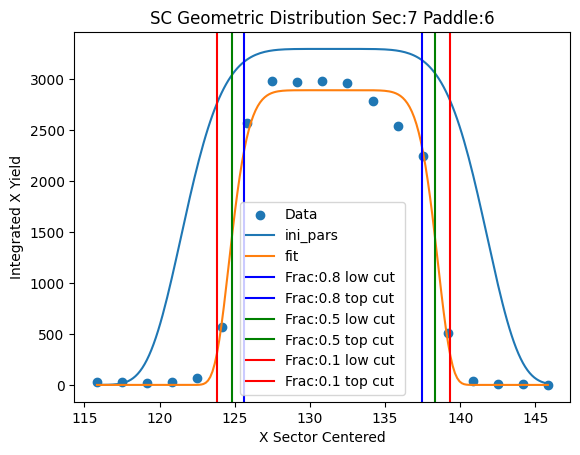

Parameters for Sec:7 Paddle:7
test pars [2890.41535909  145.56676529    7.48859522    8.57613175]
fit pars [2568.71809447  145.2859826     5.00016936    8.17949053]


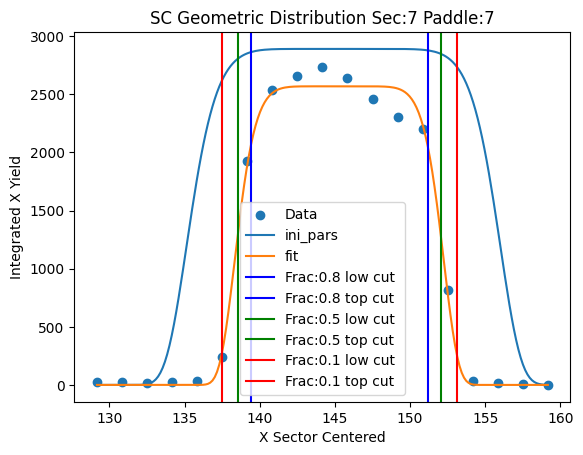

Parameters for Sec:7 Paddle:8
test pars [2568.71809447  159.2859826     7.50016936    8.17949053]
fit pars [2334.92155943  159.07818607    5.07764478    7.35562499]


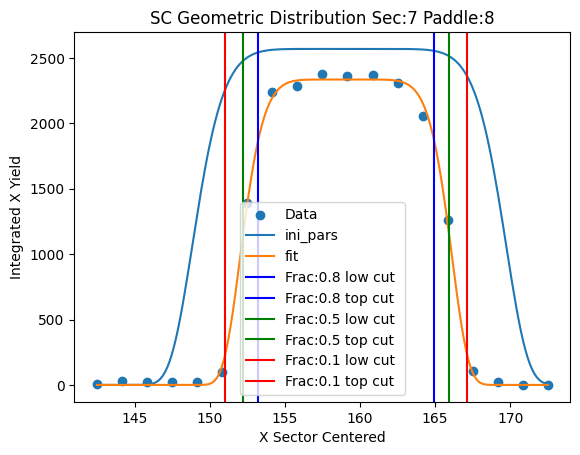

Parameters for Sec:7 Paddle:9
test pars [2334.92155943  173.07818607    7.57764478    7.35562499]
fit pars [2092.81707996  173.01818631    5.09764631   10.14364673]


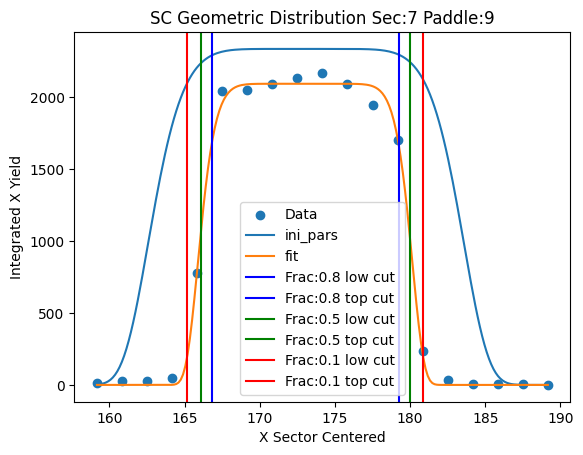

Parameters for Sec:7 Paddle:10
test pars [2092.81707996  187.01818631    7.59764631   10.14364673]
fit pars [1930.71404917  186.71935323    5.07897466   11.47401123]


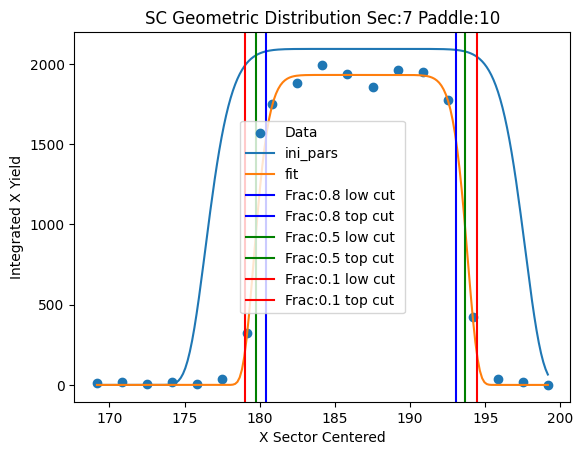

Parameters for Sec:7 Paddle:11
test pars [1930.71404917  200.71935323    7.57897466   11.47401123]
fit pars [1584.49587322  200.49145815    5.14393484   10.34472394]


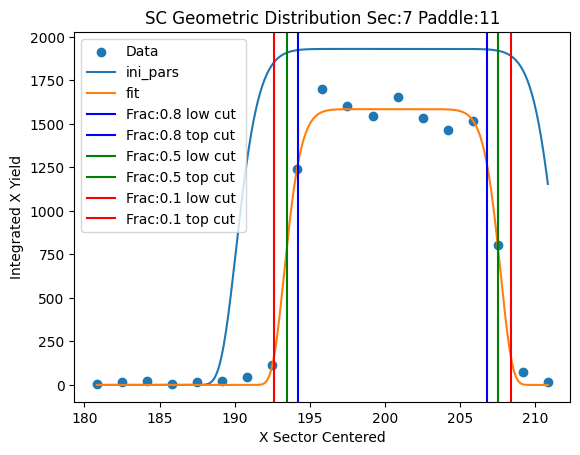

Parameters for Sec:7 Paddle:12
test pars [1584.49587322  214.49145815    7.64393484   10.34472394]
fit pars [1349.0570322   214.266281      5.05943044    7.20128788]


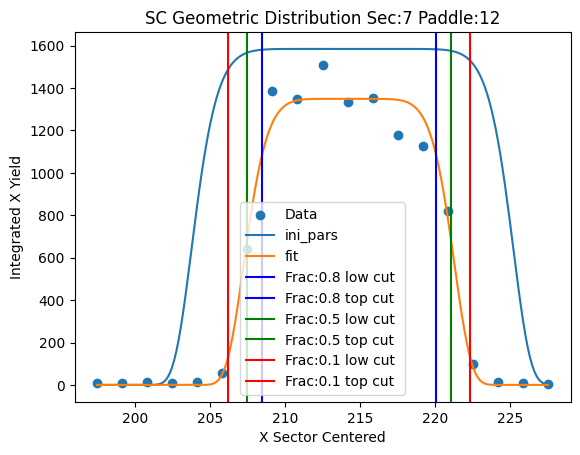

Parameters for Sec:7 Paddle:13
test pars [1349.0570322   228.266281      7.55943044    7.20128788]
fit pars [1015.08972841  228.15153025    5.11093015    9.67959456]


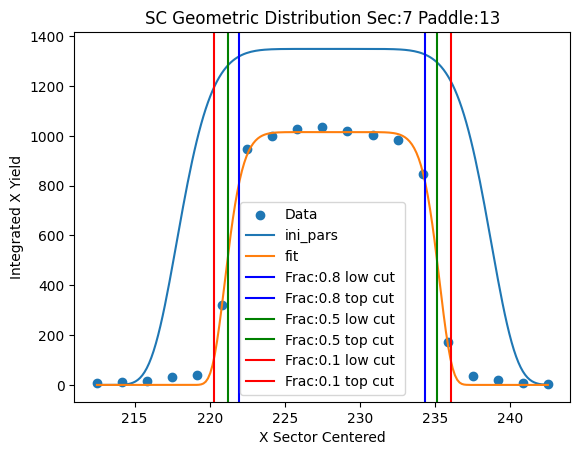

Parameters for Sec:7 Paddle:14
test pars [1015.08972841  242.15153025    7.61093015    9.67959456]
fit pars [903.82239478 241.82905169   5.13617031  12.41715966]


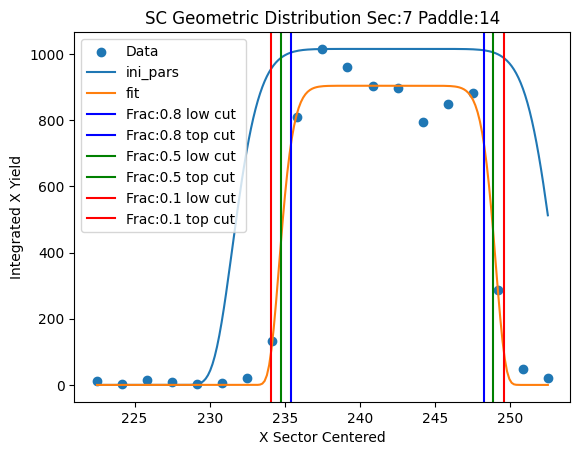

Parameters for Sec:7 Paddle:15
test pars [903.82239478 255.82905169   7.63617031  12.41715966]
fit pars [756.51792646 255.74542666   5.24567668   8.37197928]


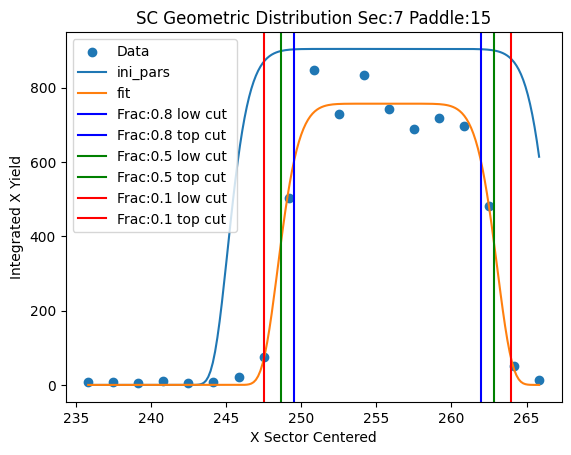

Parameters for Sec:7 Paddle:16
test pars [756.51792646 269.74542666   7.74567668   8.37197928]
fit pars [644.35174904 269.58602071   5.20082942   8.32773187]


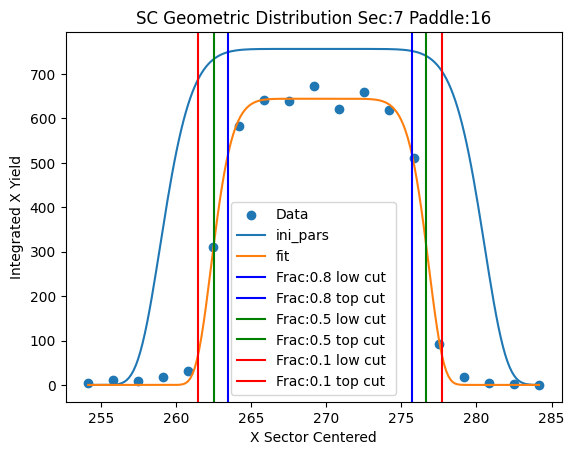

Parameters for Sec:7 Paddle:17
test pars [644.35174904 283.58602071   7.70082942   8.32773187]
fit pars [526.21122652 283.30072979   5.18934847  13.23384329]


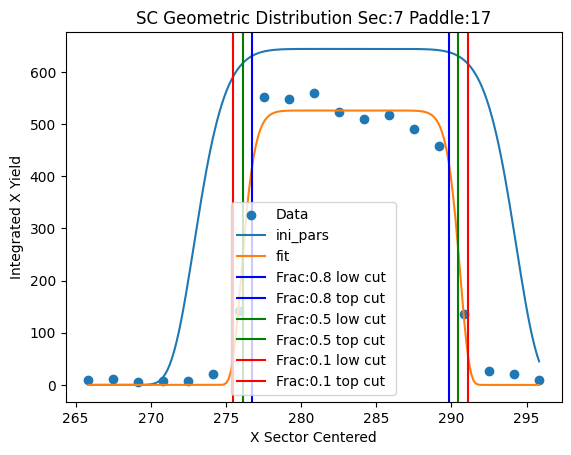

Parameters for Sec:7 Paddle:18
test pars [526.21122652 297.30072979   7.68934847  13.23384329]
fit pars [466.93345336 296.98374859   5.10547154   7.6919307 ]


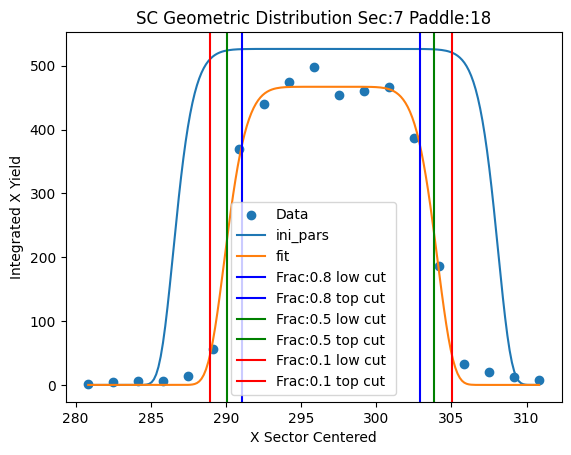

Parameters for Sec:7 Paddle:19
test pars [466.93345336 310.98374859   7.60547154   7.6919307 ]
fit pars [390.81046888 310.61301934   5.06518212   8.21999828]


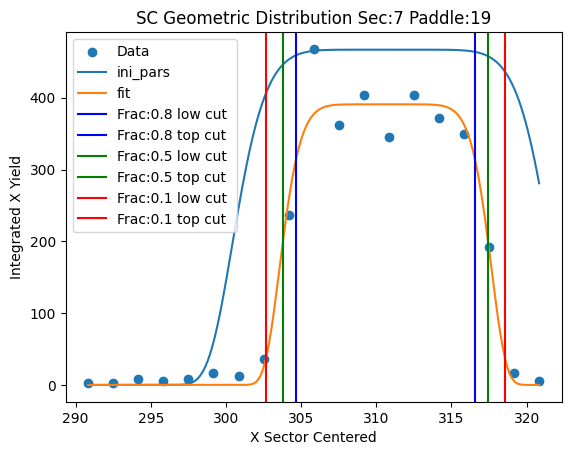

Parameters for Sec:7 Paddle:20
test pars [390.81046888 324.61301934   7.56518212   8.21999828]
fit pars [354.49458134 324.70124737   5.14665156  10.24558834]


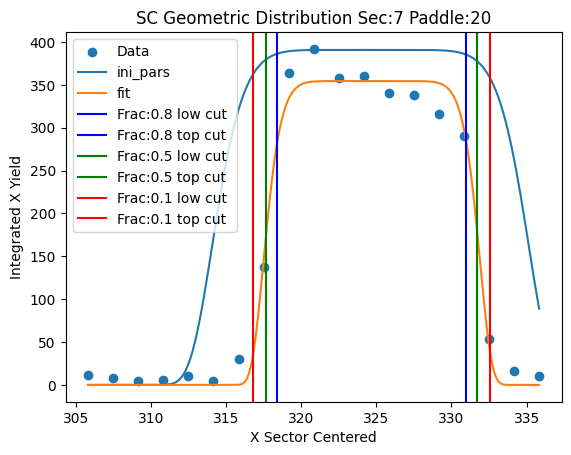

Parameters for Sec:7 Paddle:21
test pars [354.49458134 338.70124737   7.64665156  10.24558834]
fit pars [282.77445846 338.52722216   5.22561366   8.0869104 ]


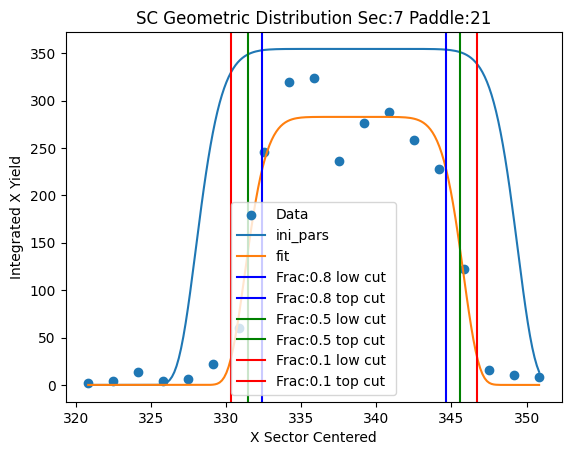

Parameters for Sec:7 Paddle:22
test pars [282.77445846 352.52722216   7.72561366   8.0869104 ]
fit pars [235.72679154 351.70724794   5.09267862   5.79968248]


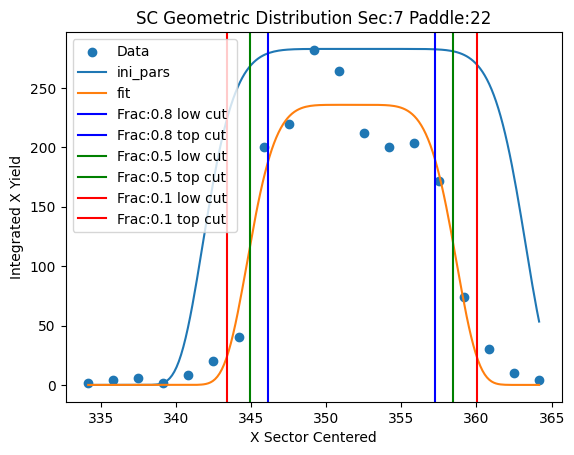

Parameters for Sec:7 Paddle:23
test pars [235.72679154 365.70724794   7.59267862   5.79968248]
fit pars [177.27978806 361.42540332   2.21634692   0.94364367]


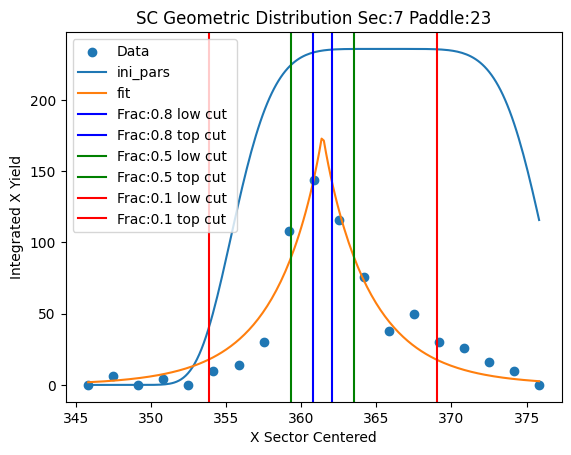

Parameters for Sec:7 Paddle:24
test pars [177.27978806 375.42540332   4.71634692   0.94364367]
fit pars [1.00393880e+02 3.74518542e+02 8.87904992e-02 3.11261039e-01]


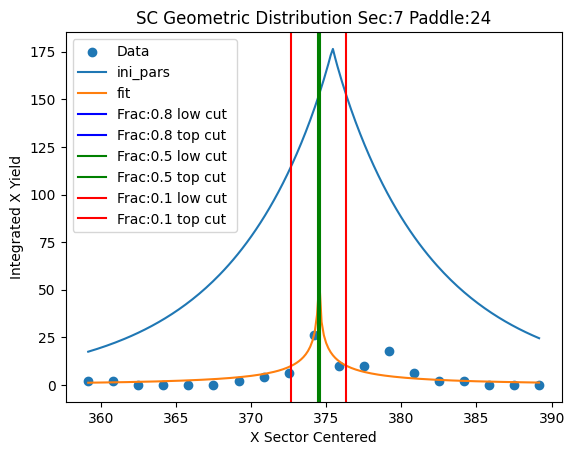

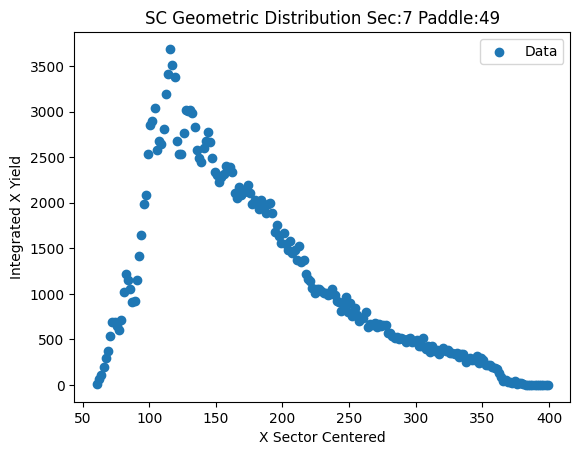

In [22]:
cut_lines = np.zeros((7,cut_hist_len,3,2))

low = 0.0
high = 0.0
space = 15

#Super_Gaus(x,a_,m_,s_,p_)


fit_pars = np.zeros((7,cut_hist_len,4))

ini_par = [250.0,75.0,5.4,4.0]

test_pars = np.zeros(4)

frac_cut = [0.8,0.5,0.1]

paddle_expand = 19


for sec in range(7):
    for i in range(4):
        test_pars[i] = ini_par[i]
    for hist_idx in range(cut_hist_len):
        if(Count_Non_Zero(proj_y[sec][hist_idx]) >= 6):
            if hist_idx == num_sc_pad:
                low = 60.
                high = 400.
            else:
                low = yvals[np.argmax(proj_y[sec][hist_idx])] - space
                high = yvals[np.argmax(proj_y[sec][hist_idx])] + space
            new_yvals = Bounds_on_Y(yvals,low,high)
            new_zvals = Bounds_on_X_From_Y(proj_y[sec][hist_idx],yvals,low,high)
            plt.scatter(new_yvals,new_zvals,label="Data")
            if hist_idx < num_sc_pad:
                try: 
                    pars, pars_cov = op.curve_fit(Super_Gaus,new_yvals,new_zvals,p0=test_pars,maxfev=5000)
                    print("Parameters for Sec:{} Paddle:{}".format(sec+1,hist_idx+1))
                    print("test pars",test_pars)
                    print("fit pars",pars)
                    cont_x = np.linspace(new_yvals[0],new_yvals[len(new_yvals)-1],200)
                    plt.plot(cont_x,Super_Gaus(cont_x,*test_pars),label="ini_pars")
                    plt.plot(cont_x,Super_Gaus(cont_x,*pars),label="fit")

                    for j in range(4):
                        test_pars[j] = pars[j]
                        if j == 1:
                            test_pars[j]+=14
                        if j == 2:
                            test_pars[j]+=2.5
                        fit_pars[sec][hist_idx][j] = pars[j]
                    #if hist_idx == paddle_expand:
                    #    test_pars[2]+=3
                    for k in range(3):
                        cut_lines[sec][hist_idx][k][0] = super_gaus_cut_bound(frac_cut[k],0,*pars)
                        cut_lines[sec][hist_idx][k][1] = super_gaus_cut_bound(frac_cut[k],1,*pars)
                        plt.axvline(x=cut_lines[sec][hist_idx][k][0],color=color_order[k],label="Frac:{} low cut ".format(frac_cut[k]))
                        plt.axvline(x=cut_lines[sec][hist_idx][k][1],color=color_order[k],label="Frac:{} top cut ".format(frac_cut[k]))
                except RuntimeError:
                    print("Runtime Error")
                except ValueError:
                    print("Value Error")
            plt.title("SC Geometric Distribution Sec:{} Paddle:{}".format(sec+1,hist_idx+1))
            plt.ylabel("Integrated X Yield")
            plt.xlabel("X Sector Centered")
            plt.legend()
            plt.show()



[[[80.04020775188417, 1.7320508075688772], [71.39693361048138, 1.7320508075688772], [63.83406873675395, 1.7320508075688772]], [[83.15036754596869, 1.7320508075688772], [73.96010354143223, 1.7320508075688772], [65.91862253746284, 1.7320508075688772]], [[88.31163411841506, 1.7320508075688772], [76.37823889331789, 1.7320508075688772], [65.93651807135785, 1.7320508075688772]], [[82.15371059875893, 1.7320508075688772], [73.70230646488893, 1.7320508075688772], [66.30732784775269, 1.7320508075688772]], [[88.98019238699176, 1.7320508075688772], [77.21947900857691, 1.7320508075688772], [66.92885480246392, 1.7320508075688772]], [[93.9222092892844, 1.7320508075688772], [80.12126229136042, 1.7320508075688772], [68.04543366817693, 1.7320508075688772]], [[85.90854068084931, 1.7320508075688772], [75.57822652146511, 1.7320508075688772], [66.53920163200392, 1.7320508075688772]]]
[[80.04020775188417, 1.7320508075688772], [71.39693361048138, 1.7320508075688772], [63.83406873675395, 1.7320508075688772]]


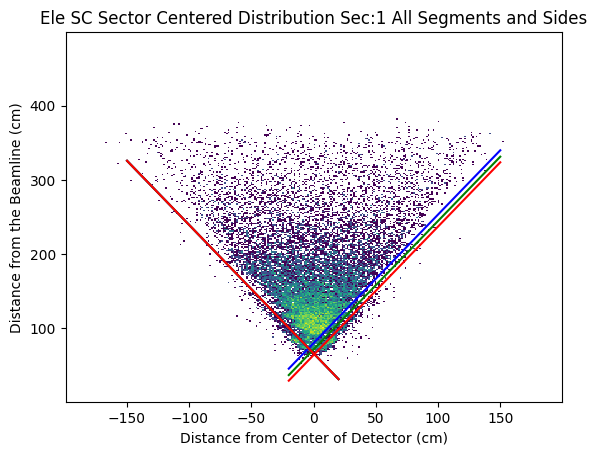

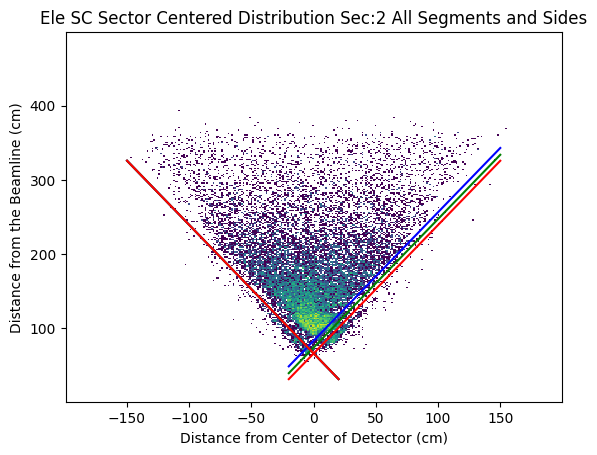

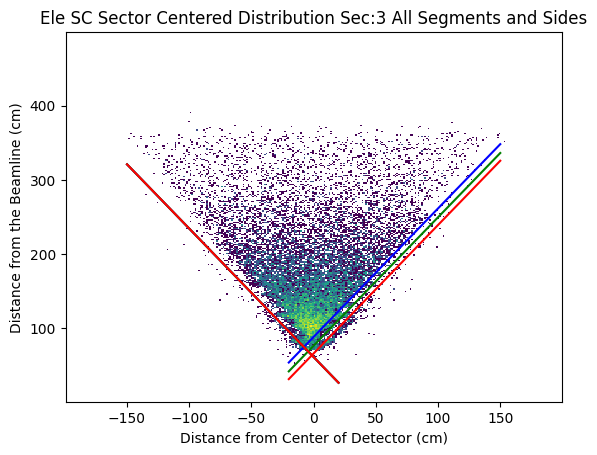

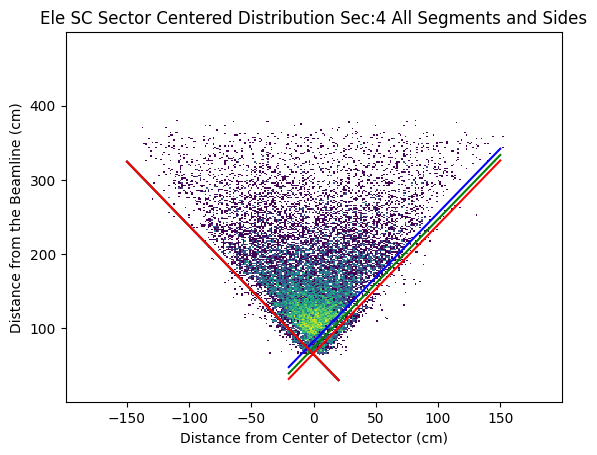

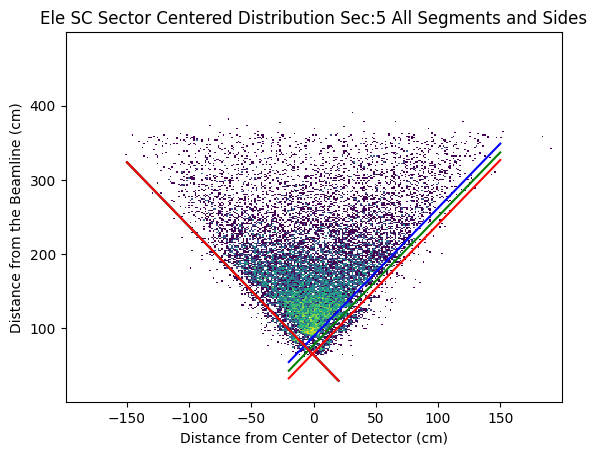

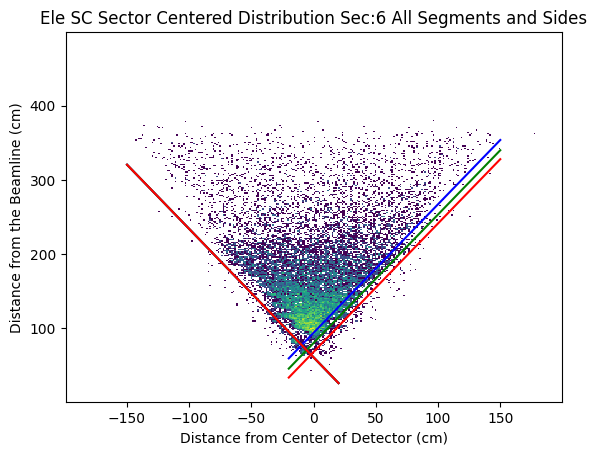

In [23]:
right_cut_pars = [[[-right_edge[sec][cut_idx]*right_rot[sec],right_rot[sec]] for cut_idx in range(3)] for sec in range(7)]
left_cut_pars = [[[left_edge[sec][cut_idx]*left_rot[sec],-left_rot[sec]] for cut_idx in range(3)] for sec in range(7)]

#side_cut_pars = [[[-right_edge[sec][cut_idx1]*3**(1/2),3**(1/2)] for cut_idx1 in range(3)],[[left_edge[sec][cut_idx2]*3**(1/2),-(3**(1/2))] for cut_idx2 in range(3)] for sec in range(7)]

print(right_cut_pars)
print(right_cut_pars[0])

cont_x_r = np.linspace(-20.0,150.,200)
cont_x_l = np.linspace(-150.0,20.,200)

for sec in range(6):
    plt.hist2d(dumb1_x[sec][cut_hist_len-1], dumb1_y[sec][cut_hist_len-1], bins=(xdim, ydim), weights=dense1[sec][cut_hist_len-1],norm = mpl.colors.LogNorm())
    for cut in range(3):
        plt.plot(cont_x_r,Poly(cont_x_r,right_cut_pars[sec][cut]),label=cut_name[cut],color=color_order[cut])
        plt.plot(cont_x_l,Poly(cont_x_l,left_cut_pars[sec][cut]),color=color_order[cut])
    plt.title("Ele SC Sector Centered Distribution Sec:{} All Segments and Sides".format(sec+1))
    plt.xlabel("Distance from Center of Detector (cm)")
    plt.ylabel("Distance from the Beamline (cm)")
    plt.show()

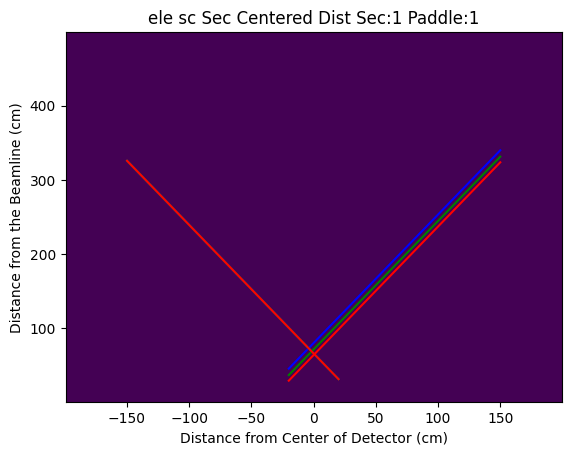

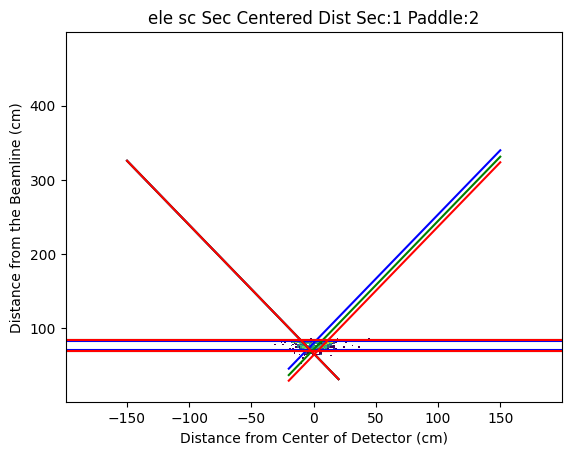

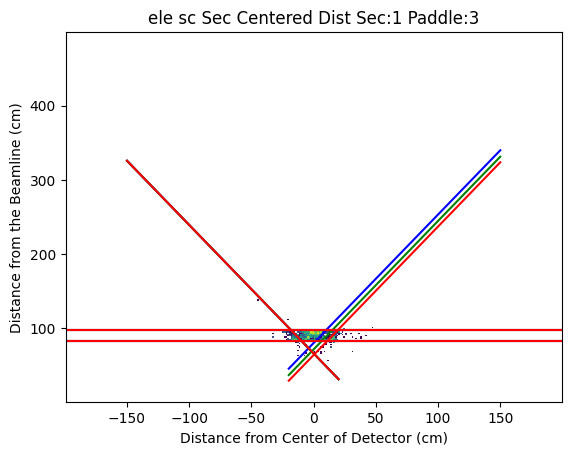

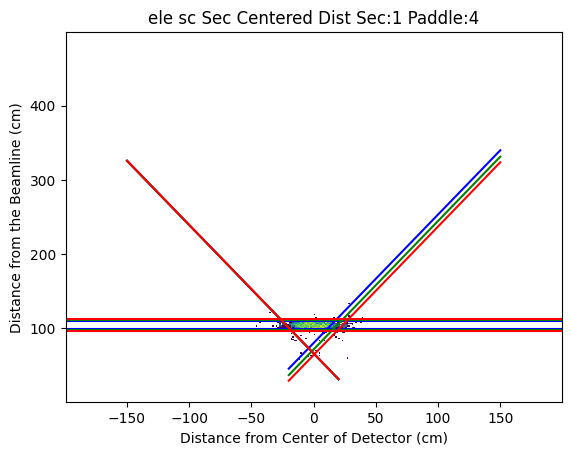

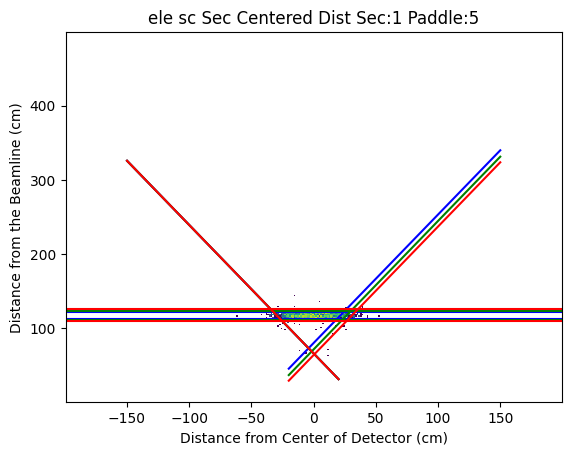

...

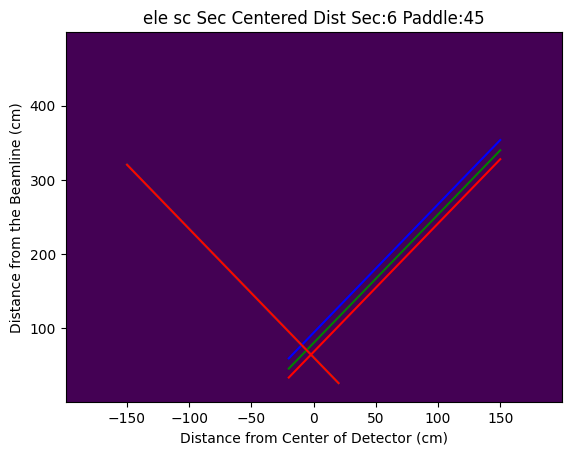

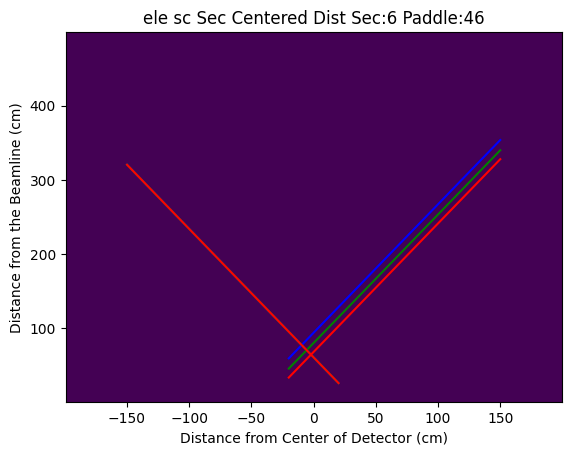

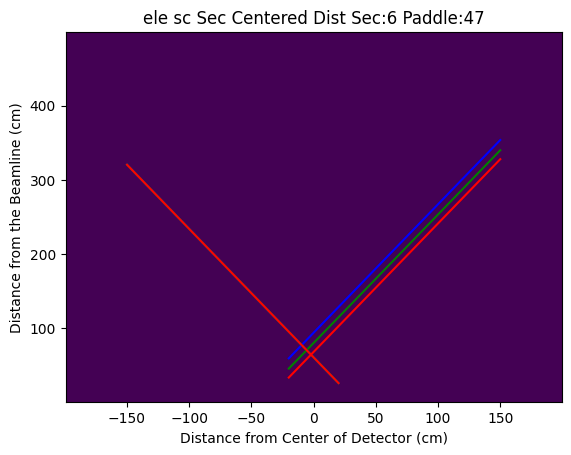

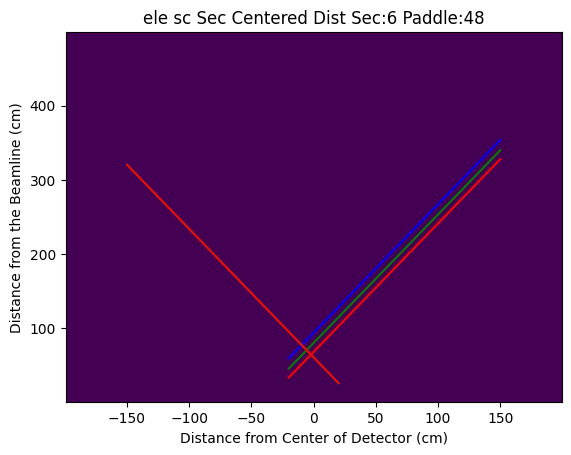

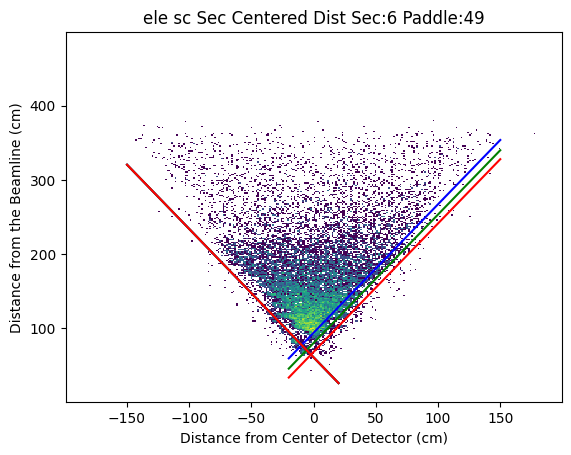

In [24]:
for sec in range(6):
    for hist_idx in range(cut_hist_len):
        plt.hist2d(dumb1_x[sec][hist_idx], dumb1_y[sec][hist_idx], bins=(xdim, ydim), weights=dense1[sec][hist_idx],norm = mpl.colors.LogNorm())
        
        for cut in range(3):
            plt.plot(cont_x_r,Poly(cont_x_r,right_cut_pars[sec][cut]),label=cut_name[cut],color=color_order[cut])
            plt.plot(cont_x_l,Poly(cont_x_l,left_cut_pars[sec][cut]),color=color_order[cut])
            if cut_lines[sec][hist_idx][cut][0] > 0.0:
                plt.axhline(y=cut_lines[sec][hist_idx][cut][0],color=color_order[cut])
                plt.axhline(y=cut_lines[sec][hist_idx][cut][1],color=color_order[cut])
        plt.title(species+" "+detector+" Sec Centered Dist Sec:{} Paddle:{}".format(sec+1,hist_idx+1))
        plt.xlabel("Distance from Center of Detector (cm)")
        plt.ylabel("Distance from the Beamline (cm)")
        plt.show()

In [25]:
print("Cut Parameters for "+species+" SC Geometric Cut")
print("cut_par[paddle][sec][{tight,mid,loose}][{bot,top}]")
for pad in range(num_sc_pad):
    for sec in range(6):
        for cut in range(3):
            if math.isinf(cut_lines[sec][pad][cut][0]):
                cut_lines[sec][pad][cut][0] = 0.0
                cut_lines[sec][pad][cut][1] = 0.0
            if cut ==0:
                if sec == 0:
                    if pad==0:
                        print("{\t{\t{\t{",cut_lines[sec][pad][cut][0],",",cut_lines[sec][pad][cut][1],end="},")
                    else:
                        print("\t{\t{\t{",cut_lines[sec][pad][cut][0],",",cut_lines[sec][pad][cut][1],end="},")
                else:
                    print("\t\t{\t{",cut_lines[sec][pad][cut][0],",",cut_lines[sec][pad][cut][1],end="},")
            elif cut == 2:
                if sec == 5:
                    if pad == num_sc_pad-1:
                        print("{",cut_lines[sec][pad][cut][0],",",cut_lines[sec][pad][cut][1],"}}}}")
                    else:
                        print("{",cut_lines[sec][pad][cut][0],",",cut_lines[sec][pad][cut][1],"}}},")
                else:
                    print("{",cut_lines[sec][pad][cut][0],",",cut_lines[sec][pad][cut][1],"}},")
            else:
                print("{",cut_lines[sec][pad][cut][0],",",cut_lines[sec][pad][cut][1],end="},")
        

Cut Parameters for ele SC Geometric Cut
cut_par[paddle][sec][{tight,mid,loose}][{bot,top}]
{	{	{	{ 0.0 , 0.0},{ 0.0 , 0.0},{ 0.0 , 0.0 }},
		{	{ 0.0 , 0.0},{ 0.0 , 0.0},{ 0.0 , 0.0 }},
		{	{ 0.0 , 0.0},{ 0.0 , 0.0},{ 0.0 , 0.0 }},
		{	{ 0.0 , 0.0},{ 0.0 , 0.0},{ 0.0 , 0.0 }},
		{	{ 0.0 , 0.0},{ 0.0 , 0.0},{ 0.0 , 0.0 }},
		{	{ 0.0 , 0.0},{ 0.0 , 0.0},{ 0.0 , 0.0 }}},
	{	{	{ 70.58644930103826 , 82.65440680001377},{ 69.70147915060564 , 83.5393769504464},{ 68.62215695998887 , 84.61869914106316 }},
		{	{ 69.24205607382223 , 84.01741476357137},{ 69.15459204017503 , 84.10487879721856},{ 69.06081907733119 , 84.1986517600624 }},
		{	{ 70.88974343293991 , 84.00985354880153},{ 70.7734122760429 , 84.12618470569853},{ 70.64794174866478 , 84.25165523307666 }},
		{	{ 68.57882667933411 , 82.51586477363979},{ 67.26328706535251 , 83.83140438762139},{ 65.59803018674164 , 85.49666126623227 }},
		{	{ 69.24348964904816 , 83.2672133537276},{ 68.17922545411385 , 84.33147754866191},{ 66.87526235511932 , 85.63

In [26]:
print("Cut Parameters for "+species+" EC Geometric Cut")
print("side_cut_par[sec][{tight,mid,loose}][right,left][intercept,slope]")

for sec in range(6):
    for cut in range(3):
        if cut == 0:
            if sec ==0:
                print("{\t{\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}},")
            else:
                print("\t{\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}},")
        elif cut == 2:
            if sec==5:
                print("\t\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}}}}")
            else:
                print("\t\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}}},")
        else:
            print("\t\t{\t{",right_cut_pars[sec][cut][0],",",right_cut_pars[sec][cut][1],"},{",left_cut_pars[sec][cut][0],",",left_cut_pars[sec][cut][1],"}},")
        
        
        

Cut Parameters for ele EC Geometric Cut
side_cut_par[sec][{tight,mid,loose}][right,left][intercept,slope]
{	{	{	{ 80.04020775188417 , 1.7320508075688772 },{ 65.8983321586237 , -1.7320508075688772 }},
		{	{ 71.39693361048138 , 1.7320508075688772 },{ 65.8983321586237 , -1.7320508075688772 }},
		{	{ 63.83406873675395 , 1.7320508075688772 },{ 65.8983321586237 , -1.7320508075688772 }}},
	{	{	{ 83.15036754596869 , 1.7320508075688772 },{ 65.98843099030186 , -1.7320508075688772 }},
		{	{ 73.96010354143223 , 1.7320508075688772 },{ 65.98843099030186 , -1.7320508075688772 }},
		{	{ 65.91862253746284 , 1.7320508075688772 },{ 65.98843099030186 , -1.7320508075688772 }}},
	{	{	{ 88.31163411841506 , 1.7320508075688772 },{ 61.080443917471435 , -1.7320508075688772 }},
		{	{ 76.37823889331789 , 1.7320508075688772 },{ 61.080443917471435 , -1.7320508075688772 }},
		{	{ 65.93651807135785 , 1.7320508075688772 },{ 61.080443917471435 , -1.7320508075688772 }}},
	{	{	{ 82.15371059875893 , 1.7320508075688772 },{ 